In [1]:
%run "000_shared.ipynb"

# Prorocessing Steps
1. Equalize << TODO: Choose method based on imaging modality traits 
    - CLAHE: too harsh
    - Contrast stretching: seems fine 

2. Pull out color channels <<TODO: explore for relevance of each. 
    - Green: has details. Better than gray 
    - Red: has intensities = r>threshold. Filter for pth percentile --> ?thin layer, hottest??<< TODO: yellow pigmentation goes where 
    - Blue: seems to carry texture information but still not sure = b==1. The pixels seem to be fully turned on. 
    - Output new map of these channels
    - Metrics: proption of red mask and blue mask pixels and findng some pattern/thresh, blobs counts??

3. Pull out veins mask 
    - Frangi vesselness should do. 
    - Output += veins mask
    - Metrics: proportion of veins --> cataracts OR DR,AMD,MA,HM 



In [2]:
## TODO: generalize 
import glob, os 
# from skimage import filters, io
# io.use_plugin('freeimage')

import pickle 

class Preprocessor:
    dir_output = "output"
    dir_feature_maps = "fmaps"
    dir_progress_maps = "progress"
    fmap_ext = ".fmap"
    
    def __init__(self):
        dz = [self.dir_output, 
              f"{self.dir_output}/{self.dir_feature_maps}", 
              f"{self.dir_output}/{self.dir_progress_maps}"]
        ## TODO: pathlib 
        for d in dz:
            if not os.path.exists(d):
                os.makedirs(d)
    
    ## Pipeline = folder --> subsets --> file --> AnImage --> eq --> colormaps --> vessels --> save --> plot/report     
    def load_stare_fundus_dir(self, 
                              fdir="../../data/stare_fundus", ext='ppm',
                              dcodes_txt="disease_codes.txt",
                              data_labelz_txt="all-mg-codes.txt"):
        self.fdir = fdir         
        self.dataset = sorted(glob.glob( f"{self.fdir}/*.{ext}") )
        
        def load_txt(fname, outds):
            with open(f"{self.fdir}/{fname}", 'r') as fd:
                for f in fd.readlines():
                    rec = f.split("\t") 
                    #print(rec[0], ": ", [x.strip() for x in rec[1:] if len(x) > 0])
                    outds[rec[0]] = [x.strip() for x in rec[1:] if len(x) > 0]

        
        self.disease_codez = {}        
        self.data_labelz = {}
        load_txt( dcodes_txt, self.disease_codez) 
        load_txt( data_labelz_txt, self.data_labelz) 
        
    @property
    def dataset_size(self):
        return len(self.dataset)
    
    
    def run_pipeline(self, n=None):
        for i, ipath in enumerate(self.dataset):
            try:
                fname = os.path.splitext( os.path.basename(ipath) )[0]
                fout = f"{self.dir_output}/{self.dir_feature_maps}/{fname}{self.fmap_ext}"
                fprog = f"{self.dir_output}/{self.dir_progress_maps}"

                print(f"{i}: Starting on {fname}", end=", ")
                # 1. get image from file 
                outsiez_prog = []
                anImg = AnImage(ipath)             
                # 2. equalize 
                anImg.image = self.equalize_image(anImg.image) 
                print(f"equalized", end=", ")
                # 3. vessels map << run on green Vs gray
                outsiez_prog.append( self.vessels_map_image(anImg.green))  
                print(f"vessels mapped", end=", ")
                # 4. color maps: green-details, red-intensity, blue-texture
                outsiez_prog.append( self.green_channel_update(anImg.green) )
                outsiez_prog.append( self.red_channel_update(anImg.red) )
                outsiez_prog.append( self.blue_channel_update(anImg.blue) )
                print(f"colors mapped", end=", ") 
                # 5. combine and save << combine color maps separately first 
                outiez = self.combine_channelz(list(outsiez_prog[1:]))
                outsiez_prog.append( outiez) #outiez[:,:,1:])         
                #outiez = self.combine_channelz(list(outsiez_prog))    
                #skimage.io.imsave(fout, outiez)
                #self.save_fmap(fout, outiez)
                self.save_fmap(fout, outsiez_prog)
                print(f"combined and saved", end=", ")

                # 6. save progress imagez 
                def get_disease_code(fn):
                    lbz = self.data_labelz[fn][0].split(" ")
                    dlbl = []
                    for l in lbz:
                        d = self.disease_codez.get(l, None)
                        if d:
                            dlbl.append(d[1].strip())
                    return "-".join(dlbl)


                tx = ['vessels', 'green', 'red', 'blue', 'combo']
                AnImage.plot_images_list(outsiez_prog+[-im for im in outsiez_prog], 
                                         titlez=tx, 
                                         nc=len(outsiez_prog), 
                                         cmap='gray', 
                                         save=f'{fname}_{get_disease_code(fname)}',
                                         tdir=fprog,
                                         withist=False)            
                print("\n")
            except:
                pass 
            
            if (n is not None) and (i==n):
                break
    
    def save_fmap(self, fpath, fmap):
        with open(fpath, 'wb') as fd:
            pickle.dump(fmap, fd)
            
    def open_fmap(self, fpath):
        with open(fpath, 'rb') as fd:
            return pickle.load(fd)
    
    def get_image_i(self, idx):
        return AnImage( self.dataset[idx] ) 
    
    def equalize_image(self, img):
        ## == TODO: choice at img traits 
        # a. adaptive histogram equalization update
        #outsiez = exposure.equalize_adapthist(img, clip_limit=0.03)
        # b. OR contrast stretching 
        p2, p98 = np.percentile(img, (2,98))
        outsiez = skimage.exposure.rescale_intensity(img, in_range=(p2,p98))
        
        return outsiez
    
    def vessels_map_image(self, img):
        ## == TODO: tweak for performance 
        ## frangi vesselness << expects grayscale img 
        kwargs = {'sigmas': [1], 'mode': 'reflect', 'black_ridges': 0}
        outsiez = skimage.filters.frangi(img) #, **kwargs)        
        return outsiez 
    
    def green_channel_update(self, img):
        return img.copy()  
    
    def red_channel_update(self, img, thresh=0.97):
        outsiez = img.copy()
        red_range = outsiez.max() - outsiez.min()       
        outsiez[( (outsiez-outsiez.min())/red_range) < thresh] = 0      
        #outsiez = outsiez*-1        
        return outsiez        
    
    def blue_channel_update(self, img, thresh=1):
        outsiez = img.copy()
        outsiez[outsiez != 1] = 0         
        return outsiez
    
    def combine_channelz(self, cimagez):
        outsiez = np.dstack( cimagez)        
        return outsiez 
    
    
    def explorer(self, num=None,):
        fprog = f"{self.dir_output}/{self.dir_progress_maps}" ## DIR        
        
        n = self.dataset_size   
        if num is None:
            samples = range(n)
        else:      
            samples = np.random.randint(0, n, size=num)
            
        for i in samples:
            try:
                ipath = self.dataset[i]
                fname = os.path.splitext( os.path.basename(ipath) )[0]

                print(f"{i}: Starting on {fname}", end=", ")
                # 1. get image from file 
                outsiez_prog = []
                anImg = AnImage(ipath)             
                # 2. equalize 
                anImg.image = self.equalize_image(anImg.image) 
                print(f"equalized", end=", ")
                outsiez_prog.append(anImg.green)
                outsiez_prog.append(anImg.red)
                outsiez_prog.append(anImg.blue)
                outsiez_prog.append( -self.red_channel_update(anImg.red) )
                outsiez_prog.append( -self.blue_channel_update(anImg.blue) )

                ### TODO: refactor, reuse 
                # 6. save progress imagez 
                def get_disease_code(fn):
                    lbz = self.data_labelz[fn][0].split(" ")
                    dlbl = []
                    for l in lbz:
                        d = self.disease_codez.get(l, None)
                        if d:
                            dlbl.append(d[1].strip())
                    return "-".join(dlbl)


                tx = ['green', 'red', 'blue', 'r-update', 'b-update']
                AnImage.plot_images_list(outsiez_prog, #[-im for im in outsiez_prog], 
                                         titlez=tx, 
                                         nc=len(outsiez_prog), 
                                         cmap='gray', 
                                         save=f'histo_{fname}_{get_disease_code(fname)}',
                                         tdir=fprog,
                                         withist=True)            
                print("\n")
            except:
                pass 
            
        

In [3]:
stare_proc = Preprocessor()
stare_proc.load_stare_fundus_dir()

0: Starting on im0001, equalized, 

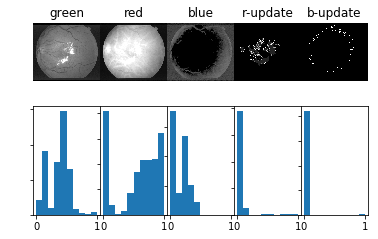



1: Starting on im0002, equalized, 

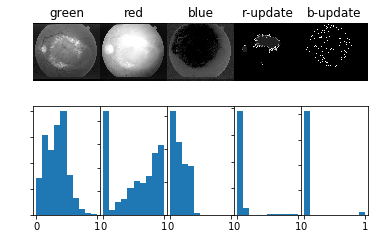



2: Starting on im0003, equalized, 

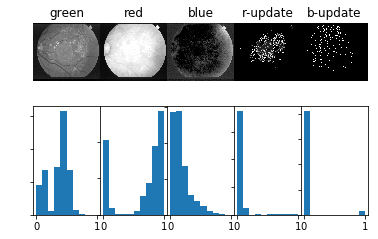



3: Starting on im0004, equalized, 

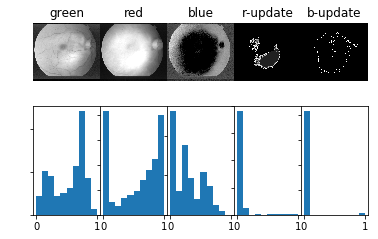



4: Starting on im0005, equalized, 

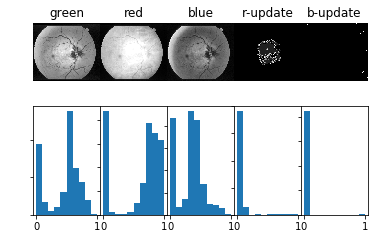



5: Starting on im0006, equalized, 

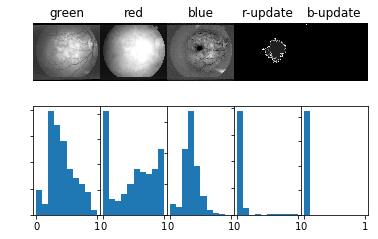



6: Starting on im0007, equalized, 

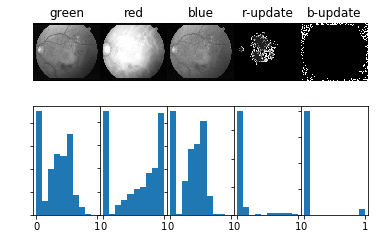



7: Starting on im0008, equalized, 

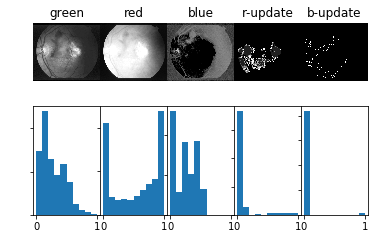



8: Starting on im0009, equalized, 

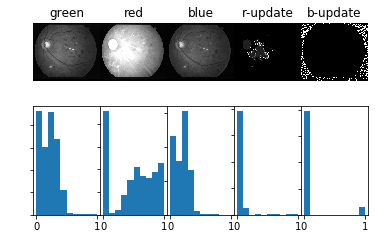



9: Starting on im0010, equalized, 

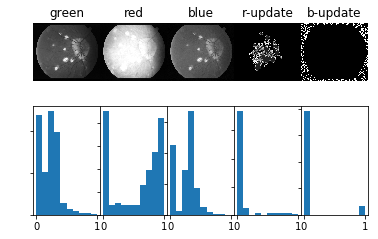



10: Starting on im0011, equalized, 

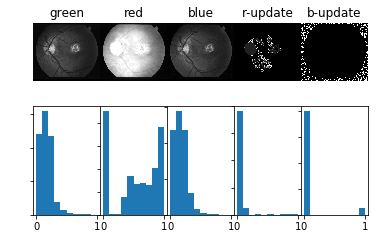



11: Starting on im0012, equalized, 

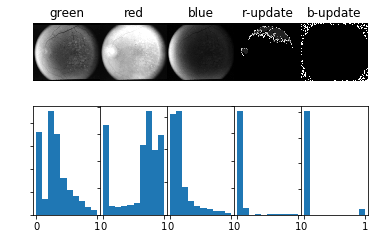



12: Starting on im0013, equalized, 

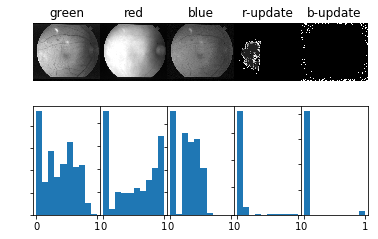



13: Starting on im0014, equalized, 

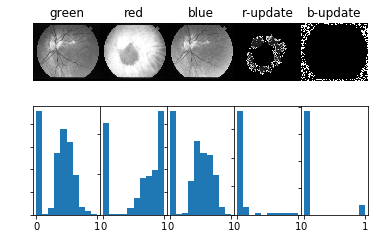



14: Starting on im0015, equalized, 

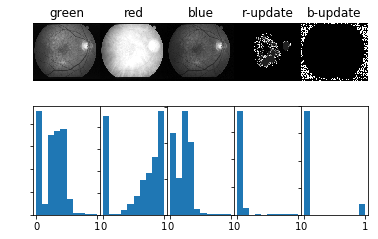



15: Starting on im0016, equalized, 

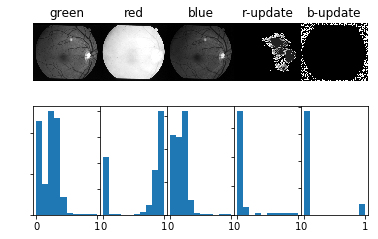



16: Starting on im0017, equalized, 

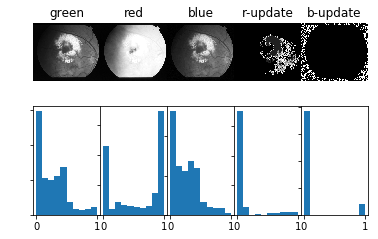



17: Starting on im0018, equalized, 

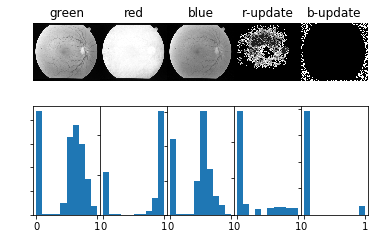



18: Starting on im0019, equalized, 

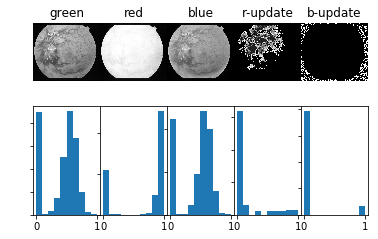



19: Starting on im0020, equalized, 

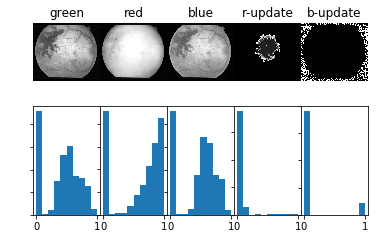



20: Starting on im0021, equalized, 

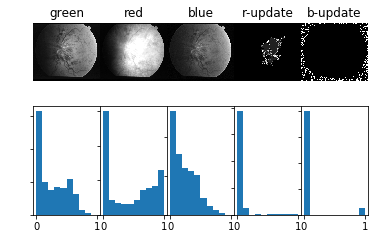



21: Starting on im0022, equalized, 

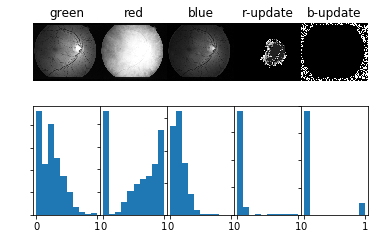



22: Starting on im0023, equalized, 

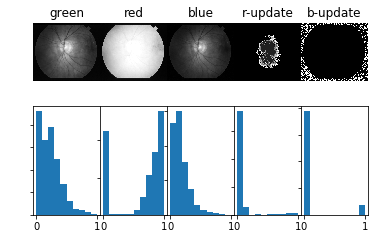



23: Starting on im0024, equalized, 

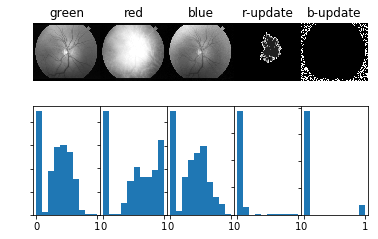



24: Starting on im0025, equalized, 

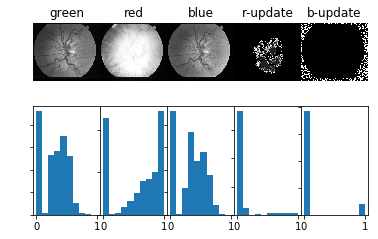



25: Starting on im0026, equalized, 

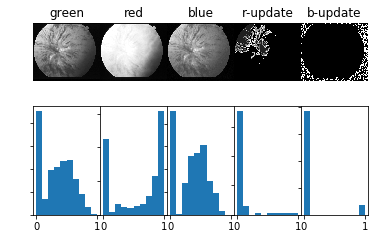



26: Starting on im0027, equalized, 

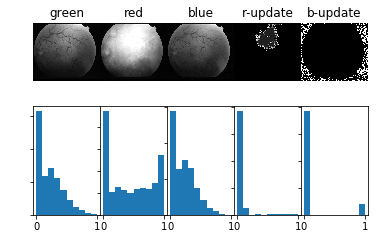



27: Starting on im0028, equalized, 

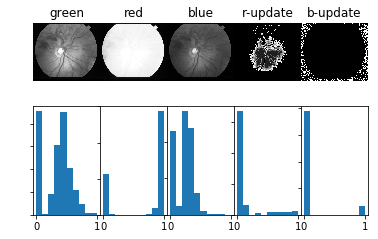



28: Starting on im0029, equalized, 

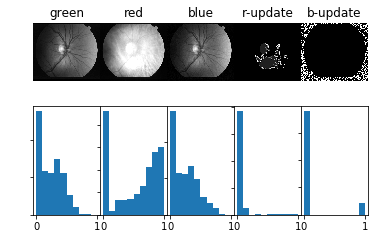



29: Starting on im0030, equalized, 

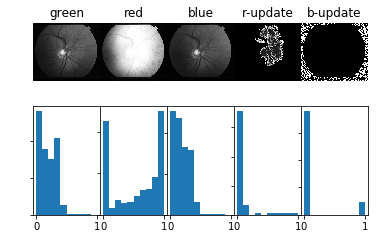



30: Starting on im0031, equalized, 

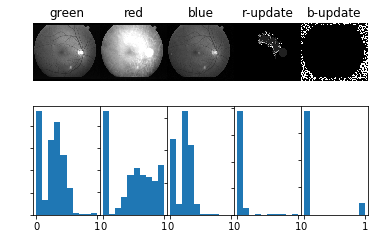



31: Starting on im0032, equalized, 

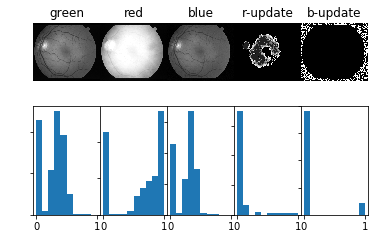



32: Starting on im0033, equalized, 

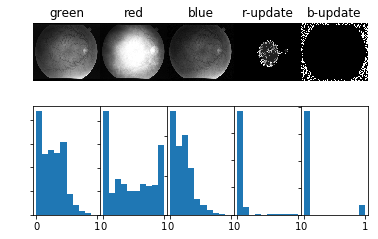



33: Starting on im0034, equalized, 

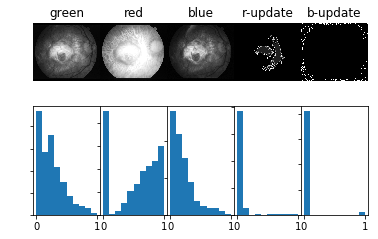



34: Starting on im0035, equalized, 

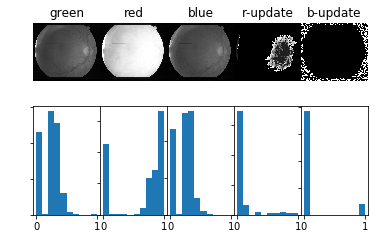



35: Starting on im0036, equalized, 

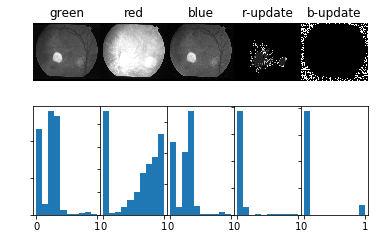



36: Starting on im0037, equalized, 

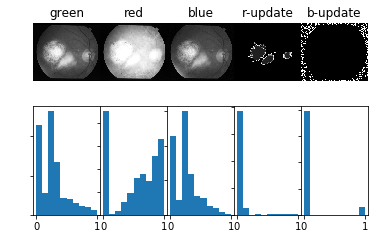



37: Starting on im0038, equalized, 

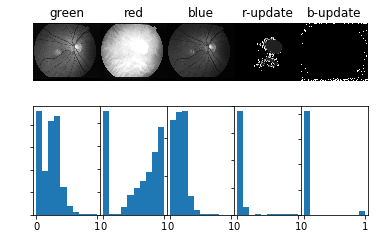



38: Starting on im0039, equalized, 

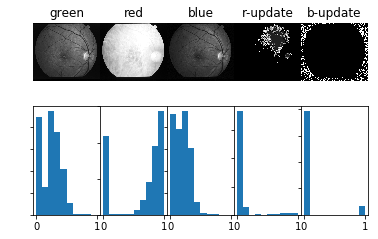



39: Starting on im0040, equalized, 

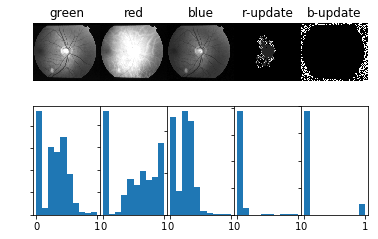



40: Starting on im0041, equalized, 

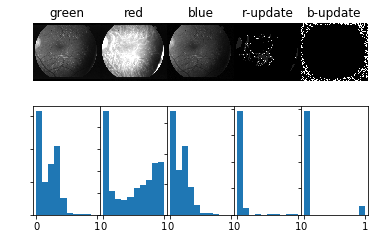



41: Starting on im0042, equalized, 

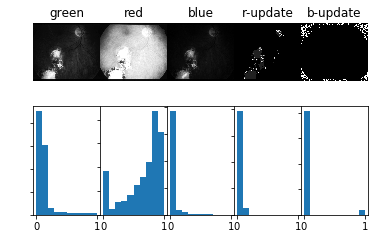



42: Starting on im0043, equalized, 

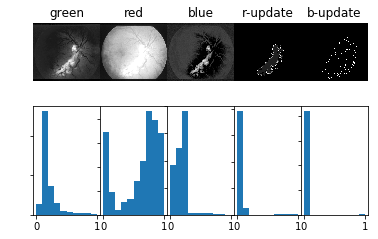



43: Starting on im0044, equalized, 

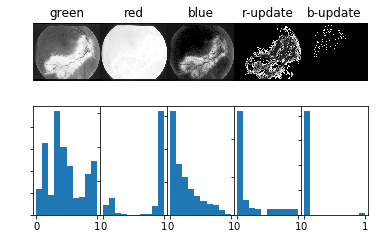



44: Starting on im0045, equalized, 

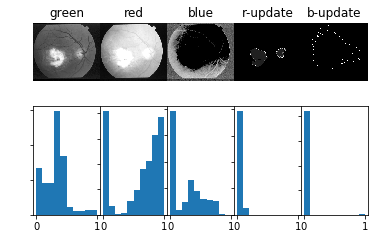



45: Starting on im0046, equalized, 

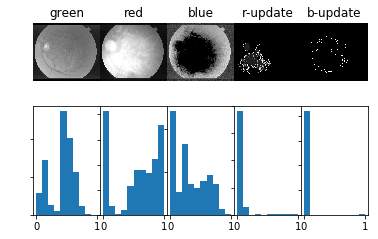



46: Starting on im0048, equalized, 

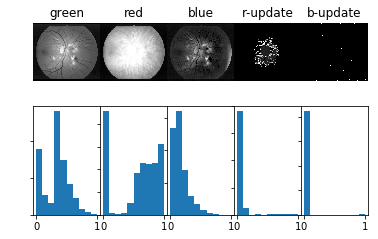



47: Starting on im0049, equalized, 

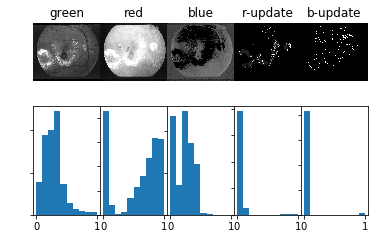



48: Starting on im0050, equalized, 

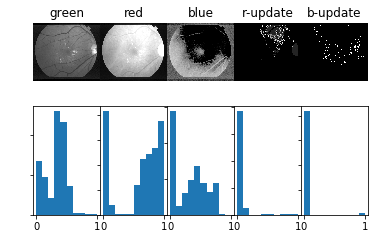



49: Starting on im0051, equalized, 

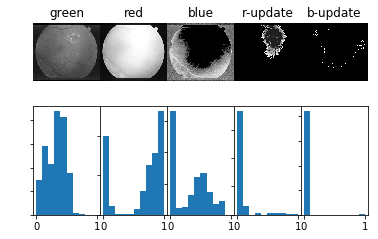



50: Starting on im0052, equalized, 

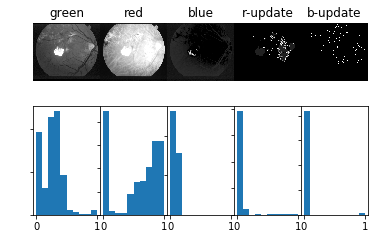



51: Starting on im0053, equalized, 

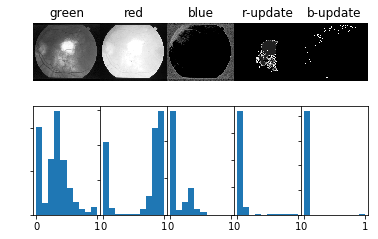



52: Starting on im0054, equalized, 

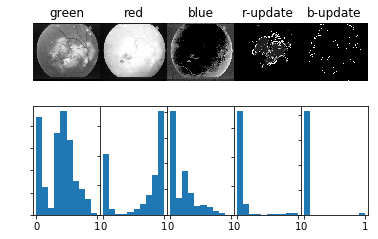



53: Starting on im0055, equalized, 

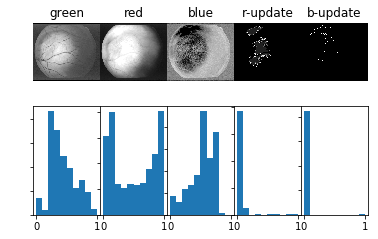



54: Starting on im0056, equalized, 

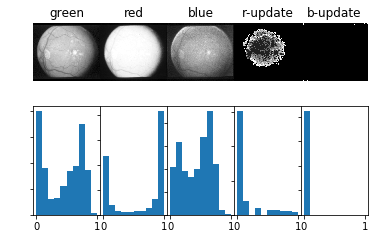



55: Starting on im0057, equalized, 

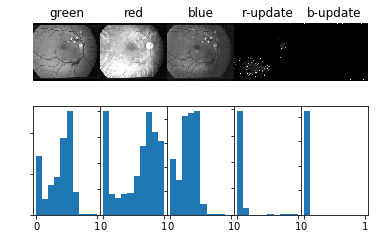



56: Starting on im0058, equalized, 

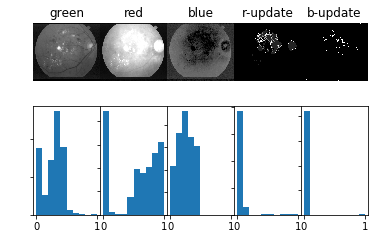



57: Starting on im0059, equalized, 

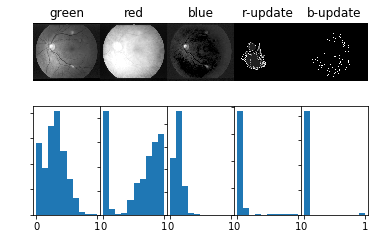



58: Starting on im0060, equalized, 

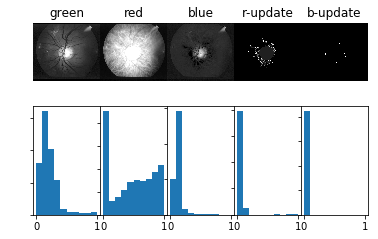



59: Starting on im0061, equalized, 

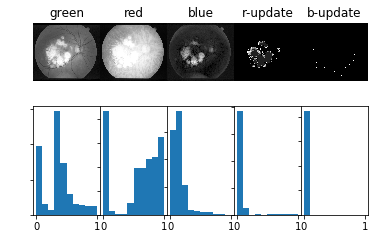



60: Starting on im0062, equalized, 

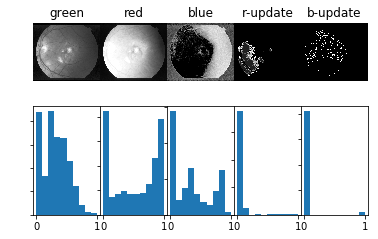



61: Starting on im0063, equalized, 

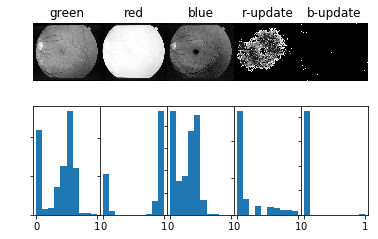



62: Starting on im0064, equalized, 

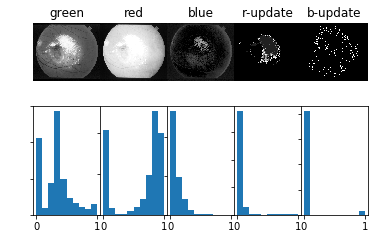



63: Starting on im0065, equalized, 

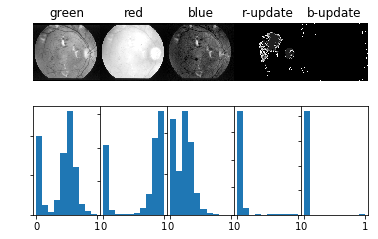



64: Starting on im0066, equalized, 

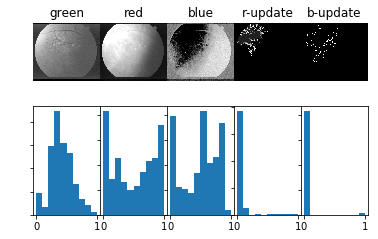



65: Starting on im0067, equalized, 

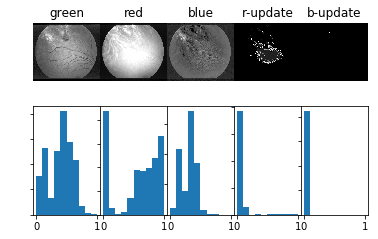



66: Starting on im0068, equalized, 

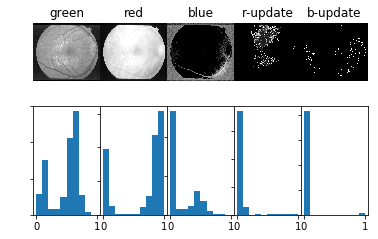



67: Starting on im0069, equalized, 

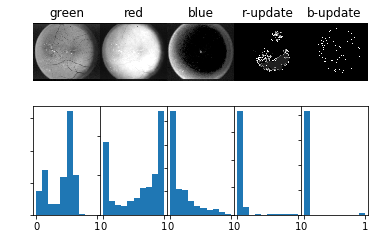



68: Starting on im0070, equalized, 

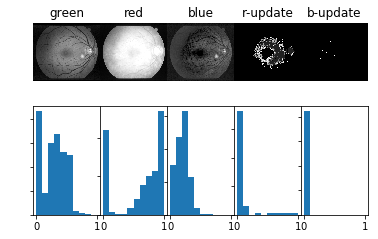



69: Starting on im0071, equalized, 

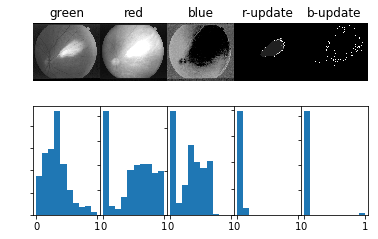



70: Starting on im0072, equalized, 

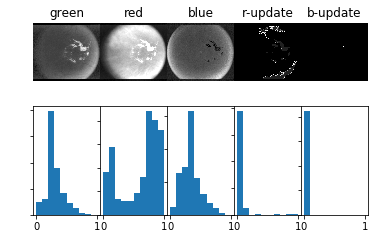



71: Starting on im0073, equalized, 

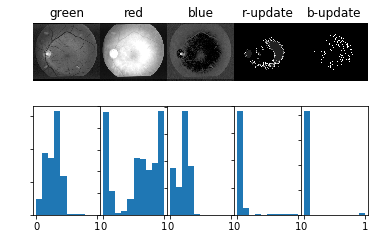



72: Starting on im0074, equalized, 

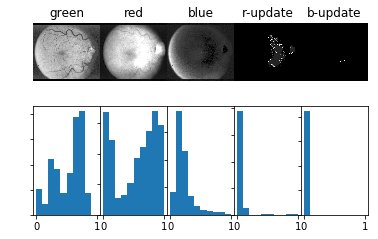



73: Starting on im0075, equalized, 

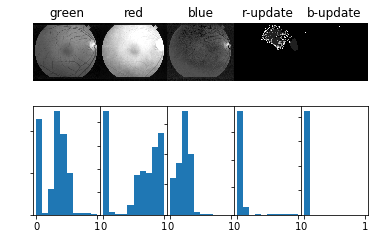



74: Starting on im0076, equalized, 

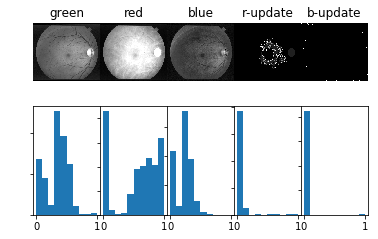



75: Starting on im0077, equalized, 

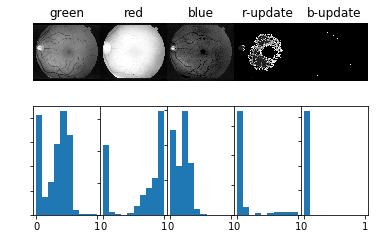



76: Starting on im0078, equalized, 

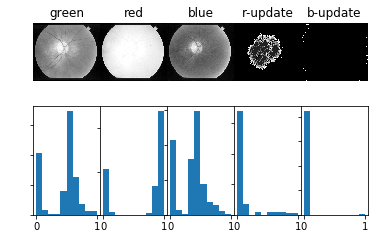



77: Starting on im0079, equalized, 

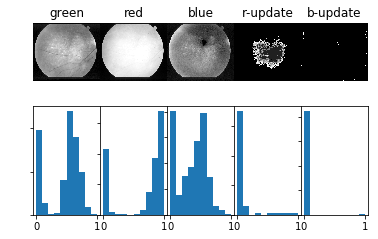



78: Starting on im0080, equalized, 

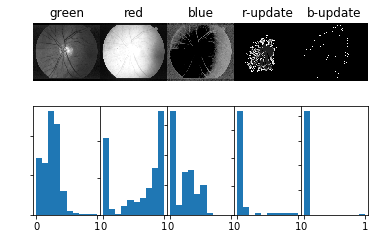



79: Starting on im0081, equalized, 

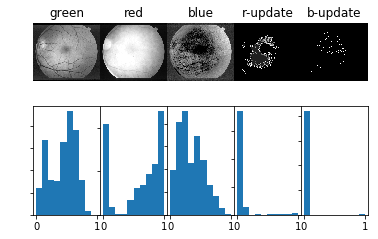



80: Starting on im0082, equalized, 

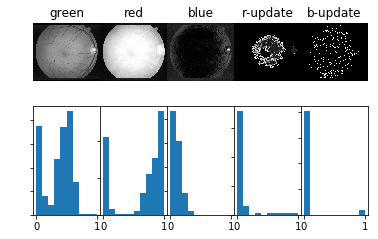



81: Starting on im0083, equalized, 

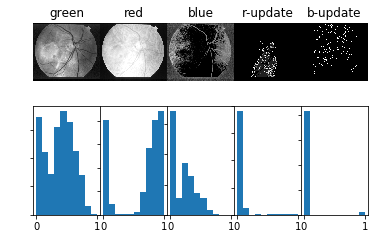



82: Starting on im0084, equalized, 

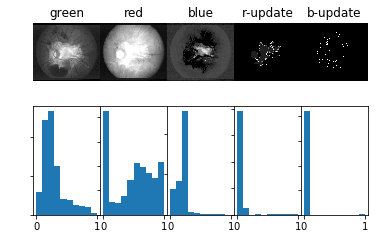



83: Starting on im0085, equalized, 

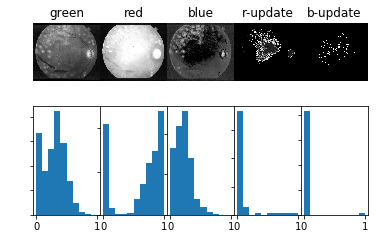



84: Starting on im0086, equalized, 

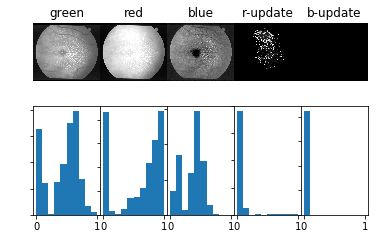



85: Starting on im0087, equalized, 

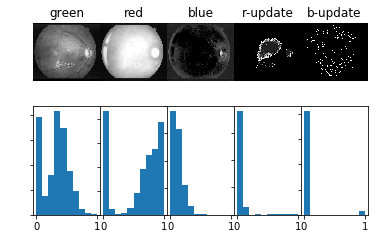



86: Starting on im0088, equalized, 

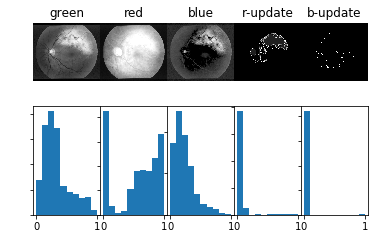



87: Starting on im0089, equalized, 

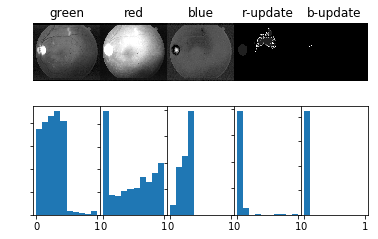



88: Starting on im0090, equalized, 

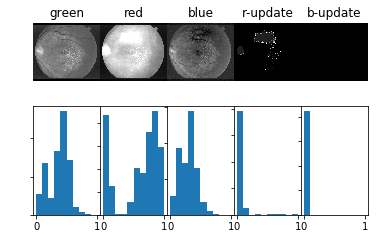



89: Starting on im0091, equalized, 

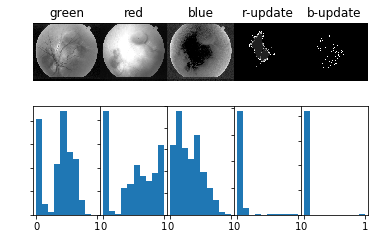



90: Starting on im0092, equalized, 

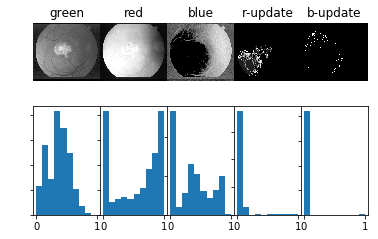



91: Starting on im0093, equalized, 

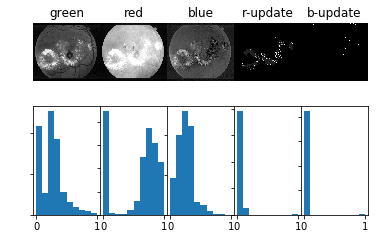



92: Starting on im0094, equalized, 

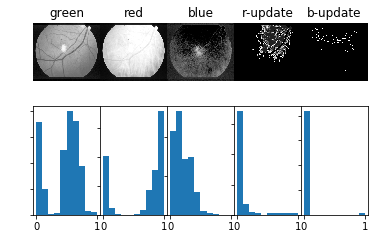



93: Starting on im0095, equalized, 

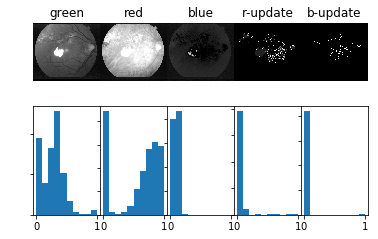



94: Starting on im0096, equalized, 

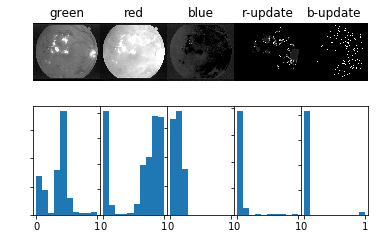



95: Starting on im0097, equalized, 

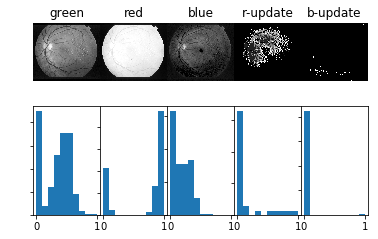



96: Starting on im0098, equalized, 

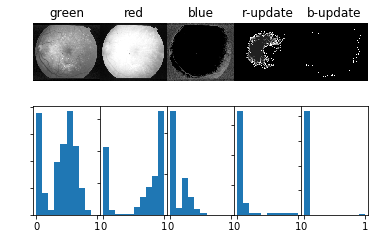



97: Starting on im0099, equalized, 

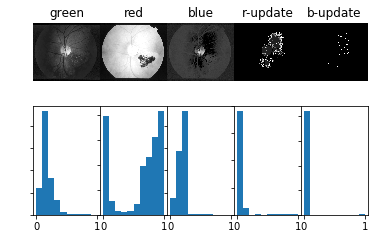



98: Starting on im0100, equalized, 

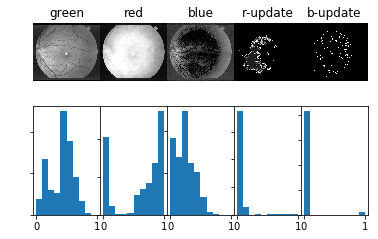



99: Starting on im0101, equalized, 

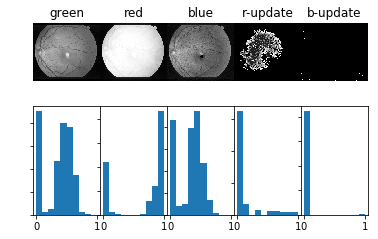



100: Starting on im0102, equalized, 

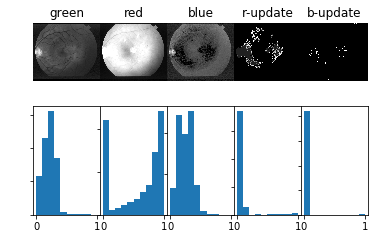



101: Starting on im0103, equalized, 

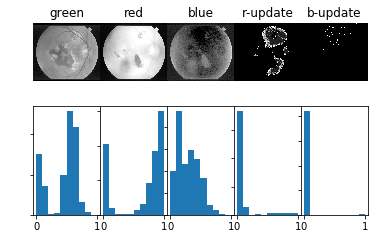



102: Starting on im0104, equalized, 

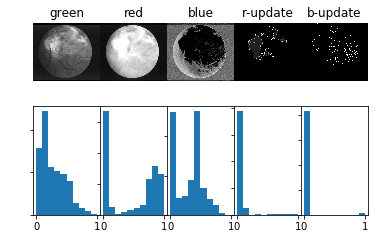



103: Starting on im0105, equalized, 

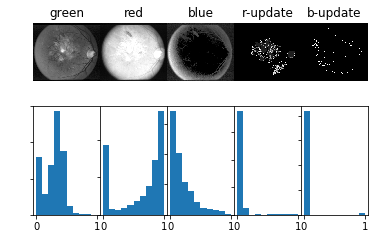



104: Starting on im0106, equalized, 

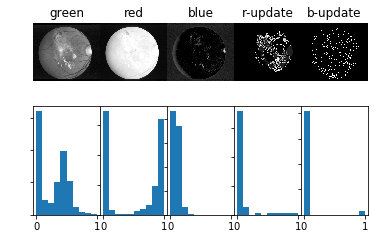



105: Starting on im0107, equalized, 

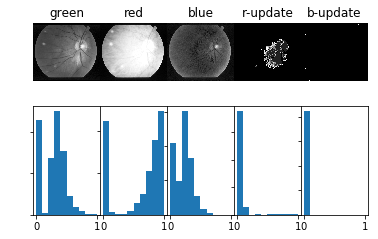



106: Starting on im0110, equalized, 

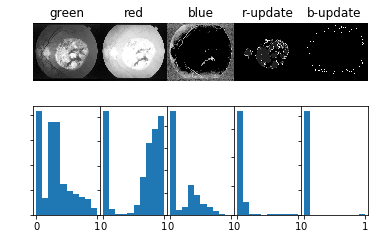



107: Starting on im0111, equalized, 

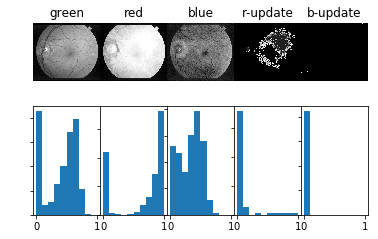



108: Starting on im0112, equalized, 

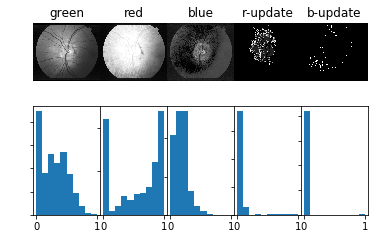



109: Starting on im0113, equalized, 

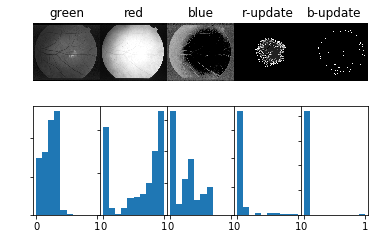



110: Starting on im0114, equalized, 

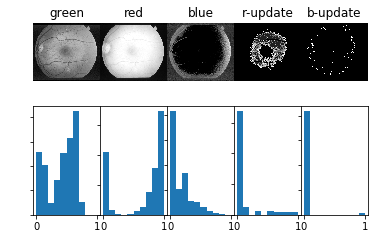



111: Starting on im0115, equalized, 

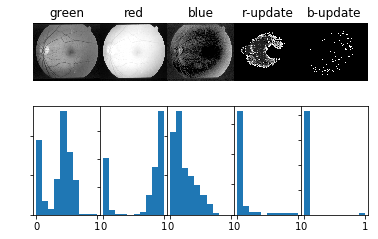



112: Starting on im0116, equalized, 

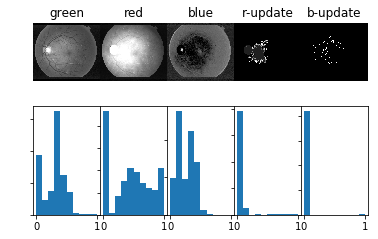



113: Starting on im0117, equalized, 

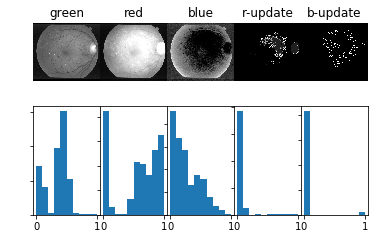



114: Starting on im0118, equalized, 

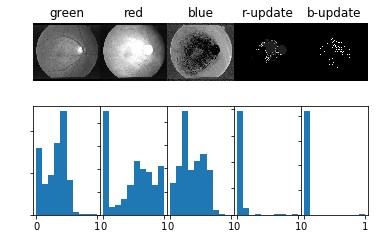



115: Starting on im0119, equalized, 

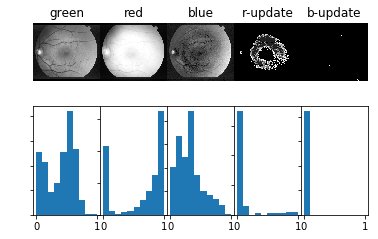



116: Starting on im0120, equalized, 

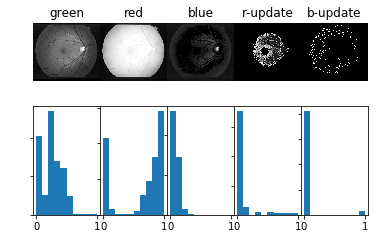



117: Starting on im0121, equalized, 

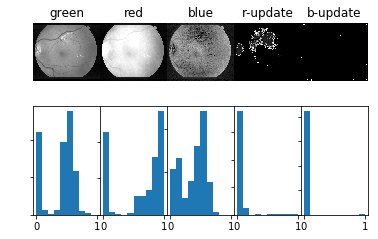



118: Starting on im0122, equalized, 

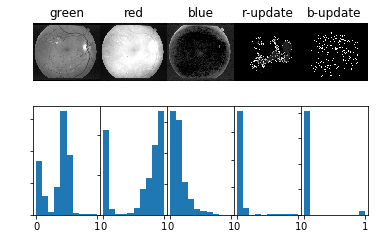



119: Starting on im0123, equalized, 

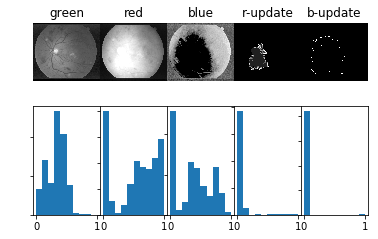



120: Starting on im0124, equalized, 

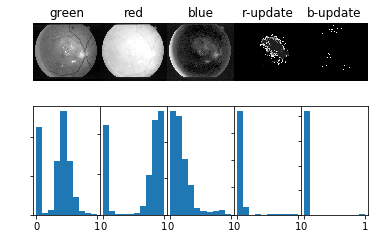



121: Starting on im0125, equalized, 

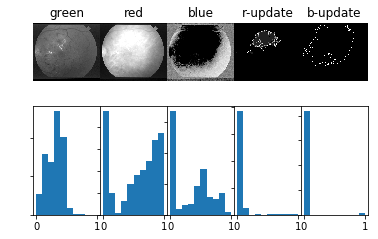



122: Starting on im0126, equalized, 

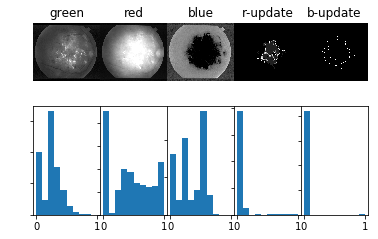



123: Starting on im0127, equalized, 

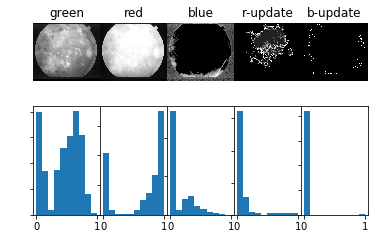



124: Starting on im0128, equalized, 

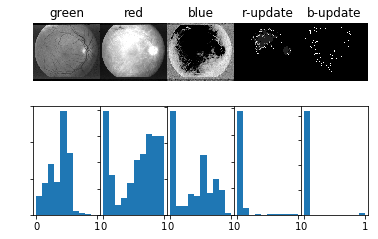



125: Starting on im0129, equalized, 

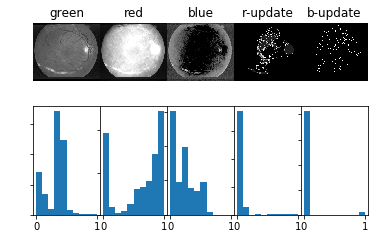



126: Starting on im0130, equalized, 

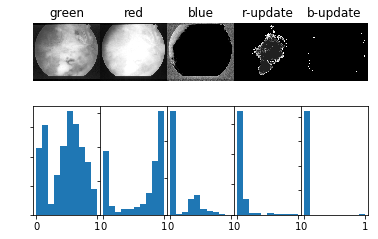



127: Starting on im0131, equalized, 

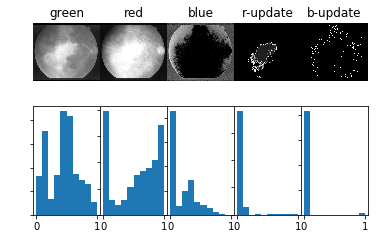



128: Starting on im0132, equalized, 

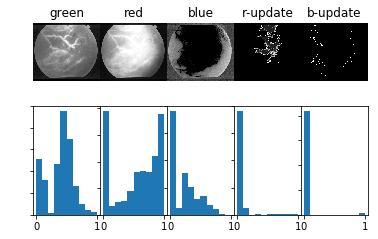



129: Starting on im0133, equalized, 

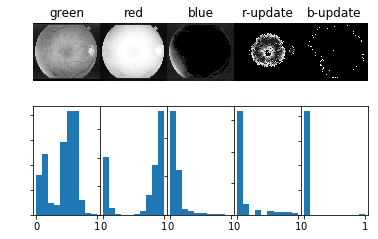



130: Starting on im0134, equalized, 

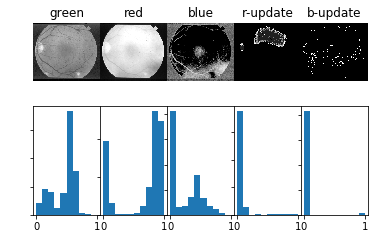



131: Starting on im0135, equalized, 

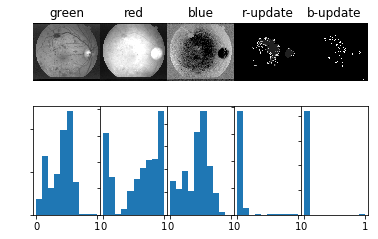



132: Starting on im0136, equalized, 

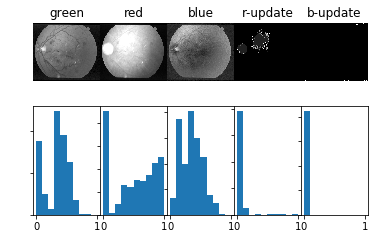



133: Starting on im0137, equalized, 

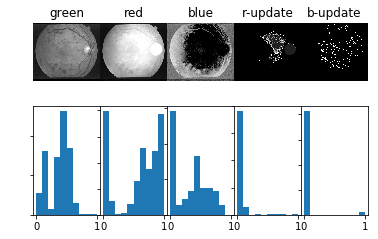



134: Starting on im0138, equalized, 

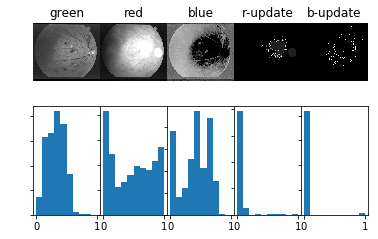



135: Starting on im0139, equalized, 

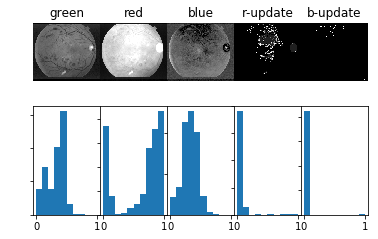



136: Starting on im0140, equalized, 

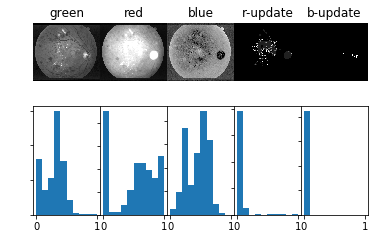



137: Starting on im0141, equalized, 

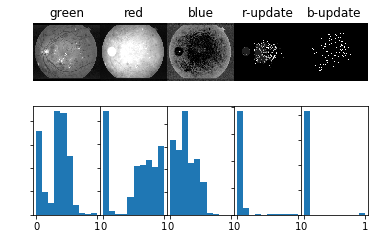



138: Starting on im0142, equalized, 

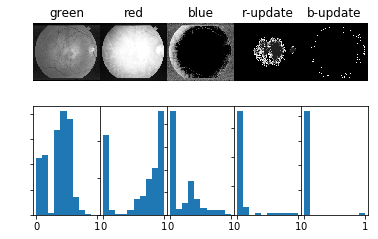



139: Starting on im0143, equalized, 

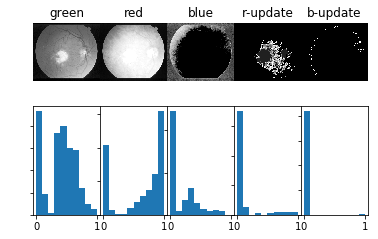



140: Starting on im0145, equalized, 

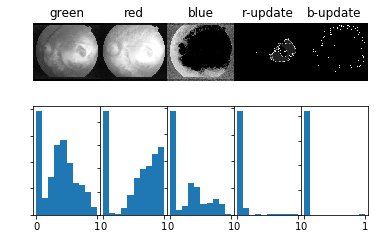



141: Starting on im0146, equalized, 

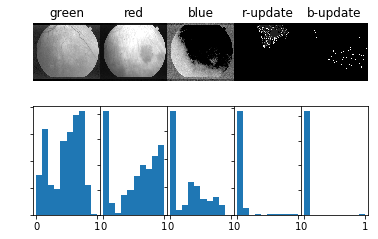



142: Starting on im0147, equalized, 

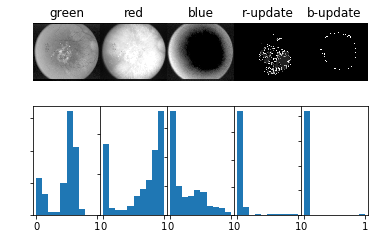



143: Starting on im0148, equalized, 

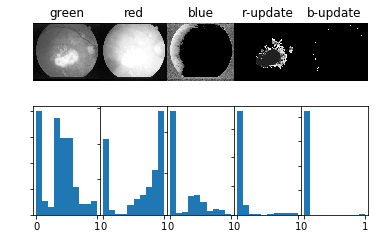



144: Starting on im0149, equalized, 

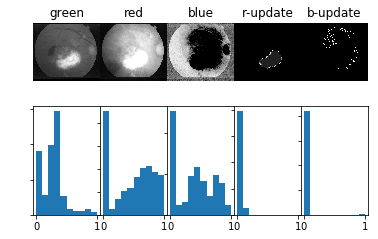



145: Starting on im0150, equalized, 

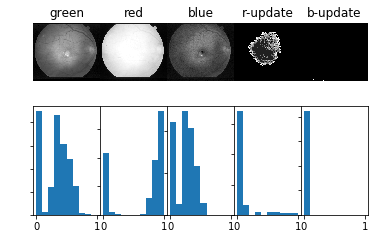



146: Starting on im0151, equalized, 

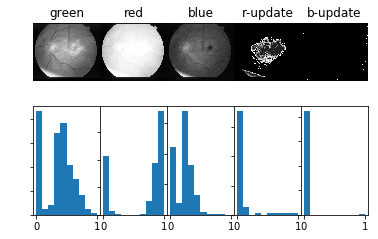



147: Starting on im0152, equalized, 

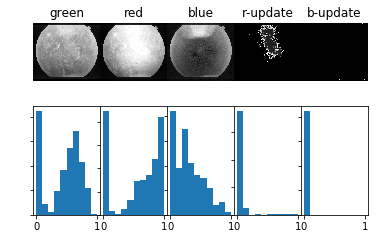



148: Starting on im0153, equalized, 

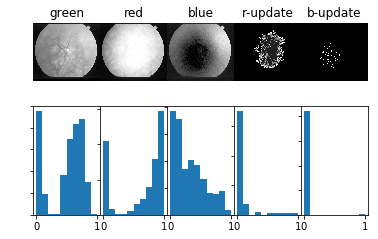



149: Starting on im0154, equalized, 

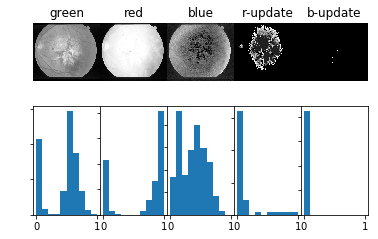



150: Starting on im0155, equalized, 

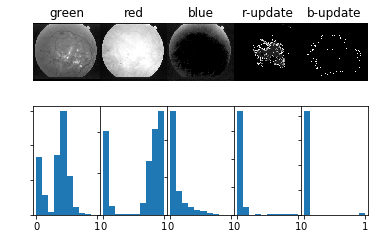



151: Starting on im0156, equalized, 

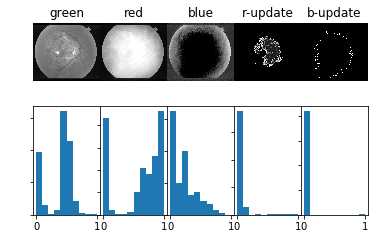



152: Starting on im0157, equalized, 

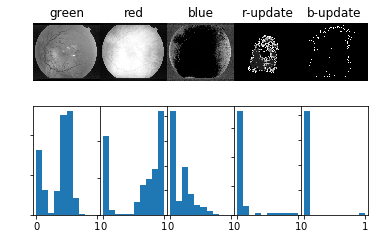



153: Starting on im0158, equalized, 

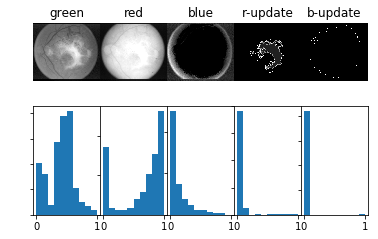



154: Starting on im0159, equalized, 

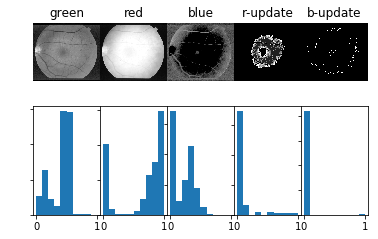



155: Starting on im0160, equalized, 

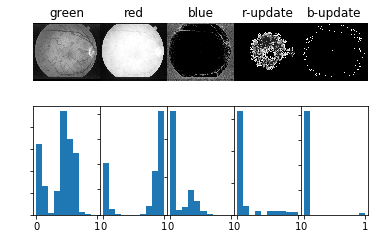



156: Starting on im0161, equalized, 

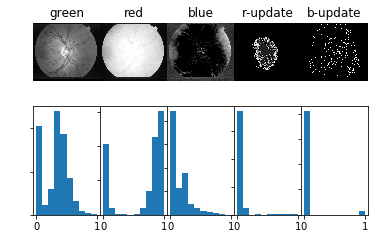



157: Starting on im0162, equalized, 

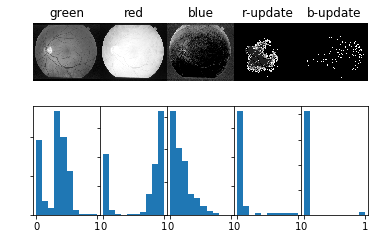



158: Starting on im0163, equalized, 

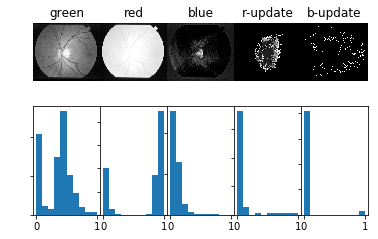



159: Starting on im0164, equalized, 

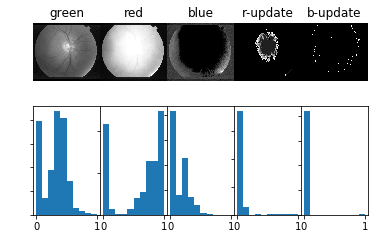



160: Starting on im0165, equalized, 

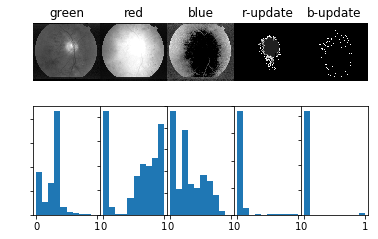



161: Starting on im0166, equalized, 

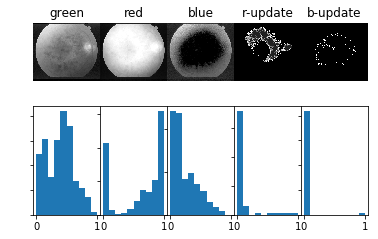



162: Starting on im0168, equalized, 

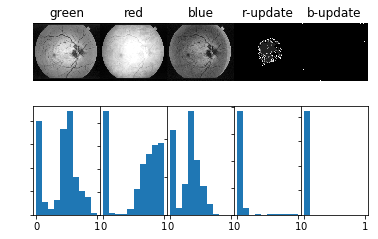



163: Starting on im0169, equalized, 

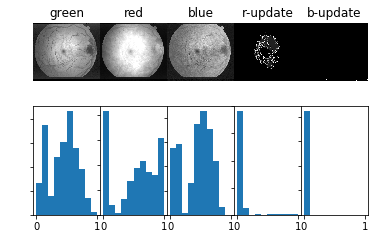



164: Starting on im0170, equalized, 

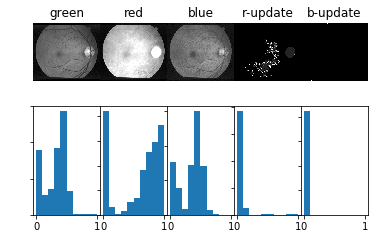



165: Starting on im0171, equalized, 

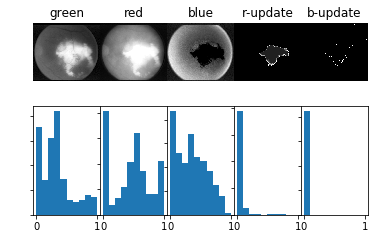



166: Starting on im0172, equalized, 

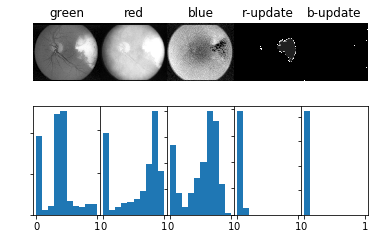



167: Starting on im0173, equalized, 

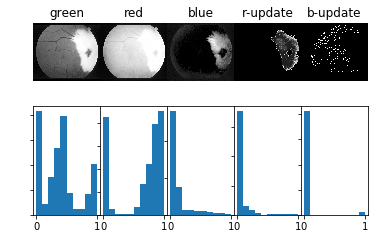



168: Starting on im0174, equalized, 

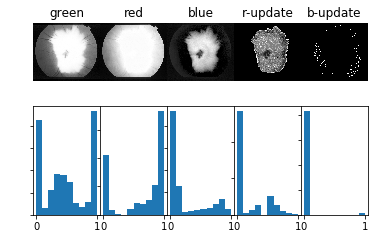



169: Starting on im0175, equalized, 

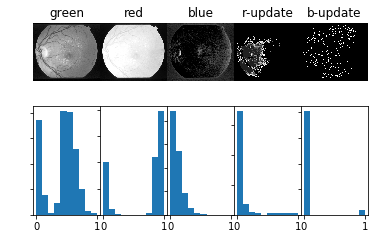



170: Starting on im0176, equalized, 

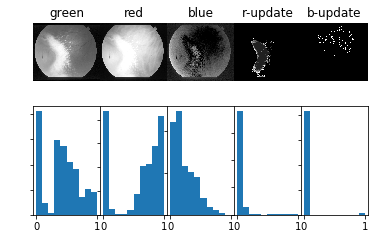



171: Starting on im0177, equalized, 

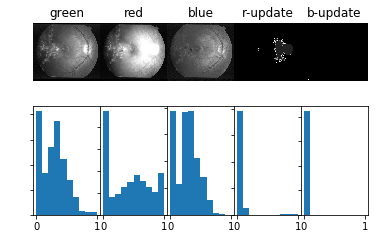



172: Starting on im0178, equalized, 

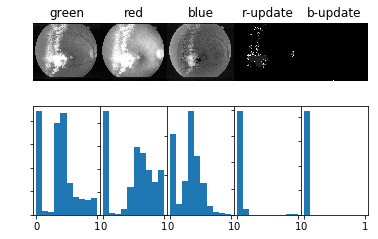



173: Starting on im0179, equalized, 

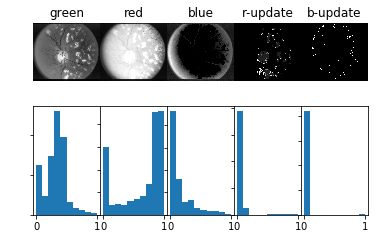



174: Starting on im0180, equalized, 

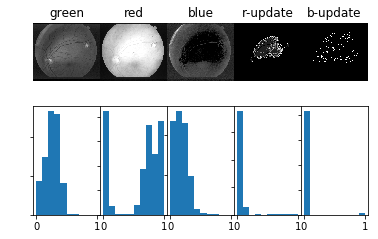



175: Starting on im0181, equalized, 

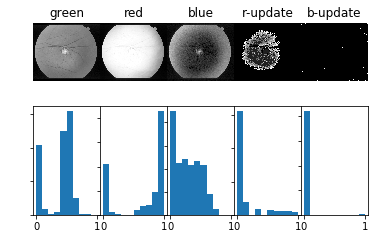



176: Starting on im0182, equalized, 

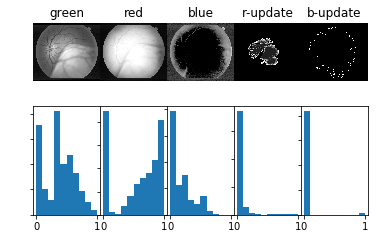



177: Starting on im0183, equalized, 

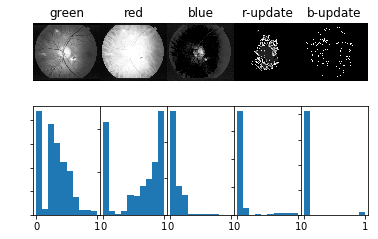



178: Starting on im0184, equalized, 

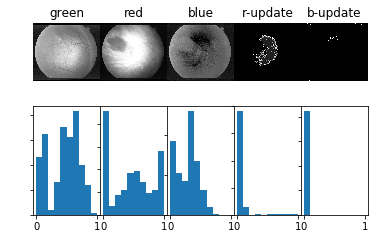



179: Starting on im0185, equalized, 

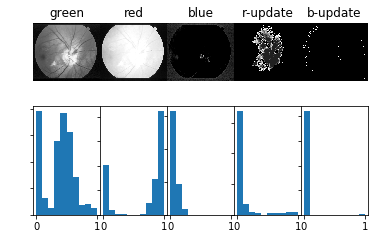



180: Starting on im0186, equalized, 

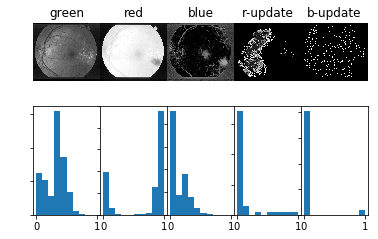



181: Starting on im0187, equalized, 

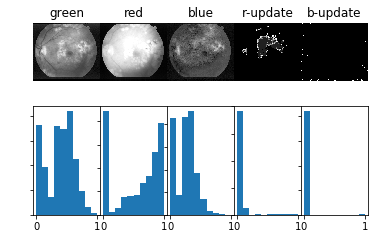



182: Starting on im0188, equalized, 

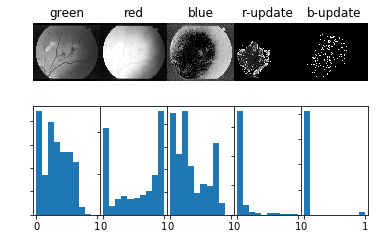



183: Starting on im0189, equalized, 

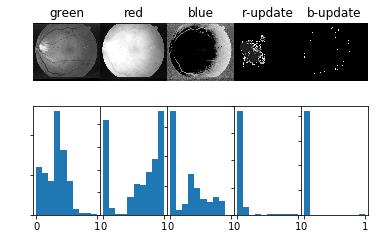



184: Starting on im0190, equalized, 

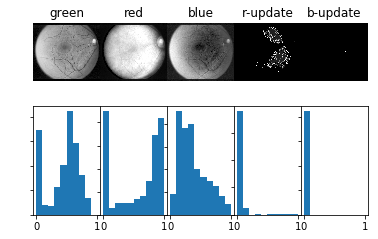



185: Starting on im0191, equalized, 

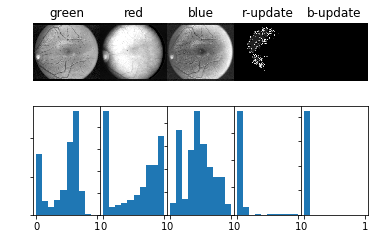



186: Starting on im0192, equalized, 

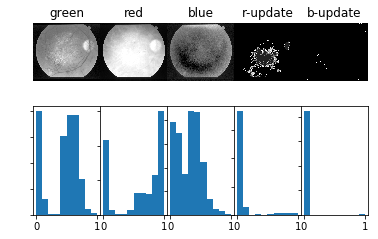



187: Starting on im0193, equalized, 

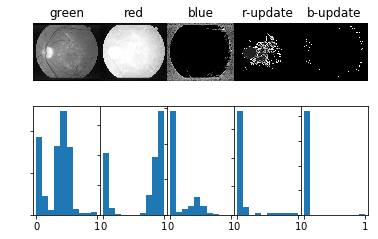



188: Starting on im0194, equalized, 

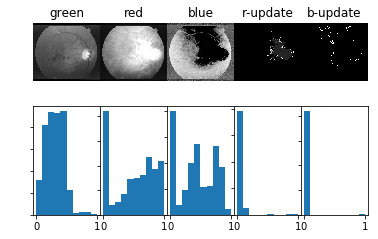



189: Starting on im0195, equalized, 

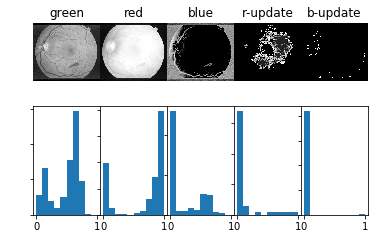



190: Starting on im0196, equalized, 

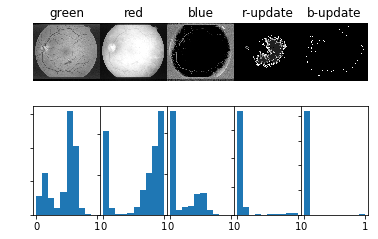



191: Starting on im0197, equalized, 

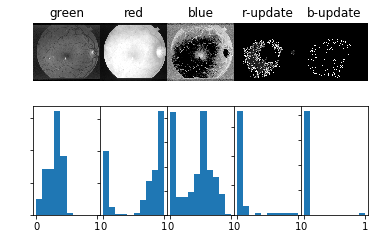



192: Starting on im0198, equalized, 

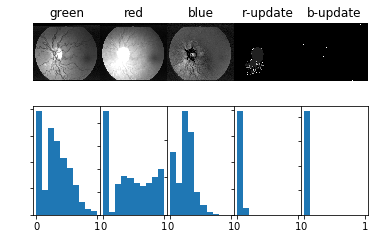



193: Starting on im0199, equalized, 

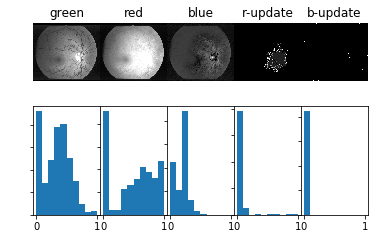



194: Starting on im0200, equalized, 

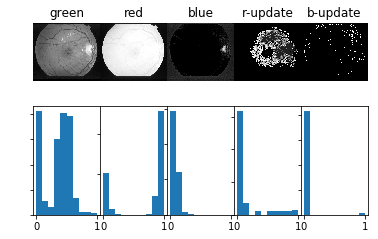



195: Starting on im0201, equalized, 

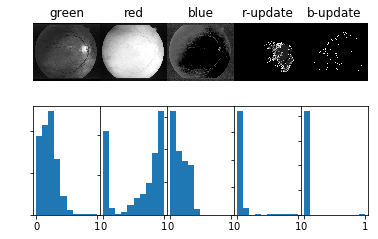



196: Starting on im0202, equalized, 

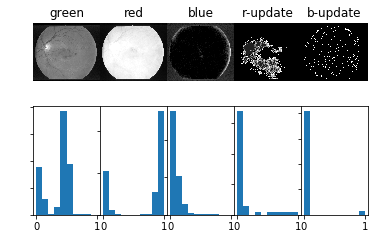



197: Starting on im0203, equalized, 

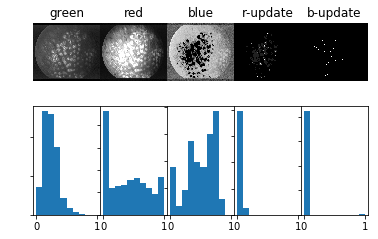



198: Starting on im0204, equalized, 

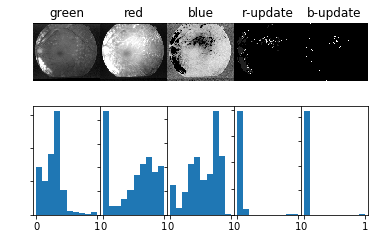



199: Starting on im0205, equalized, 

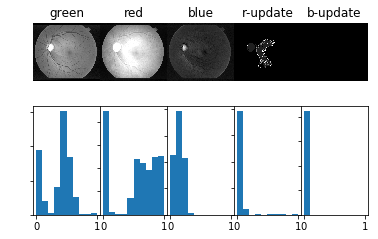



200: Starting on im0206, equalized, 

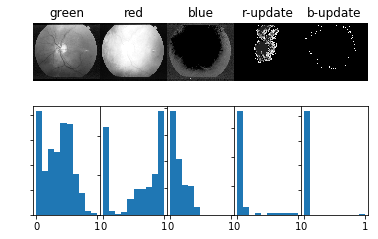



201: Starting on im0207, equalized, 

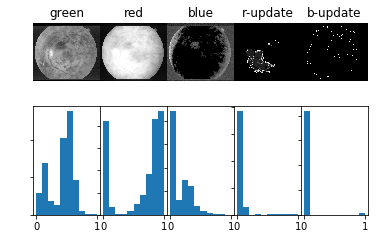



202: Starting on im0208, equalized, 

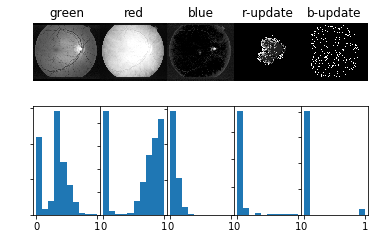



203: Starting on im0209, equalized, 

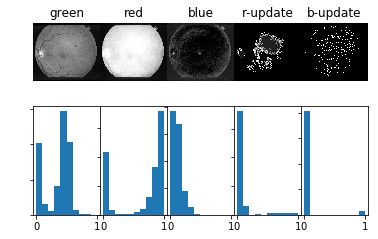



204: Starting on im0210, equalized, 

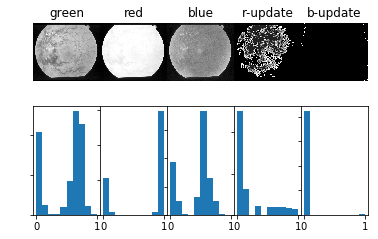



205: Starting on im0211, equalized, 

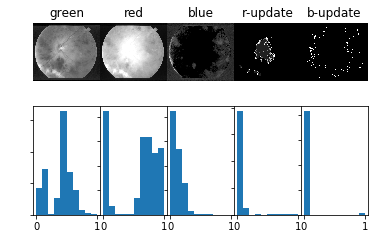



206: Starting on im0212, equalized, 

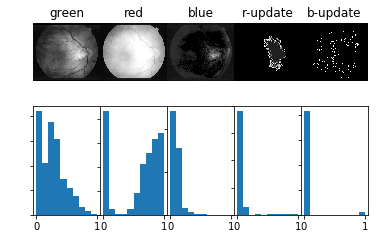



207: Starting on im0213, equalized, 

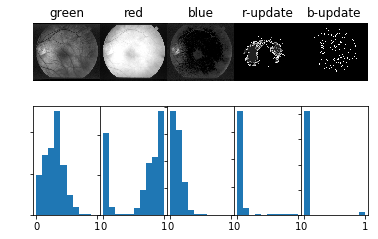



208: Starting on im0214, equalized, 

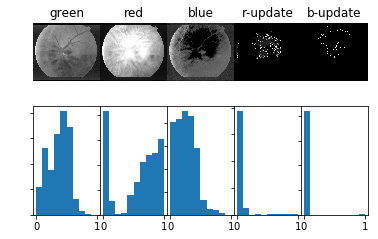



209: Starting on im0215, equalized, 

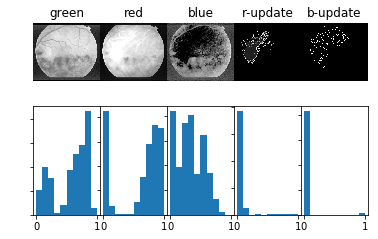



210: Starting on im0216, equalized, 

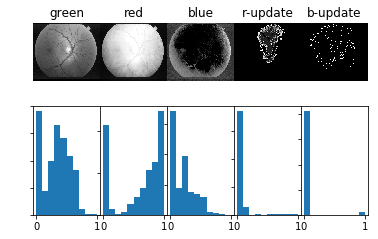



211: Starting on im0217, equalized, 

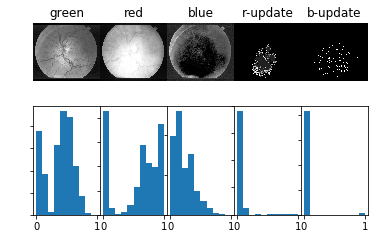



212: Starting on im0218, equalized, 

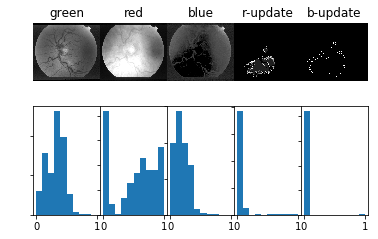



213: Starting on im0219, equalized, 

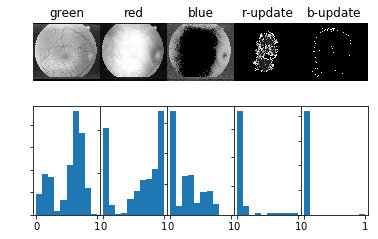



214: Starting on im0220, equalized, 

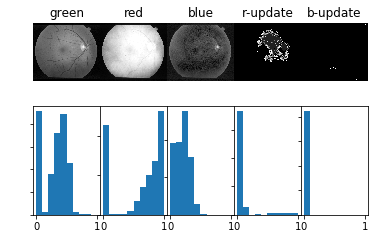



215: Starting on im0221, equalized, 

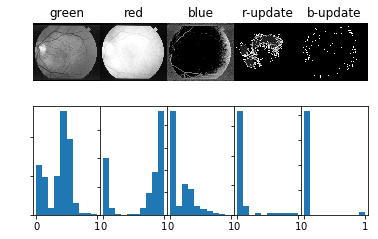



216: Starting on im0222, equalized, 

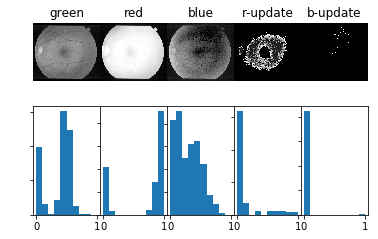



217: Starting on im0223, equalized, 

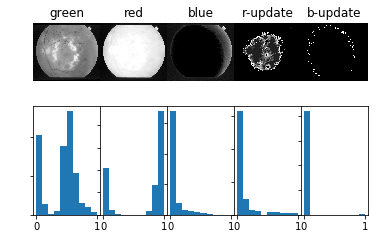



218: Starting on im0224, equalized, 

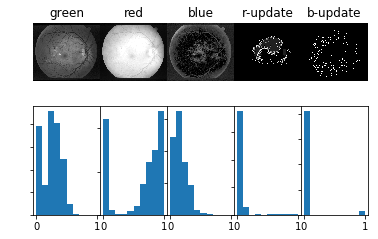



219: Starting on im0225, equalized, 

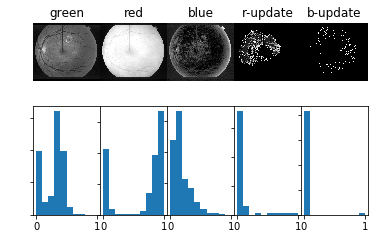



220: Starting on im0226, equalized, 

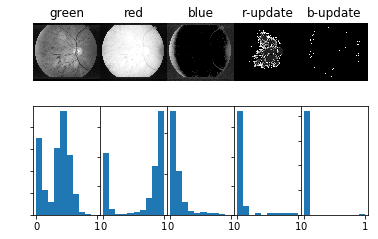



221: Starting on im0227, equalized, 

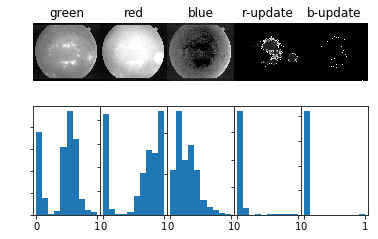



222: Starting on im0228, equalized, 

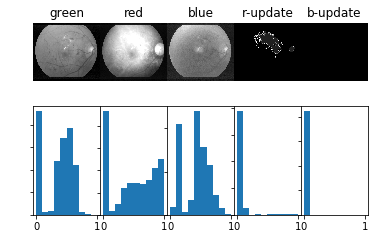



223: Starting on im0229, equalized, 

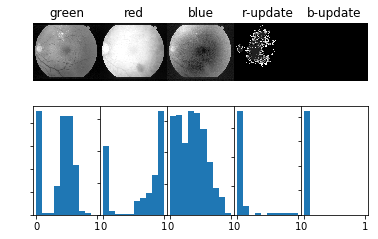



224: Starting on im0230, equalized, 

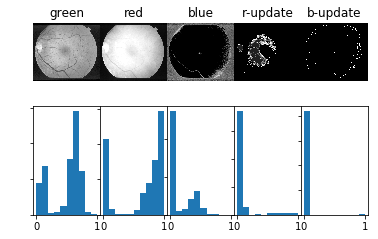



225: Starting on im0231, equalized, 

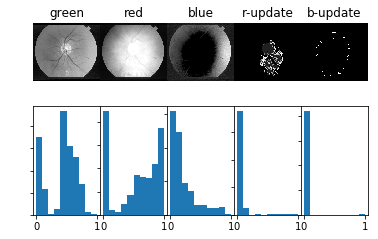



226: Starting on im0232, equalized, 

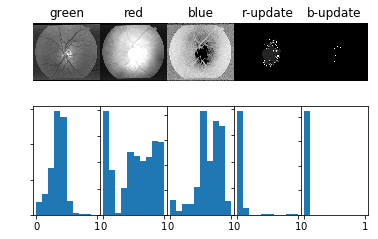



227: Starting on im0233, equalized, 

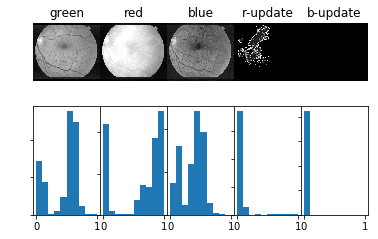



228: Starting on im0234, equalized, 

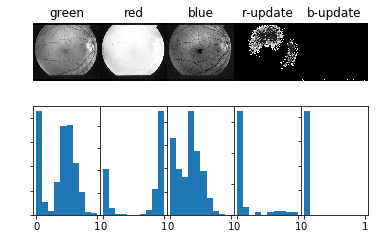



229: Starting on im0235, equalized, 

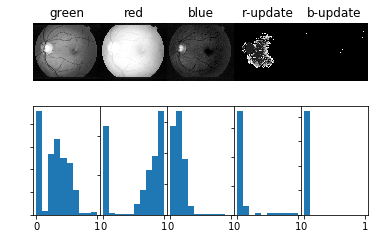



230: Starting on im0236, equalized, 

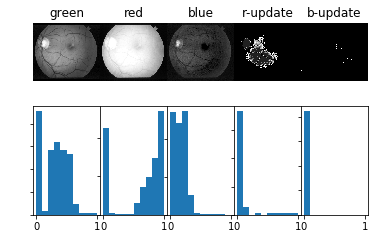



231: Starting on im0237, equalized, 

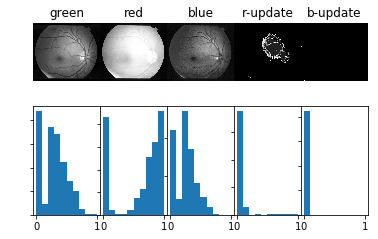



232: Starting on im0238, equalized, 

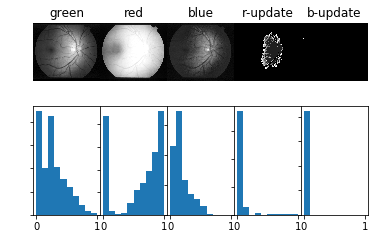



233: Starting on im0239, equalized, 

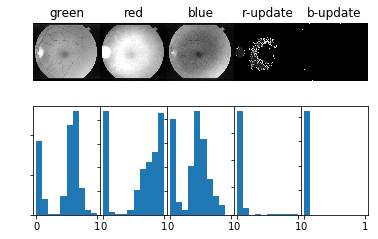



234: Starting on im0240, equalized, 

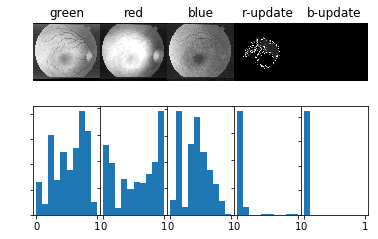



235: Starting on im0241, equalized, 

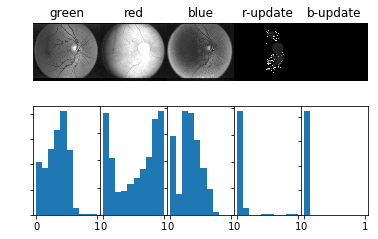



236: Starting on im0242, equalized, 

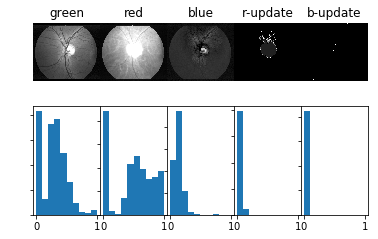



237: Starting on im0243, equalized, 

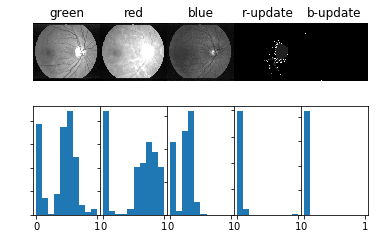



238: Starting on im0244, equalized, 

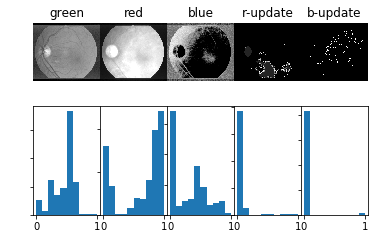



239: Starting on im0245, equalized, 240: Starting on im0246, equalized, 

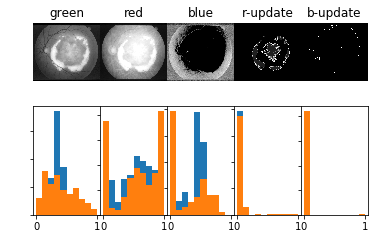



241: Starting on im0247, equalized, 

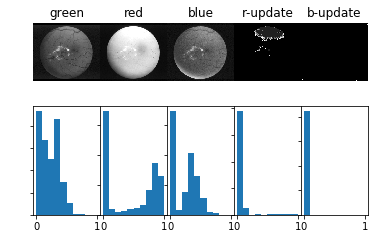



242: Starting on im0248, equalized, 

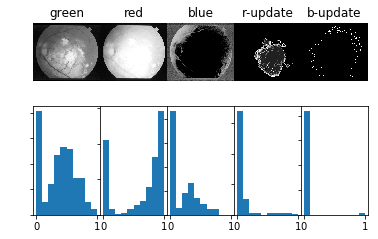



243: Starting on im0249, equalized, 

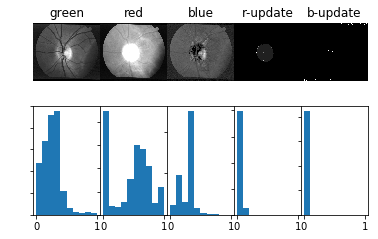



244: Starting on im0250, equalized, 

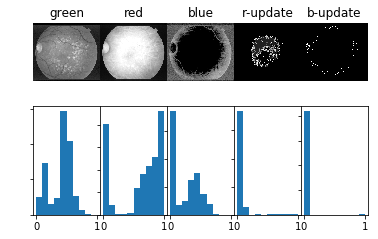



245: Starting on im0251, equalized, 

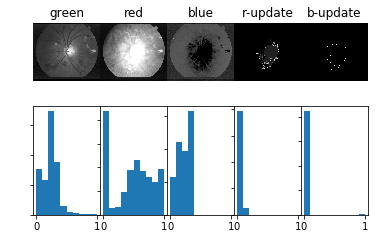



246: Starting on im0252, equalized, 

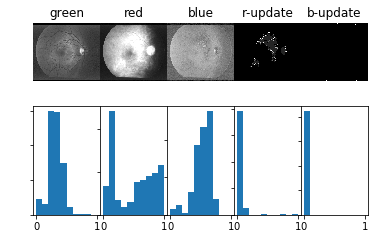



247: Starting on im0253, equalized, 

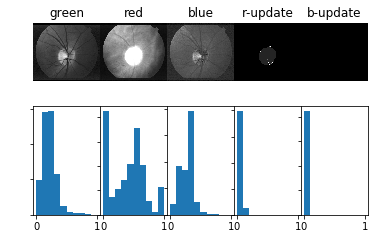



248: Starting on im0254, equalized, 

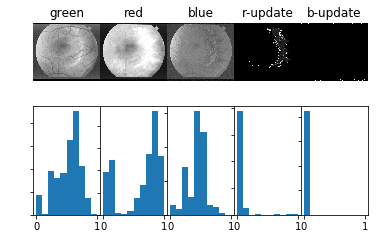



249: Starting on im0255, equalized, 

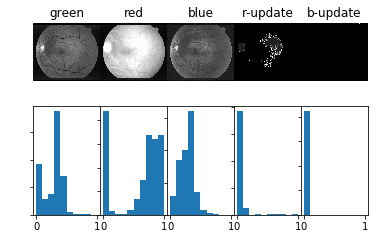



250: Starting on im0256, equalized, 

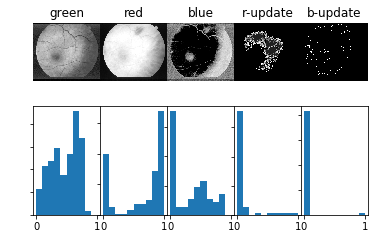



251: Starting on im0257, equalized, 

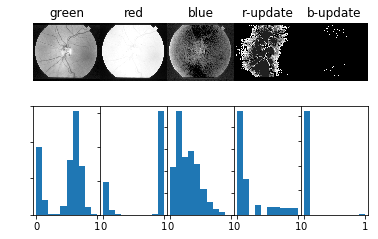



252: Starting on im0258, equalized, 

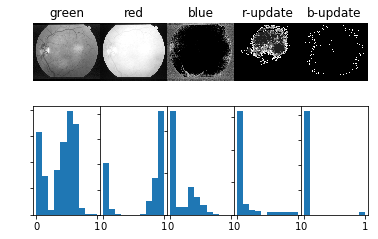



253: Starting on im0259, equalized, 

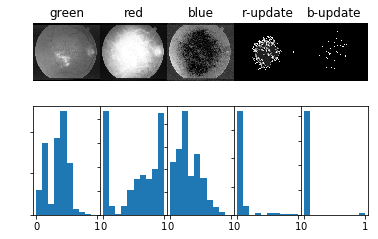



254: Starting on im0260, equalized, 

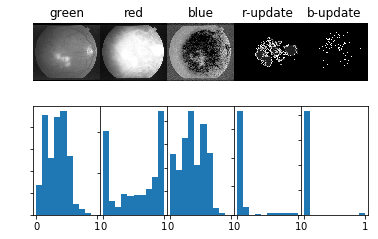



255: Starting on im0261, equalized, 

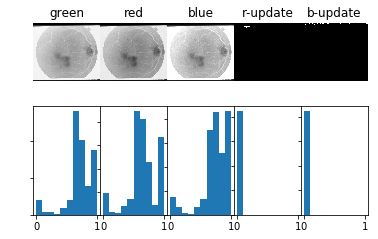



256: Starting on im0262, equalized, 

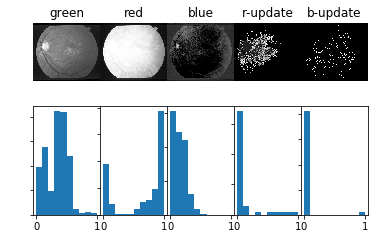



257: Starting on im0263, equalized, 

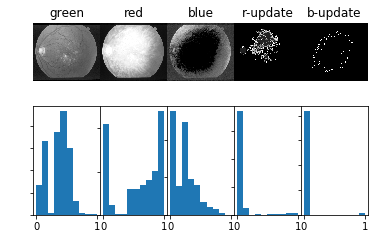



258: Starting on im0264, equalized, 

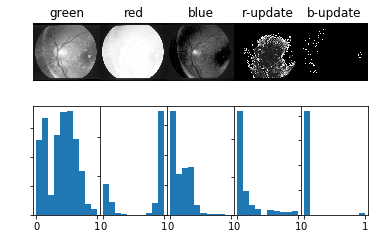



259: Starting on im0265, equalized, 

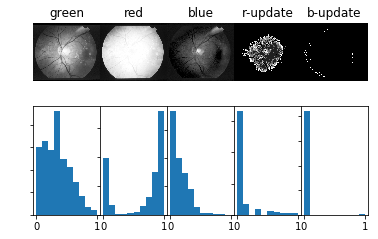



260: Starting on im0266, equalized, 

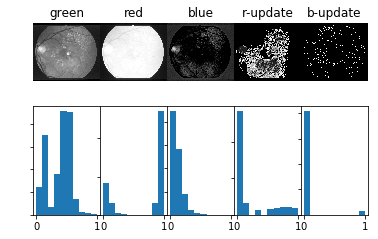



261: Starting on im0267, equalized, 

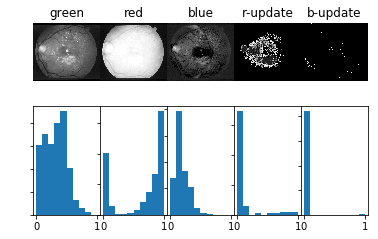



262: Starting on im0268, equalized, 

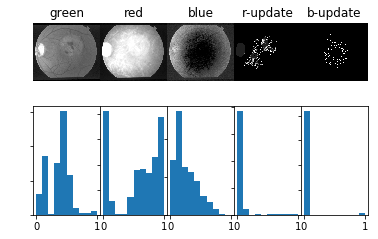



263: Starting on im0269, equalized, 

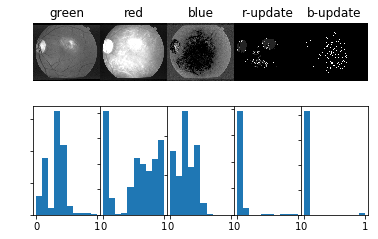



264: Starting on im0270, equalized, 

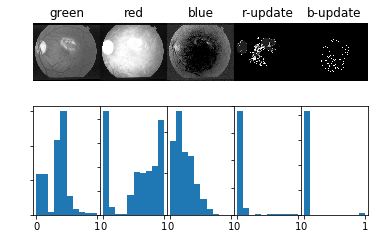



265: Starting on im0271, equalized, 

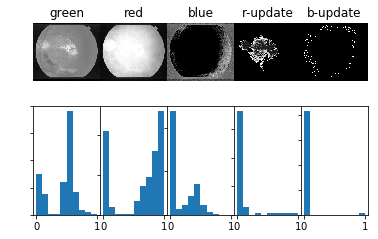



266: Starting on im0272, equalized, 

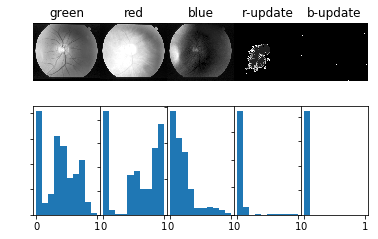



267: Starting on im0273, equalized, 

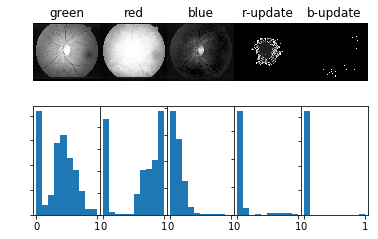



268: Starting on im0274, equalized, 

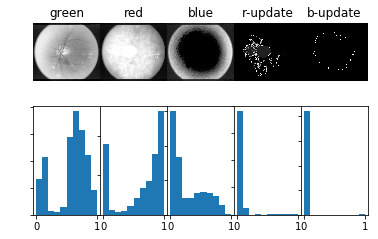



269: Starting on im0275, equalized, 

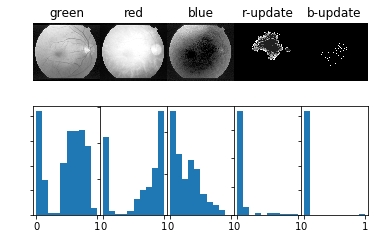



270: Starting on im0276, equalized, 

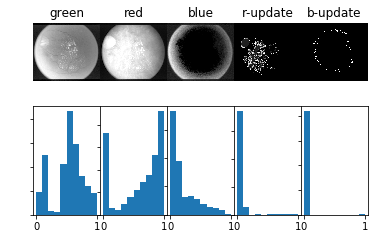



271: Starting on im0277, equalized, 

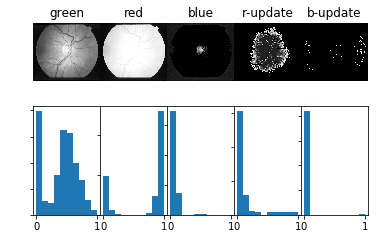



272: Starting on im0278, equalized, 

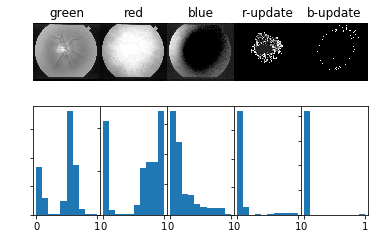



273: Starting on im0279, equalized, 

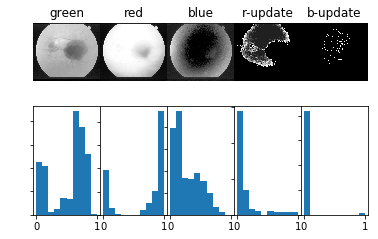



274: Starting on im0280, equalized, 

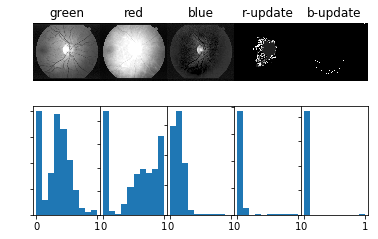



275: Starting on im0281, equalized, 

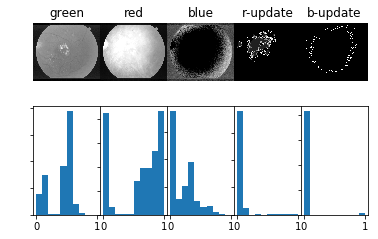



276: Starting on im0282, equalized, 

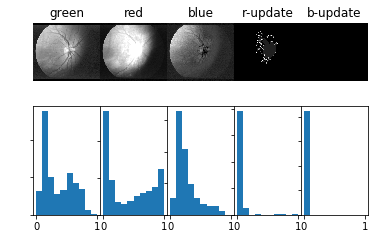



277: Starting on im0283, equalized, 

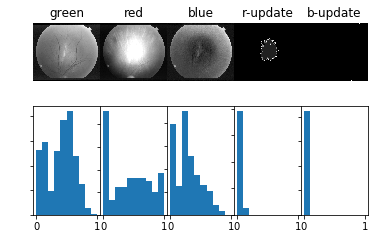



278: Starting on im0284, equalized, 

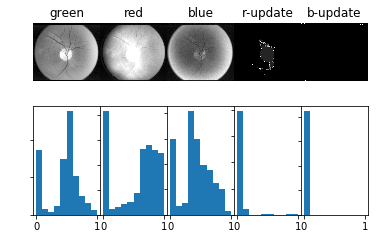



279: Starting on im0285, equalized, 

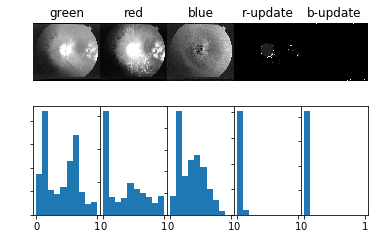



280: Starting on im0286, equalized, 

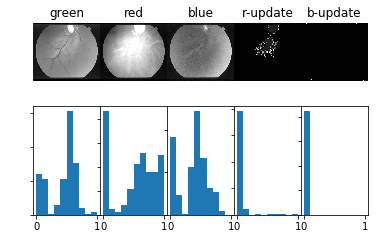



281: Starting on im0287, equalized, 

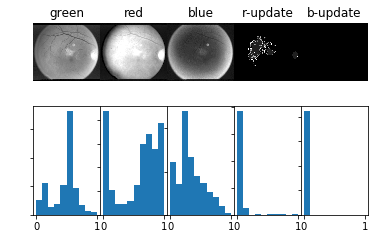



282: Starting on im0288, equalized, 

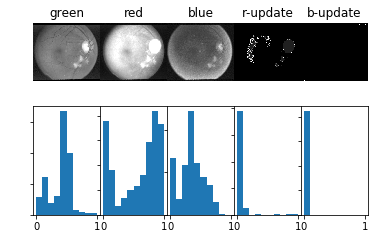



283: Starting on im0289, equalized, 

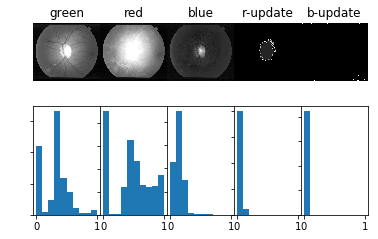



284: Starting on im0290, equalized, 

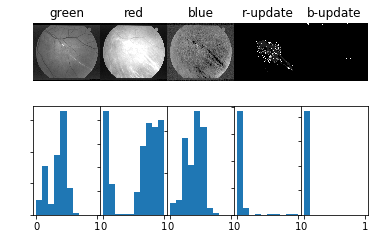



285: Starting on im0291, equalized, 

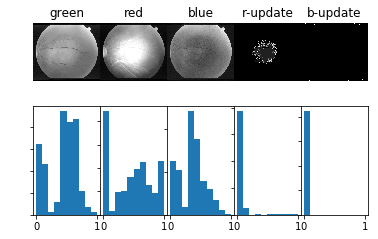



286: Starting on im0292, equalized, 

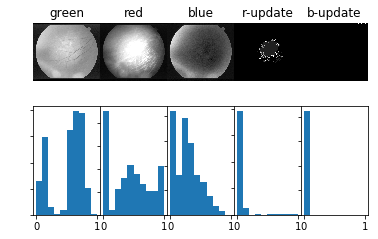



287: Starting on im0293, equalized, 

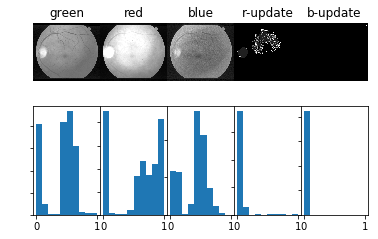



288: Starting on im0294, equalized, 

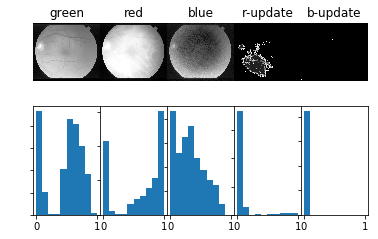



289: Starting on im0295, equalized, 

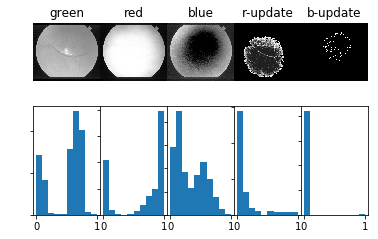



290: Starting on im0296, equalized, 

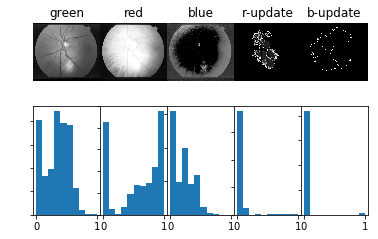



291: Starting on im0297, equalized, 

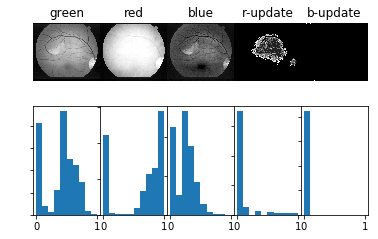



292: Starting on im0298, equalized, 

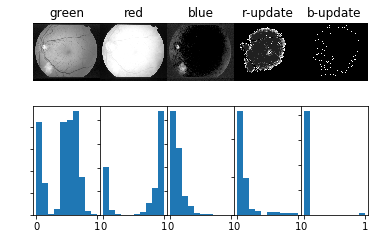



293: Starting on im0299, equalized, 

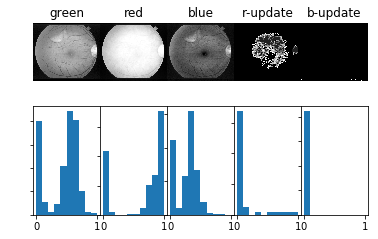



294: Starting on im0300, equalized, 

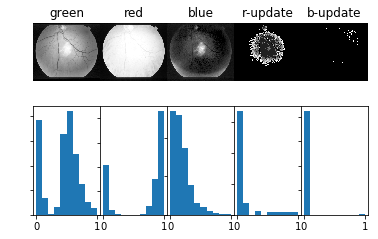



295: Starting on im0301, equalized, 

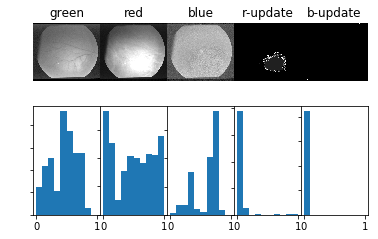



296: Starting on im0302, equalized, 

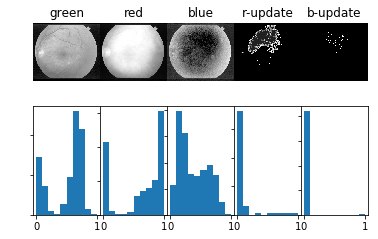



297: Starting on im0303, equalized, 

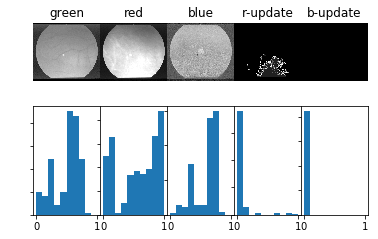



298: Starting on im0304, equalized, 

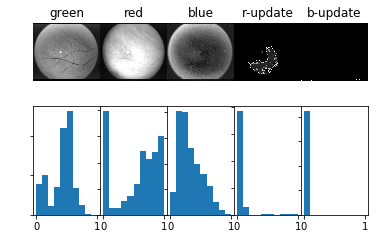



299: Starting on im0305, equalized, 

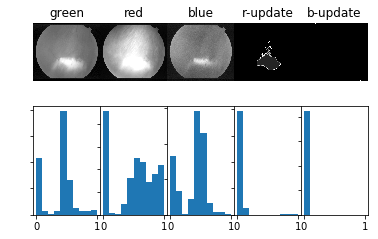



300: Starting on im0306, equalized, 

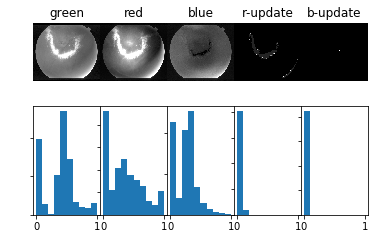



301: Starting on im0307, equalized, 

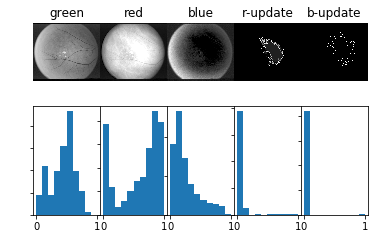



302: Starting on im0308, equalized, 

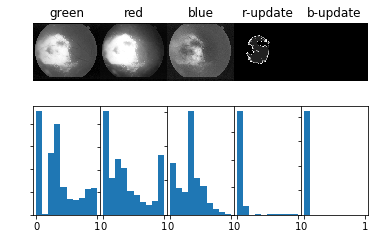



303: Starting on im0309, equalized, 

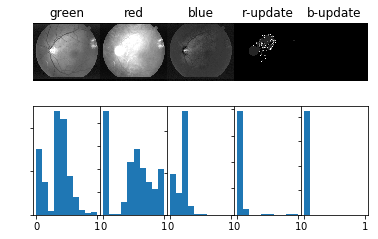



304: Starting on im0310, equalized, 

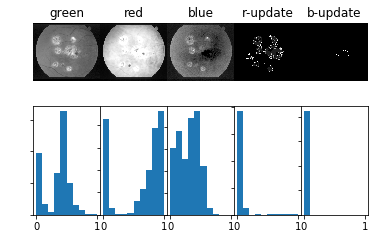



305: Starting on im0311, equalized, 

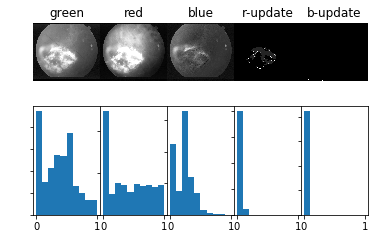



306: Starting on im0312, equalized, 

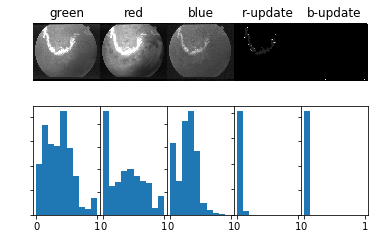



307: Starting on im0313, equalized, 

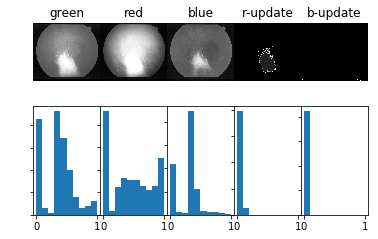



308: Starting on im0314, equalized, 

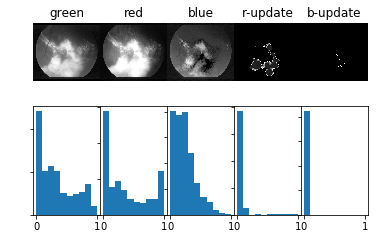



309: Starting on im0315, equalized, 

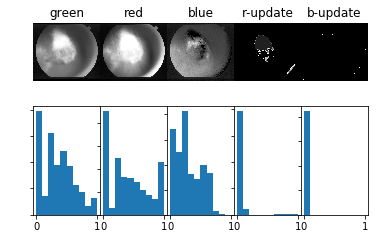



310: Starting on im0316, equalized, 

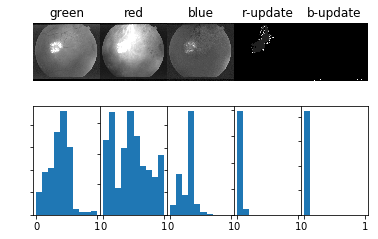



311: Starting on im0317, equalized, 

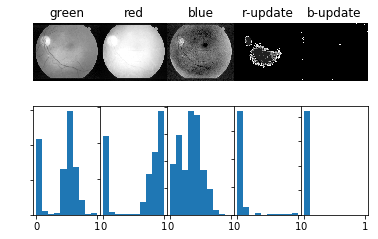



312: Starting on im0318, equalized, 

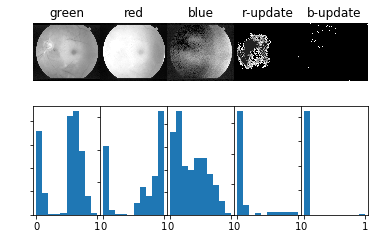



313: Starting on im0319, equalized, 

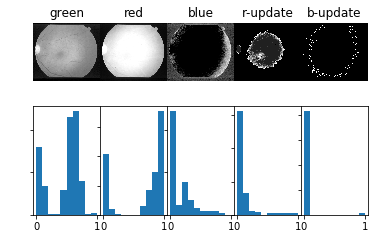



314: Starting on im0320, equalized, 

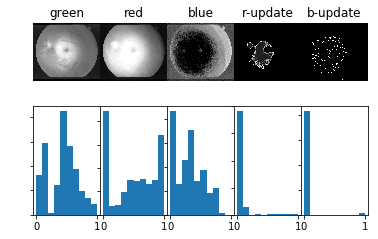



315: Starting on im0321, equalized, 

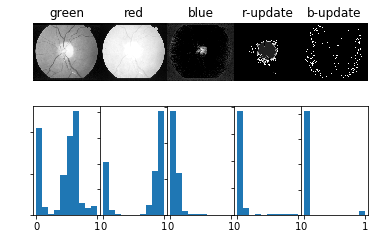



316: Starting on im0322, equalized, 

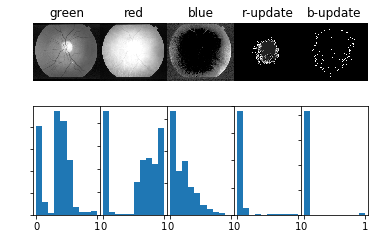



317: Starting on im0323, equalized, 

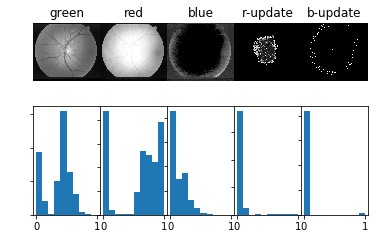



318: Starting on im0324, equalized, 

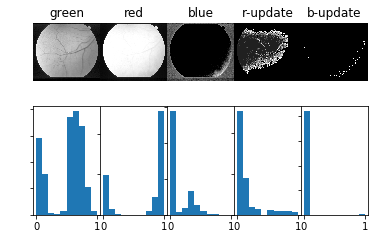



319: Starting on im0325, equalized, 

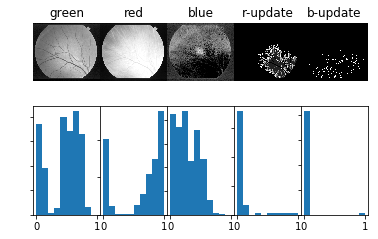



320: Starting on im0326, equalized, 

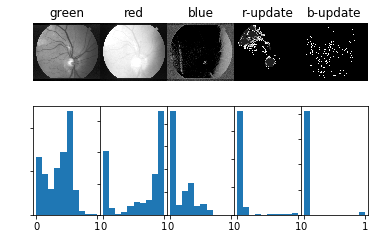



321: Starting on im0327, equalized, 

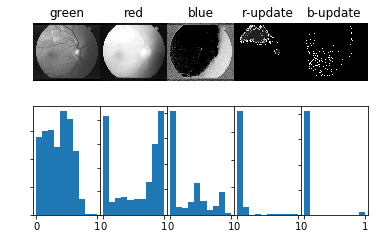



322: Starting on im0328, equalized, 

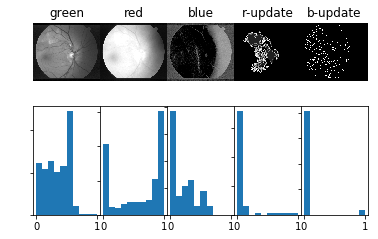



323: Starting on im0329, equalized, 

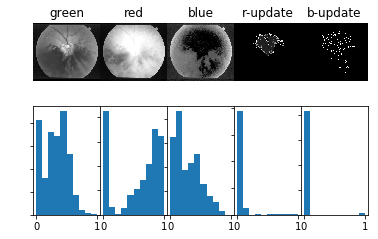



324: Starting on im0330, equalized, 

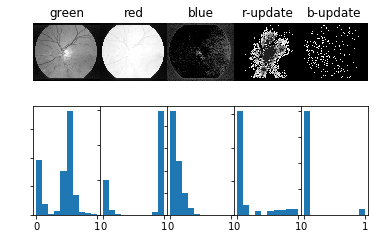



325: Starting on im0331, equalized, 

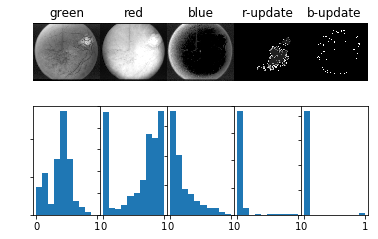



326: Starting on im0332, equalized, 

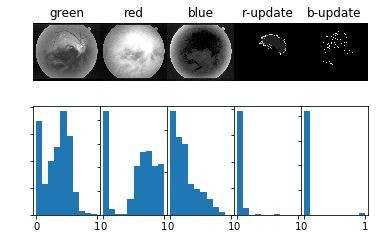



327: Starting on im0333, equalized, 

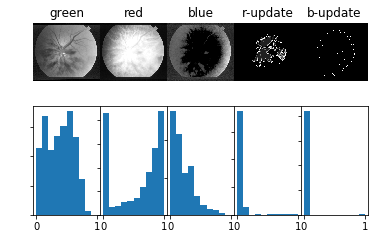



328: Starting on im0334, equalized, 

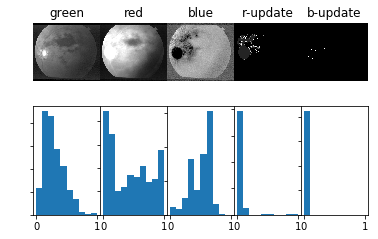



329: Starting on im0335, equalized, 

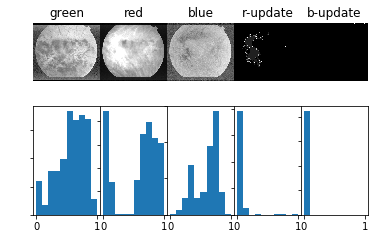



330: Starting on im0336, equalized, 

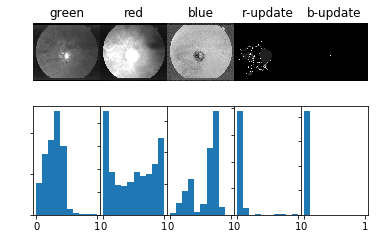



331: Starting on im0337, equalized, 

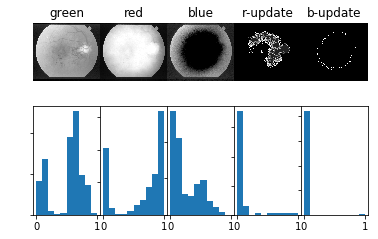



332: Starting on im0338, equalized, 

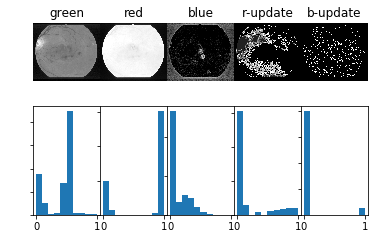



333: Starting on im0339, equalized, 

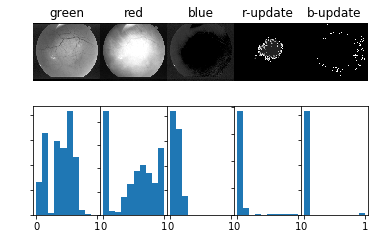



334: Starting on im0340, equalized, 

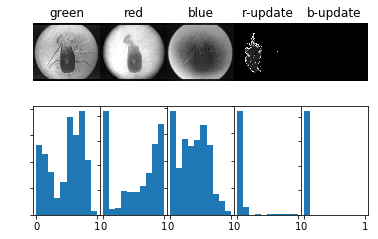



335: Starting on im0341, equalized, 

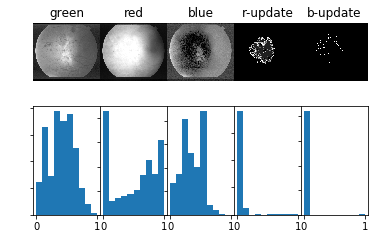



336: Starting on im0342, equalized, 

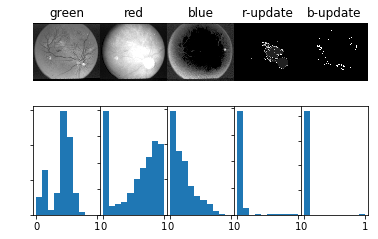



337: Starting on im0343, equalized, 

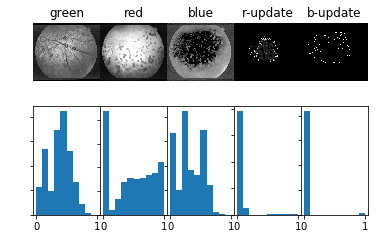



338: Starting on im0344, equalized, 

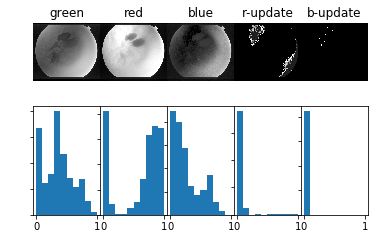



339: Starting on im0345, equalized, 

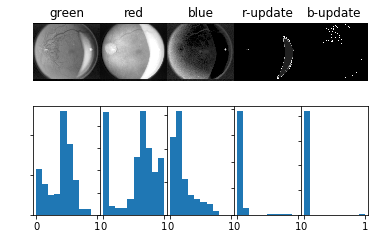



340: Starting on im0346, equalized, 

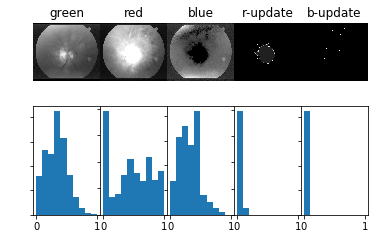



341: Starting on im0347, equalized, 

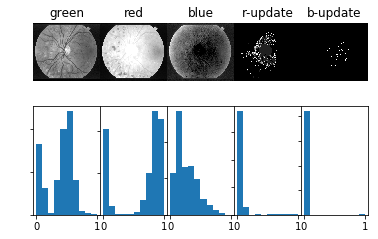



342: Starting on im0348, equalized, 

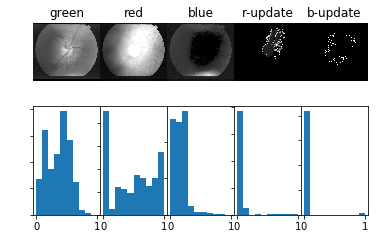



343: Starting on im0349, equalized, 

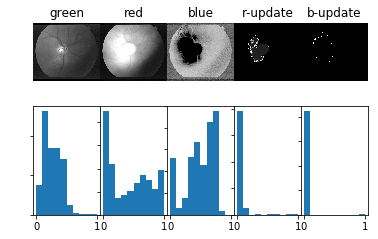



344: Starting on im0350, equalized, 

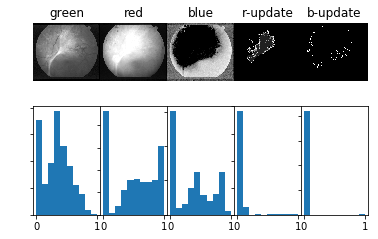



345: Starting on im0351, equalized, 

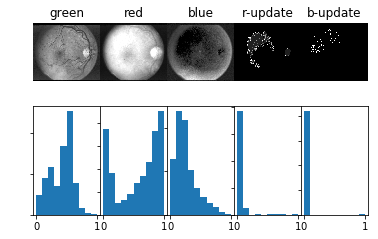



346: Starting on im0352, equalized, 

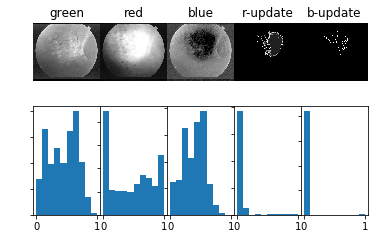



347: Starting on im0353, equalized, 

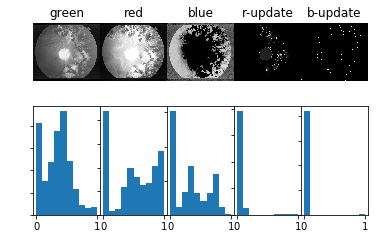



348: Starting on im0354, equalized, 

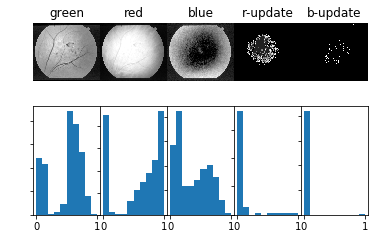



349: Starting on im0355, equalized, 

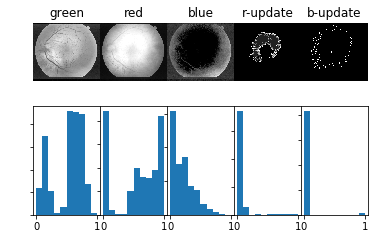



350: Starting on im0356, equalized, 

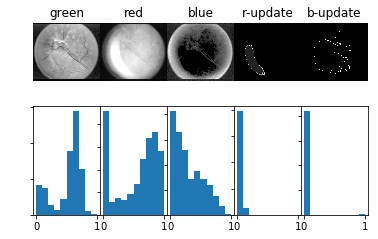



351: Starting on im0357, equalized, 

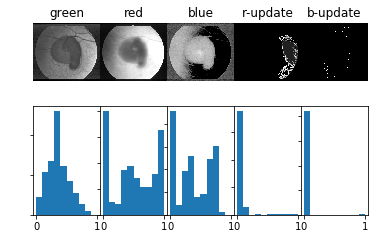



352: Starting on im0358, equalized, 

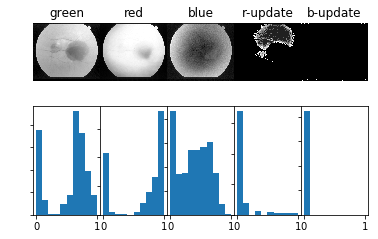



353: Starting on im0359, equalized, 

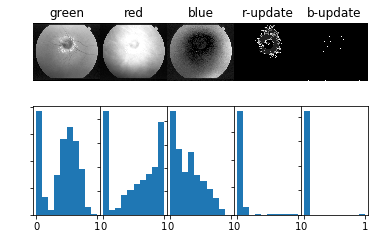



354: Starting on im0360, equalized, 

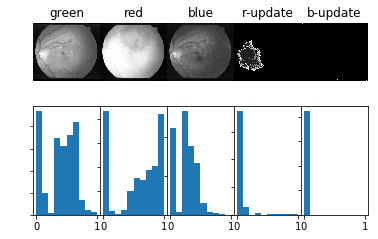



355: Starting on im0361, equalized, 

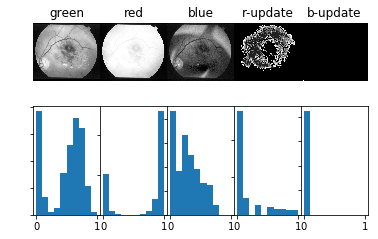



356: Starting on im0362, equalized, 

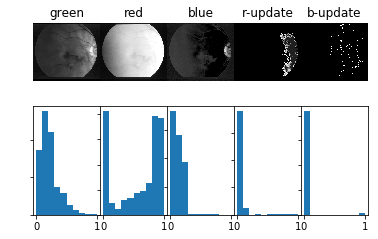



357: Starting on im0363, equalized, 

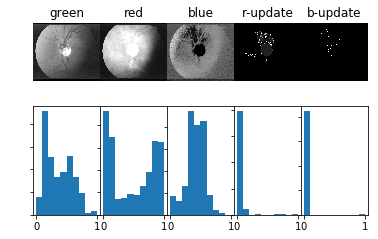



358: Starting on im0364, equalized, 

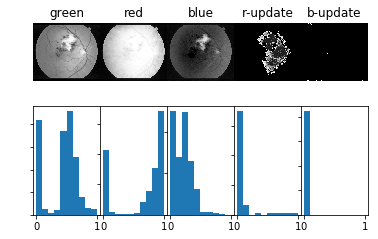



359: Starting on im0365, equalized, 

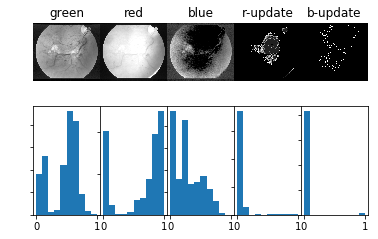



360: Starting on im0366, equalized, 

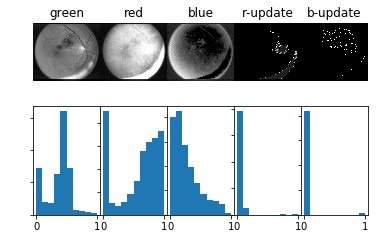



361: Starting on im0367, equalized, 

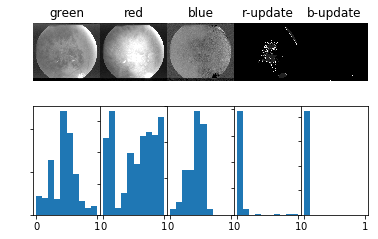



362: Starting on im0368, equalized, 

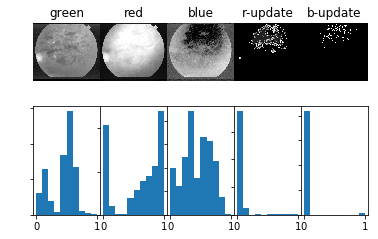



363: Starting on im0369, equalized, 

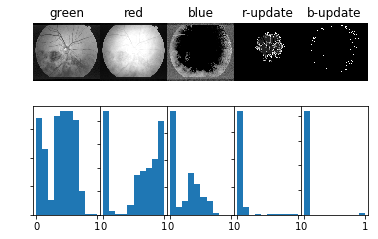



364: Starting on im0370, equalized, 

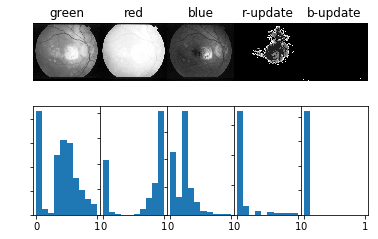



365: Starting on im0371, equalized, 

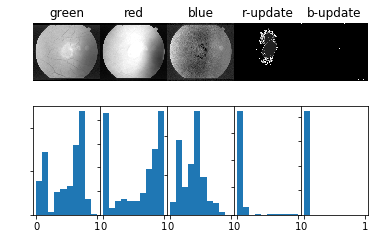



366: Starting on im0372, equalized, 

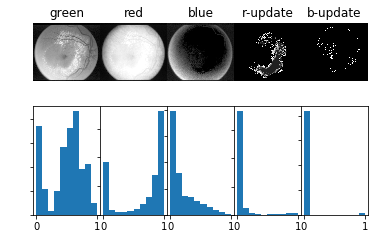



367: Starting on im0373, equalized, 

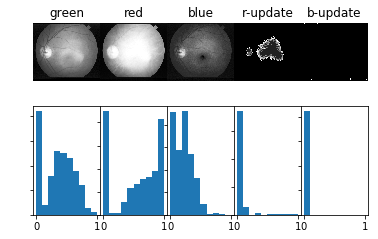



368: Starting on im0374, equalized, 

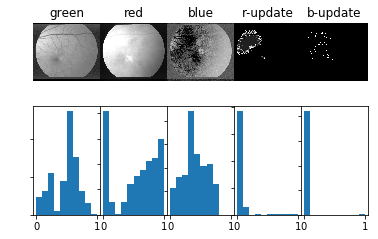



369: Starting on im0375, equalized, 

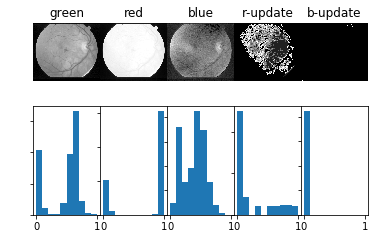



370: Starting on im0376, equalized, 

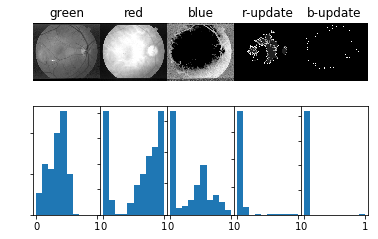



371: Starting on im0377, equalized, 

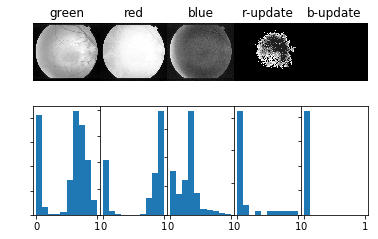



372: Starting on im0378, equalized, 

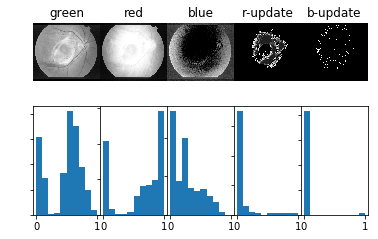



373: Starting on im0379, equalized, 

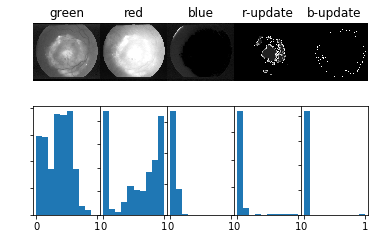



374: Starting on im0380, equalized, 

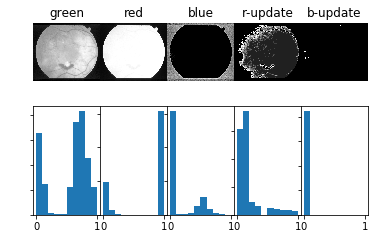



375: Starting on im0381, equalized, 

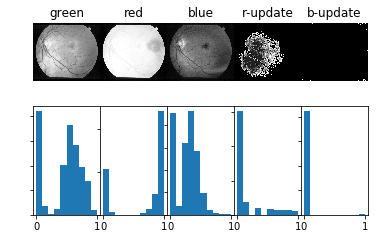



376: Starting on im0382, equalized, 

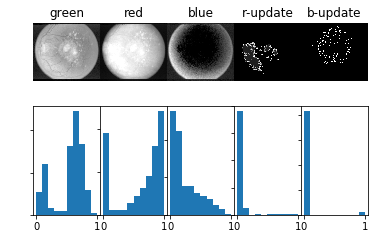



377: Starting on im0383, equalized, 

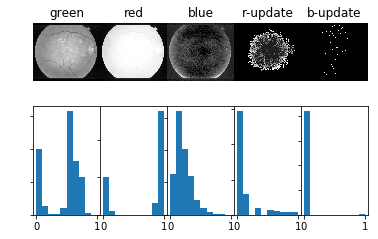



378: Starting on im0384, equalized, 

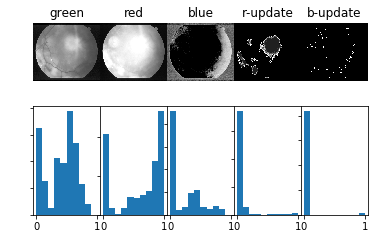



379: Starting on im0385, equalized, 

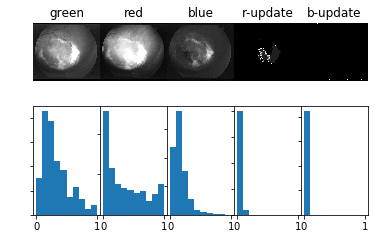



380: Starting on im0386, equalized, 

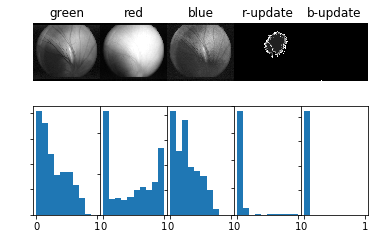



381: Starting on im0387, equalized, 

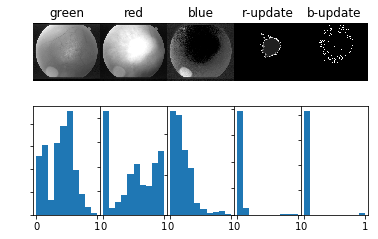



382: Starting on im0388, equalized, 

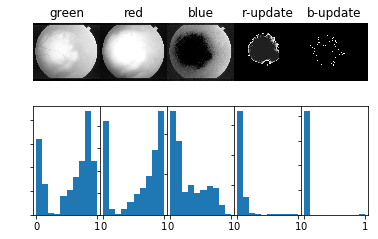



383: Starting on im0389, equalized, 

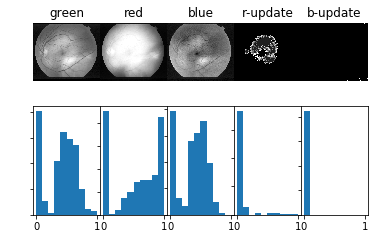



384: Starting on im0390, equalized, 

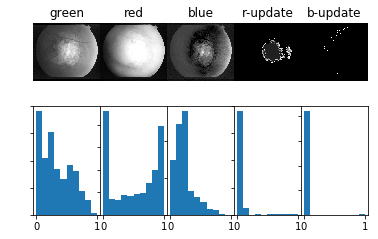



385: Starting on im0391, equalized, 

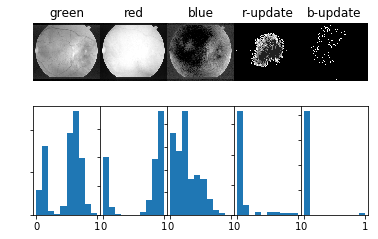



386: Starting on im0392, equalized, 

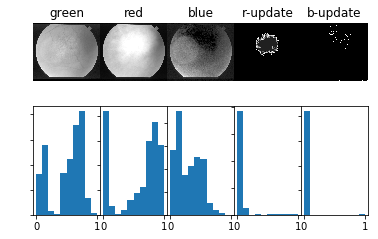



387: Starting on im0393, equalized, 

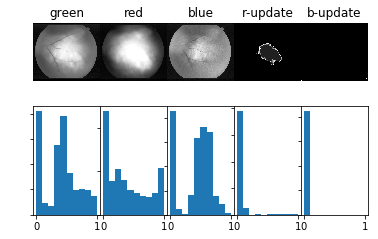



388: Starting on im0394, equalized, 

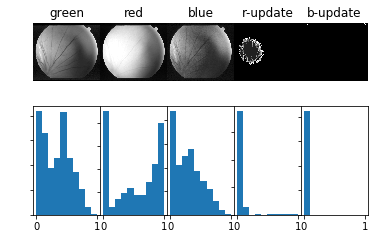



389: Starting on im0395, equalized, 

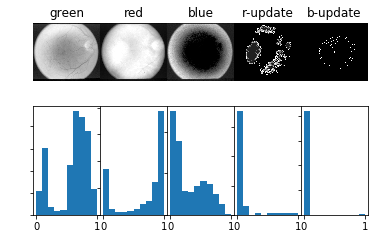



390: Starting on im0396, equalized, 

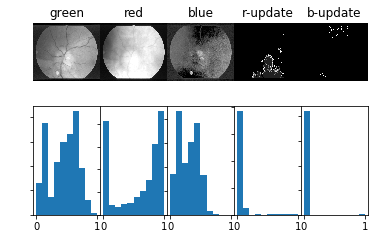



391: Starting on im0397, equalized, 

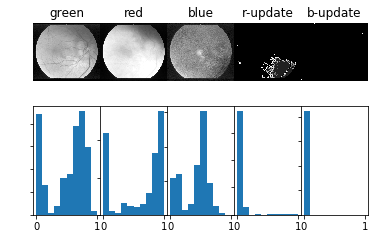



392: Starting on im0398, equalized, 

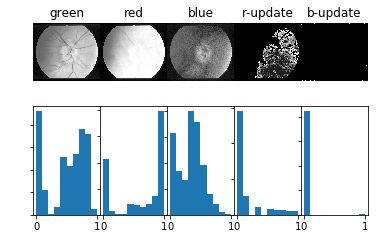



393: Starting on im0399, equalized, 

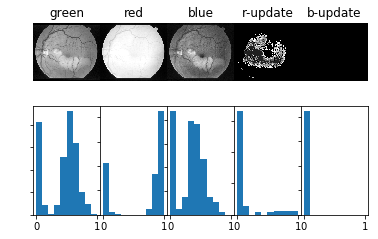



394: Starting on im0400, equalized, 

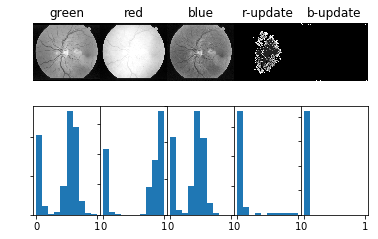



395: Starting on im0401, equalized, 

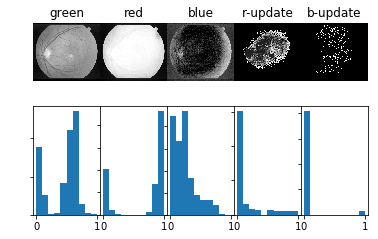



396: Starting on im0402, equalized, 

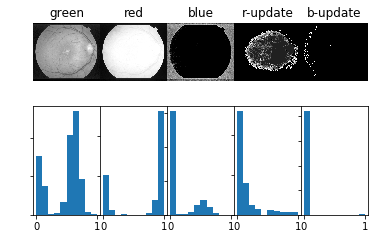

In [4]:
stare_proc.explorer()

0: Starting on im0001, equalized, vessels mapped, colors mapped, combined and saved, 

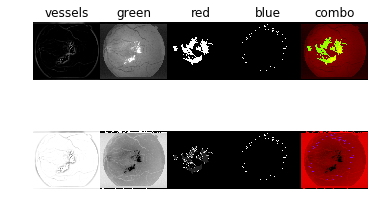



1: Starting on im0002, equalized, vessels mapped, colors mapped, combined and saved, 

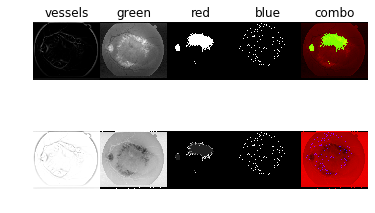



2: Starting on im0003, equalized, vessels mapped, colors mapped, combined and saved, 

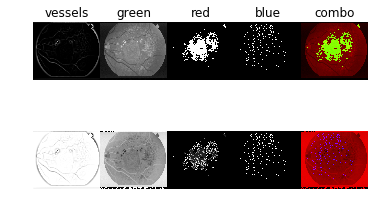



3: Starting on im0004, equalized, vessels mapped, colors mapped, combined and saved, 

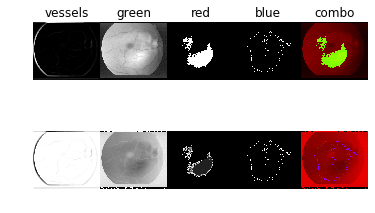



4: Starting on im0005, equalized, vessels mapped, colors mapped, combined and saved, 

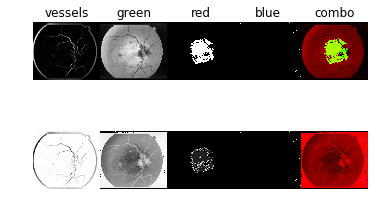



5: Starting on im0006, equalized, vessels mapped, colors mapped, combined and saved, 

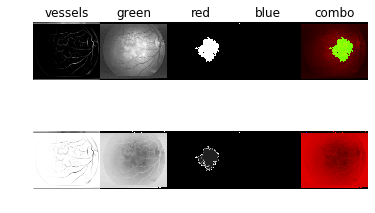



6: Starting on im0007, equalized, vessels mapped, colors mapped, combined and saved, 

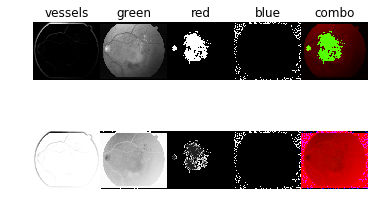



7: Starting on im0008, equalized, vessels mapped, colors mapped, combined and saved, 

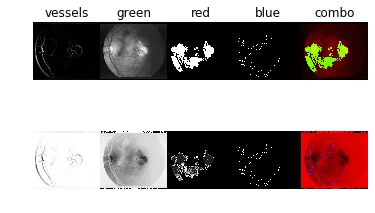



8: Starting on im0009, equalized, vessels mapped, colors mapped, combined and saved, 

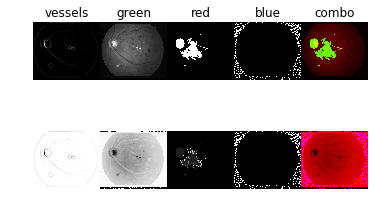



9: Starting on im0010, equalized, vessels mapped, colors mapped, combined and saved, 

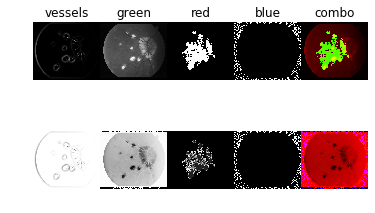



10: Starting on im0011, equalized, vessels mapped, colors mapped, combined and saved, 

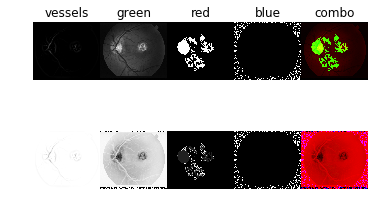



11: Starting on im0012, equalized, vessels mapped, colors mapped, combined and saved, 

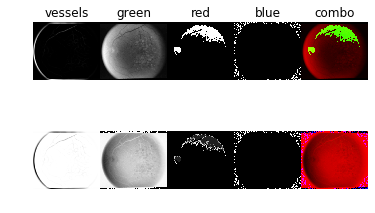



12: Starting on im0013, equalized, vessels mapped, colors mapped, combined and saved, 

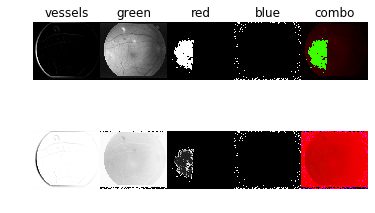



13: Starting on im0014, equalized, vessels mapped, colors mapped, combined and saved, 

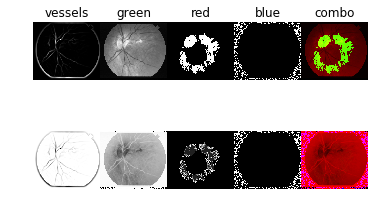



14: Starting on im0015, equalized, vessels mapped, colors mapped, combined and saved, 

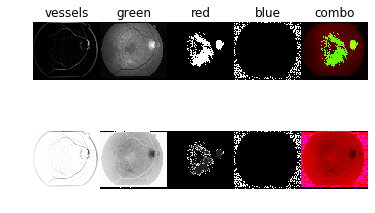



15: Starting on im0016, equalized, vessels mapped, colors mapped, combined and saved, 

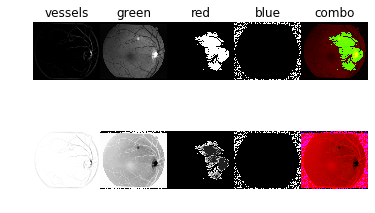



16: Starting on im0017, equalized, vessels mapped, colors mapped, combined and saved, 

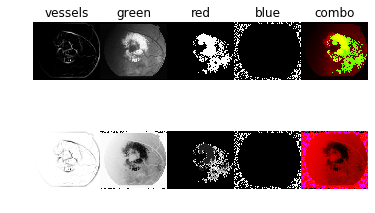



17: Starting on im0018, equalized, vessels mapped, colors mapped, combined and saved, 

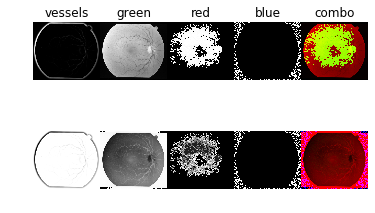



18: Starting on im0019, equalized, vessels mapped, colors mapped, combined and saved, 

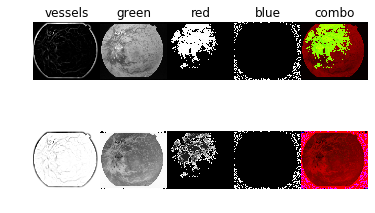



19: Starting on im0020, equalized, vessels mapped, colors mapped, combined and saved, 

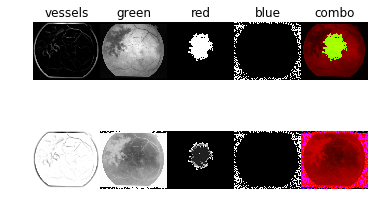



20: Starting on im0021, equalized, vessels mapped, colors mapped, combined and saved, 

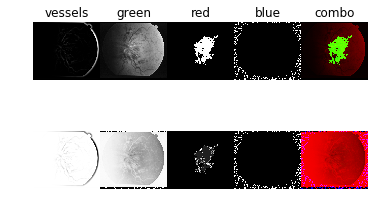



21: Starting on im0022, equalized, vessels mapped, colors mapped, combined and saved, 

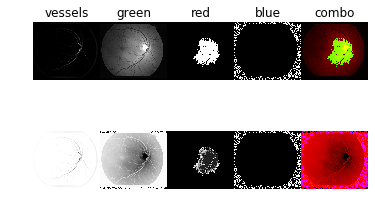



22: Starting on im0023, equalized, vessels mapped, colors mapped, combined and saved, 

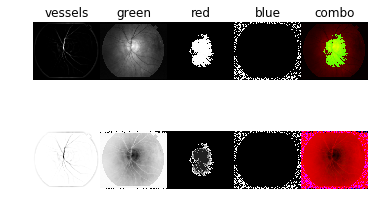



23: Starting on im0024, equalized, vessels mapped, colors mapped, combined and saved, 

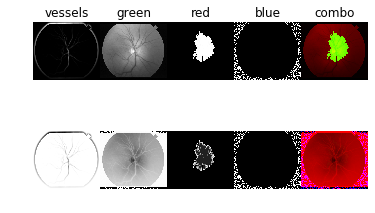



24: Starting on im0025, equalized, vessels mapped, colors mapped, combined and saved, 

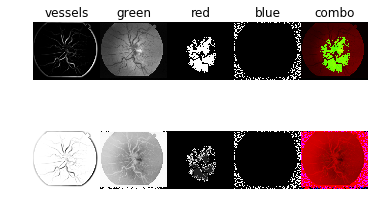



25: Starting on im0026, equalized, vessels mapped, colors mapped, combined and saved, 

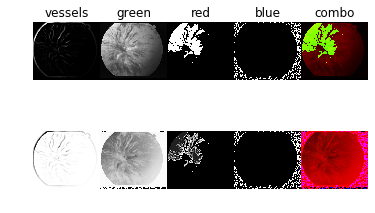



26: Starting on im0027, equalized, vessels mapped, colors mapped, combined and saved, 

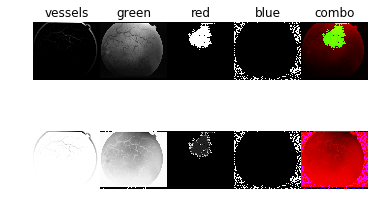



27: Starting on im0028, equalized, vessels mapped, colors mapped, combined and saved, 

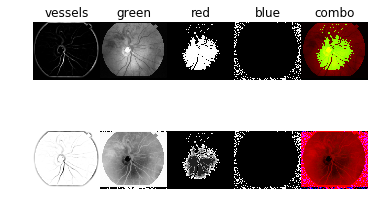



28: Starting on im0029, equalized, vessels mapped, colors mapped, combined and saved, 

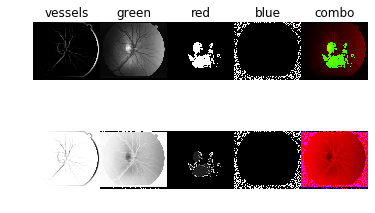



29: Starting on im0030, equalized, vessels mapped, colors mapped, combined and saved, 

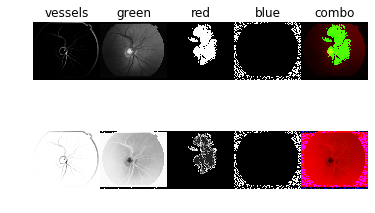



30: Starting on im0031, equalized, vessels mapped, colors mapped, combined and saved, 

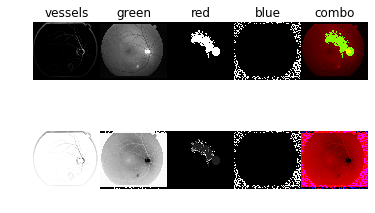



31: Starting on im0032, equalized, vessels mapped, colors mapped, combined and saved, 

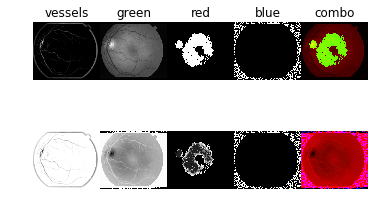



32: Starting on im0033, equalized, vessels mapped, colors mapped, combined and saved, 

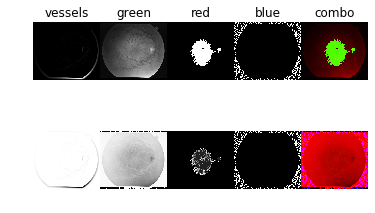



33: Starting on im0034, equalized, vessels mapped, colors mapped, combined and saved, 

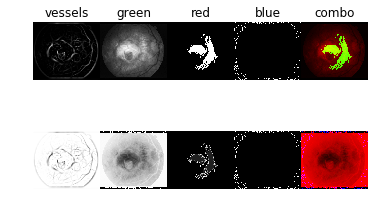



34: Starting on im0035, equalized, vessels mapped, colors mapped, combined and saved, 

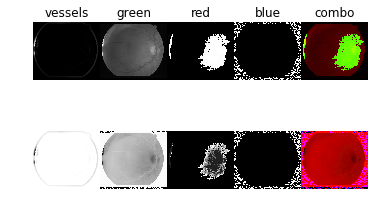



35: Starting on im0036, equalized, vessels mapped, colors mapped, combined and saved, 

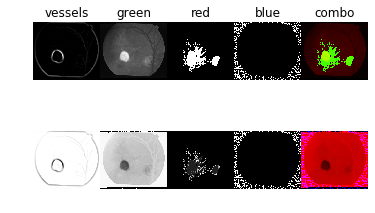



36: Starting on im0037, equalized, vessels mapped, colors mapped, combined and saved, 

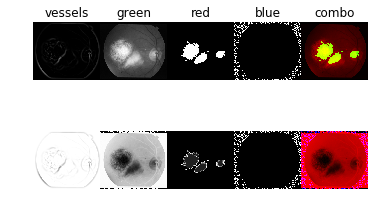



37: Starting on im0038, equalized, vessels mapped, colors mapped, combined and saved, 

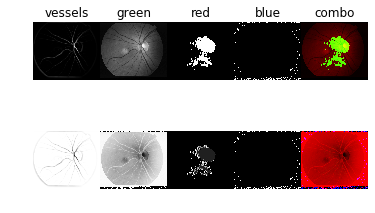



38: Starting on im0039, equalized, vessels mapped, colors mapped, combined and saved, 

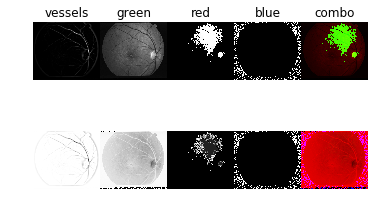



39: Starting on im0040, equalized, vessels mapped, colors mapped, combined and saved, 

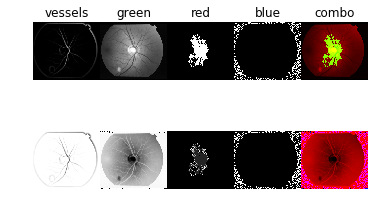



40: Starting on im0041, equalized, vessels mapped, colors mapped, combined and saved, 

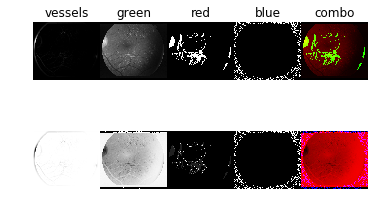



41: Starting on im0042, equalized, vessels mapped, colors mapped, combined and saved, 

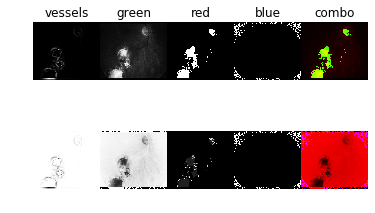



42: Starting on im0043, equalized, vessels mapped, colors mapped, combined and saved, 

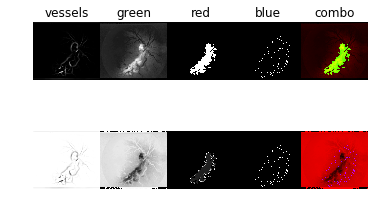



43: Starting on im0044, equalized, vessels mapped, colors mapped, combined and saved, 

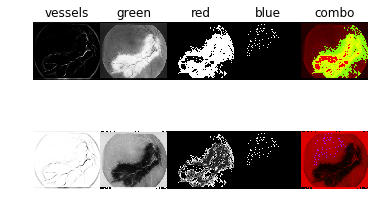



44: Starting on im0045, equalized, vessels mapped, colors mapped, combined and saved, 

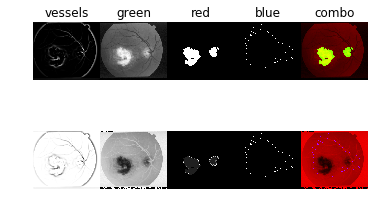



45: Starting on im0046, equalized, vessels mapped, colors mapped, combined and saved, 

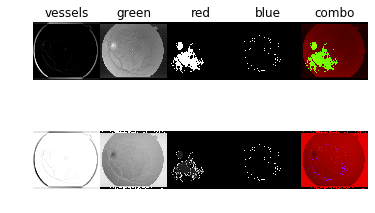



46: Starting on im0048, equalized, vessels mapped, colors mapped, combined and saved, 

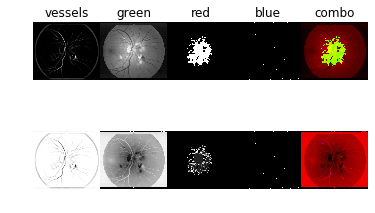



47: Starting on im0049, equalized, vessels mapped, colors mapped, combined and saved, 

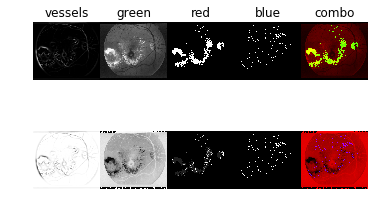



48: Starting on im0050, equalized, vessels mapped, colors mapped, combined and saved, 

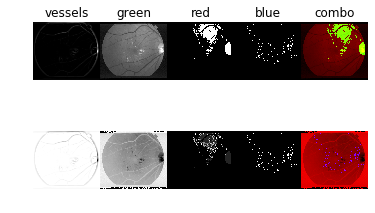



49: Starting on im0051, equalized, vessels mapped, colors mapped, combined and saved, 

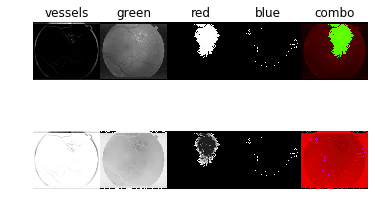



50: Starting on im0052, equalized, vessels mapped, colors mapped, combined and saved, 

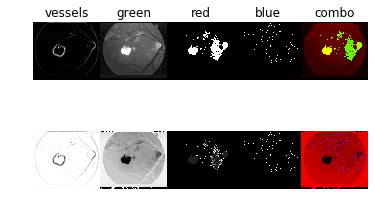



51: Starting on im0053, equalized, vessels mapped, colors mapped, combined and saved, 

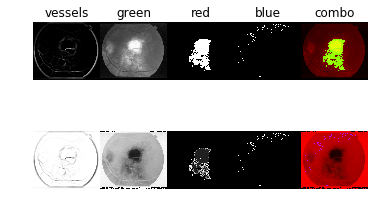



52: Starting on im0054, equalized, vessels mapped, colors mapped, combined and saved, 

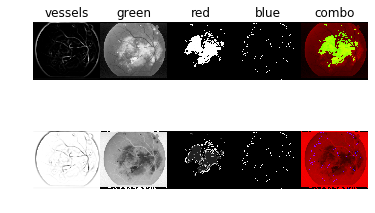



53: Starting on im0055, equalized, vessels mapped, colors mapped, combined and saved, 

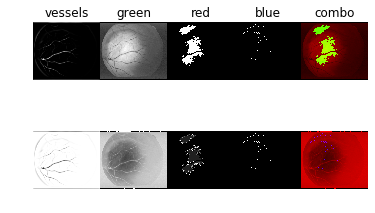



54: Starting on im0056, equalized, vessels mapped, colors mapped, combined and saved, 

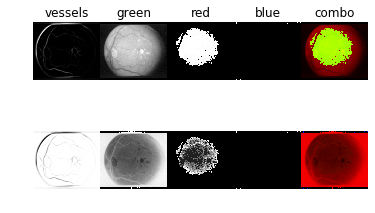



55: Starting on im0057, equalized, vessels mapped, colors mapped, combined and saved, 

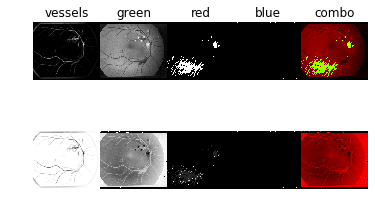



56: Starting on im0058, equalized, vessels mapped, colors mapped, combined and saved, 

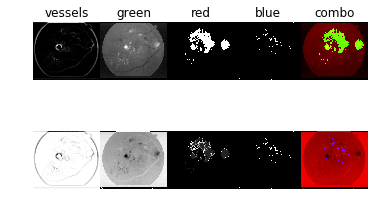



57: Starting on im0059, equalized, vessels mapped, colors mapped, combined and saved, 

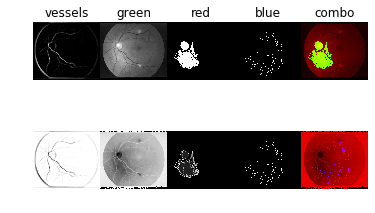



58: Starting on im0060, equalized, vessels mapped, colors mapped, combined and saved, 

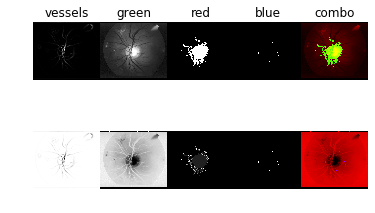



59: Starting on im0061, equalized, vessels mapped, colors mapped, combined and saved, 

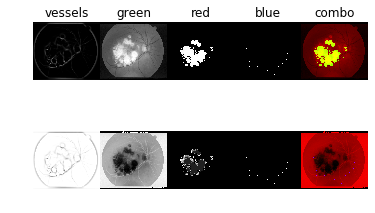



60: Starting on im0062, equalized, vessels mapped, colors mapped, combined and saved, 

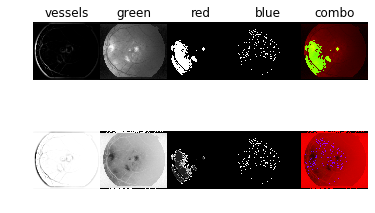



61: Starting on im0063, equalized, vessels mapped, colors mapped, combined and saved, 

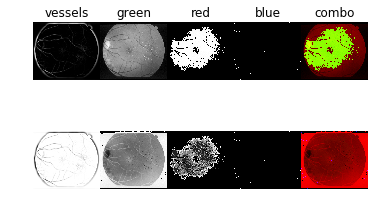



62: Starting on im0064, equalized, vessels mapped, colors mapped, combined and saved, 

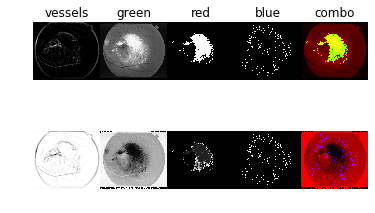



63: Starting on im0065, equalized, vessels mapped, colors mapped, combined and saved, 

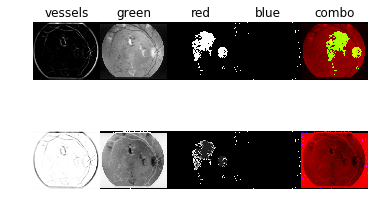



64: Starting on im0066, equalized, vessels mapped, colors mapped, combined and saved, 

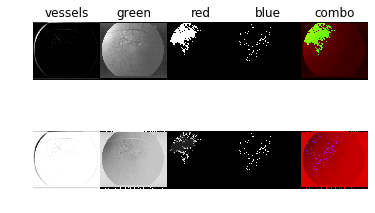



65: Starting on im0067, equalized, vessels mapped, colors mapped, combined and saved, 

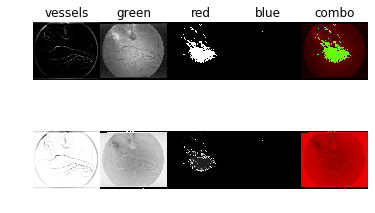



66: Starting on im0068, equalized, vessels mapped, colors mapped, combined and saved, 

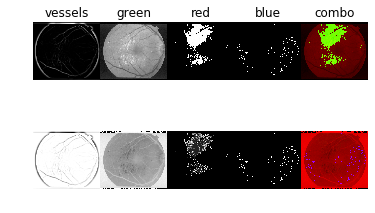



67: Starting on im0069, equalized, vessels mapped, colors mapped, combined and saved, 

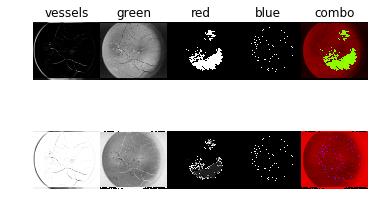



68: Starting on im0070, equalized, vessels mapped, colors mapped, combined and saved, 

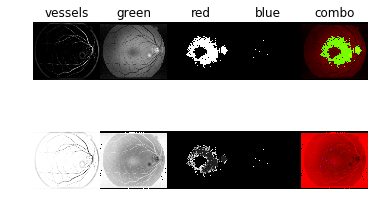



69: Starting on im0071, equalized, vessels mapped, colors mapped, combined and saved, 

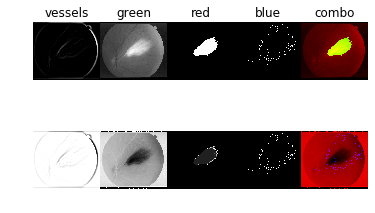



70: Starting on im0072, equalized, vessels mapped, colors mapped, combined and saved, 

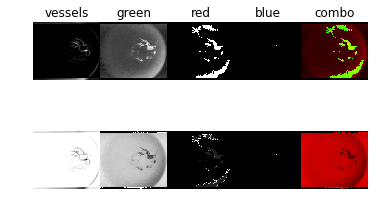



71: Starting on im0073, equalized, vessels mapped, colors mapped, combined and saved, 

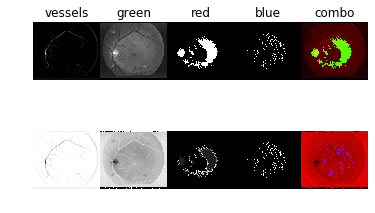



72: Starting on im0074, equalized, vessels mapped, colors mapped, combined and saved, 

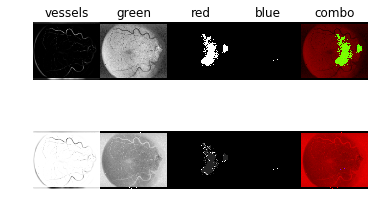



73: Starting on im0075, equalized, vessels mapped, colors mapped, combined and saved, 

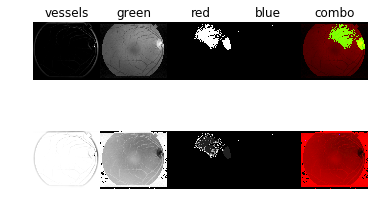



74: Starting on im0076, equalized, vessels mapped, colors mapped, combined and saved, 

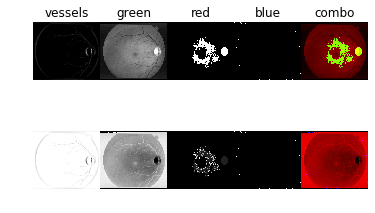



75: Starting on im0077, equalized, vessels mapped, colors mapped, combined and saved, 

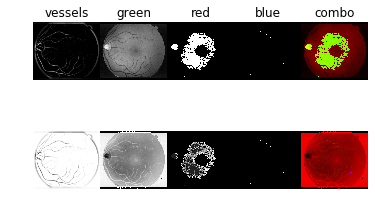



76: Starting on im0078, equalized, vessels mapped, colors mapped, combined and saved, 

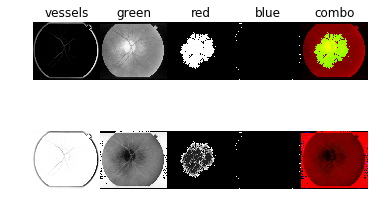



77: Starting on im0079, equalized, vessels mapped, colors mapped, combined and saved, 

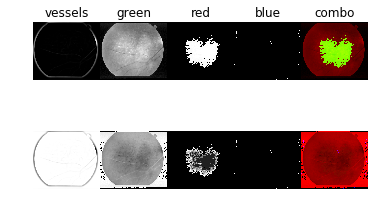



78: Starting on im0080, equalized, vessels mapped, colors mapped, combined and saved, 

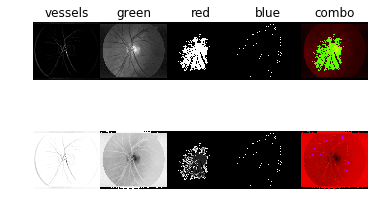



79: Starting on im0081, equalized, vessels mapped, colors mapped, combined and saved, 

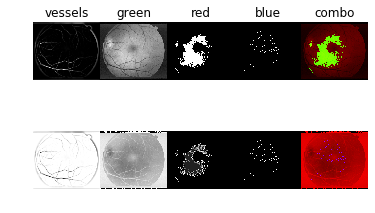



80: Starting on im0082, equalized, vessels mapped, colors mapped, combined and saved, 

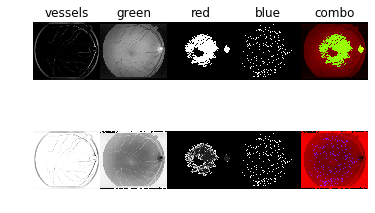



81: Starting on im0083, equalized, vessels mapped, colors mapped, combined and saved, 

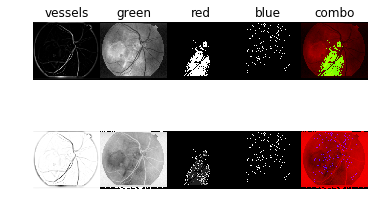



82: Starting on im0084, equalized, vessels mapped, colors mapped, combined and saved, 

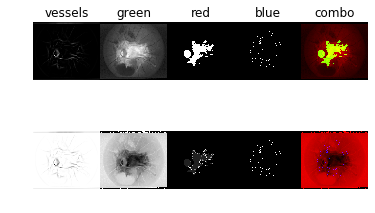



83: Starting on im0085, equalized, vessels mapped, colors mapped, combined and saved, 

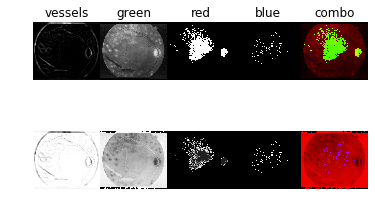



84: Starting on im0086, equalized, vessels mapped, colors mapped, combined and saved, 

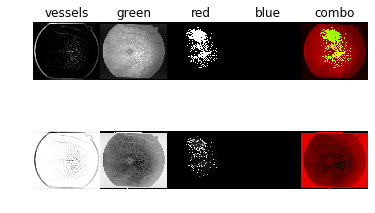



85: Starting on im0087, equalized, vessels mapped, colors mapped, combined and saved, 

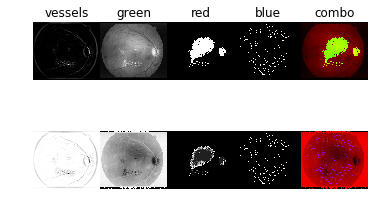



86: Starting on im0088, equalized, vessels mapped, colors mapped, combined and saved, 

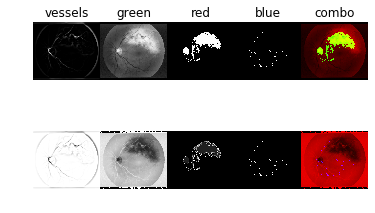



87: Starting on im0089, equalized, vessels mapped, colors mapped, combined and saved, 

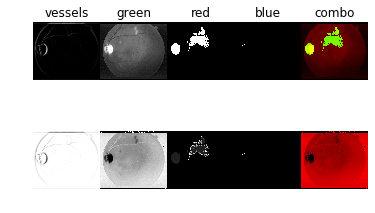



88: Starting on im0090, equalized, vessels mapped, colors mapped, combined and saved, 

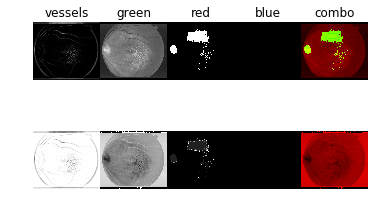



89: Starting on im0091, equalized, vessels mapped, colors mapped, combined and saved, 

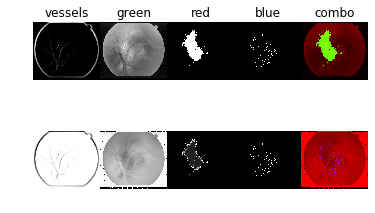



90: Starting on im0092, equalized, vessels mapped, colors mapped, combined and saved, 

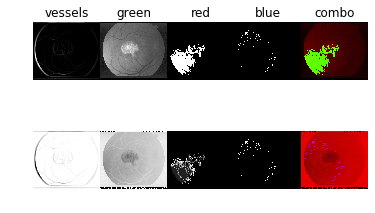



91: Starting on im0093, equalized, vessels mapped, colors mapped, combined and saved, 

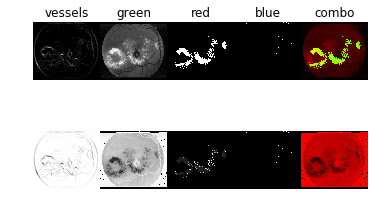



92: Starting on im0094, equalized, vessels mapped, colors mapped, combined and saved, 

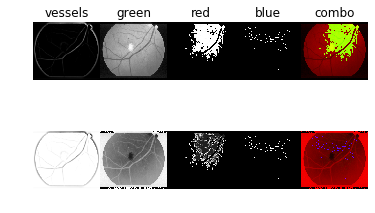



93: Starting on im0095, equalized, vessels mapped, colors mapped, combined and saved, 

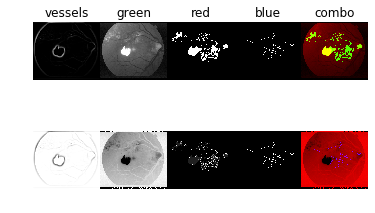



94: Starting on im0096, equalized, vessels mapped, colors mapped, combined and saved, 

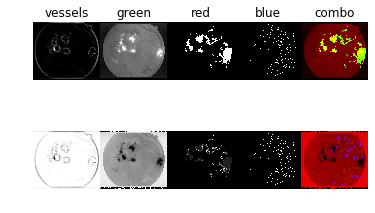



95: Starting on im0097, equalized, vessels mapped, colors mapped, combined and saved, 

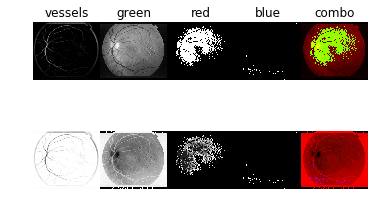



96: Starting on im0098, equalized, vessels mapped, colors mapped, combined and saved, 

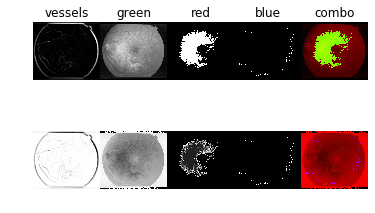



97: Starting on im0099, equalized, vessels mapped, colors mapped, combined and saved, 

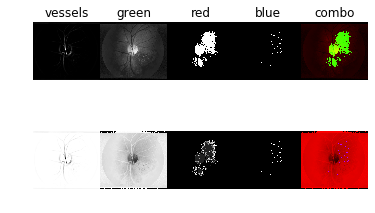



98: Starting on im0100, equalized, vessels mapped, colors mapped, combined and saved, 

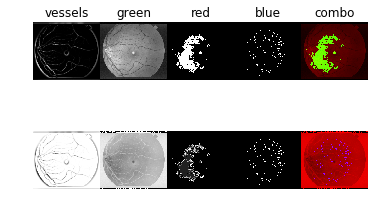



99: Starting on im0101, equalized, vessels mapped, colors mapped, combined and saved, 

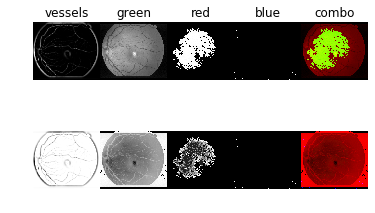



100: Starting on im0102, equalized, vessels mapped, colors mapped, combined and saved, 

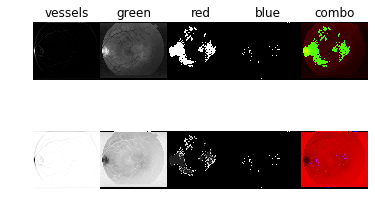



101: Starting on im0103, equalized, vessels mapped, colors mapped, combined and saved, 

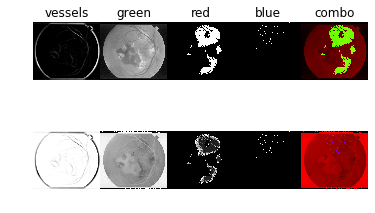



102: Starting on im0104, equalized, vessels mapped, colors mapped, combined and saved, 

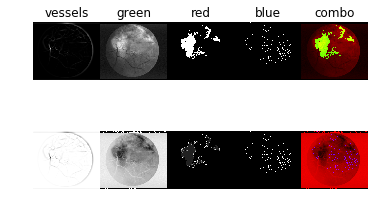



103: Starting on im0105, equalized, vessels mapped, colors mapped, combined and saved, 

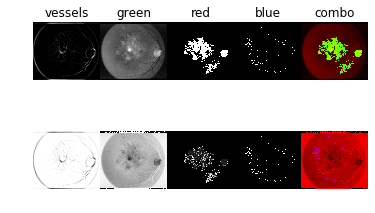



104: Starting on im0106, equalized, vessels mapped, colors mapped, combined and saved, 

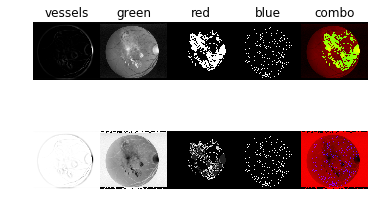



105: Starting on im0107, equalized, vessels mapped, colors mapped, combined and saved, 

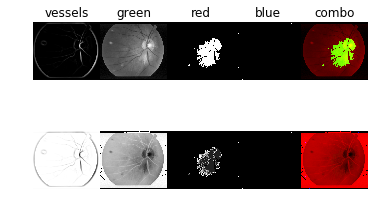



106: Starting on im0110, equalized, vessels mapped, colors mapped, combined and saved, 

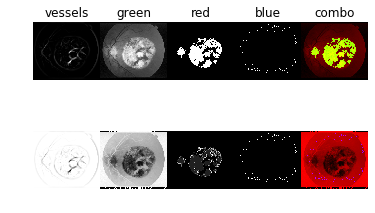



107: Starting on im0111, equalized, vessels mapped, colors mapped, combined and saved, 

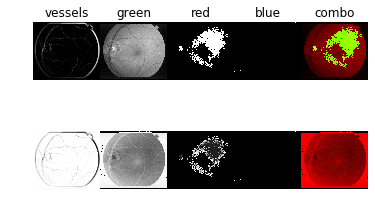



108: Starting on im0112, equalized, vessels mapped, colors mapped, combined and saved, 

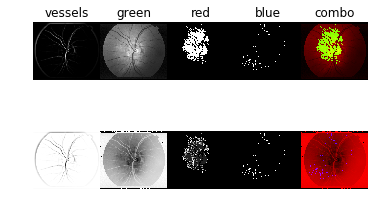



109: Starting on im0113, equalized, vessels mapped, colors mapped, combined and saved, 

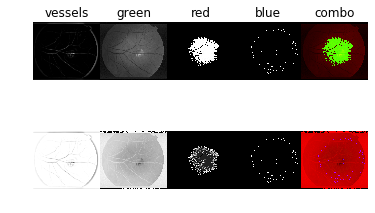



110: Starting on im0114, equalized, vessels mapped, colors mapped, combined and saved, 

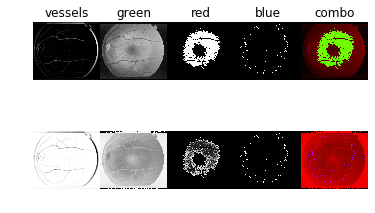



111: Starting on im0115, equalized, vessels mapped, colors mapped, combined and saved, 

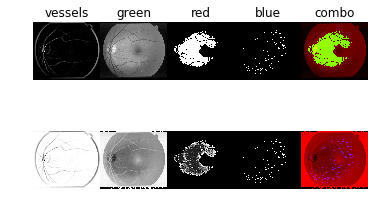



112: Starting on im0116, equalized, vessels mapped, colors mapped, combined and saved, 

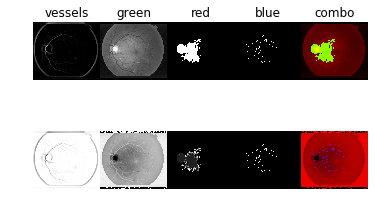



113: Starting on im0117, equalized, vessels mapped, colors mapped, combined and saved, 

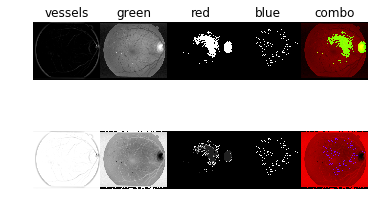



114: Starting on im0118, equalized, vessels mapped, colors mapped, combined and saved, 

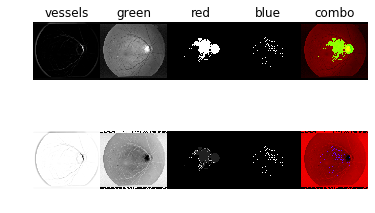



115: Starting on im0119, equalized, vessels mapped, colors mapped, combined and saved, 

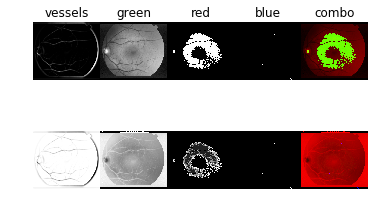



116: Starting on im0120, equalized, vessels mapped, colors mapped, combined and saved, 

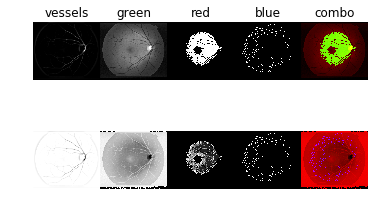



117: Starting on im0121, equalized, vessels mapped, colors mapped, combined and saved, 

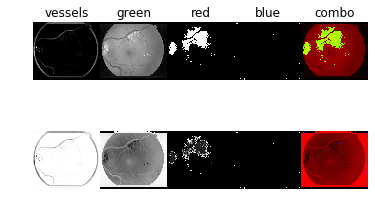



118: Starting on im0122, equalized, vessels mapped, colors mapped, combined and saved, 

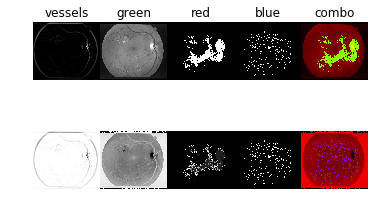



119: Starting on im0123, equalized, vessels mapped, colors mapped, combined and saved, 

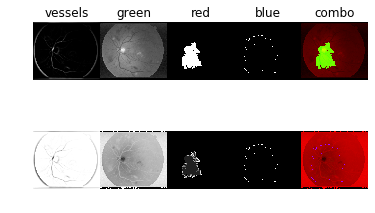



120: Starting on im0124, equalized, vessels mapped, colors mapped, combined and saved, 

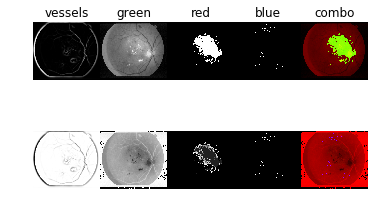



121: Starting on im0125, equalized, vessels mapped, colors mapped, combined and saved, 

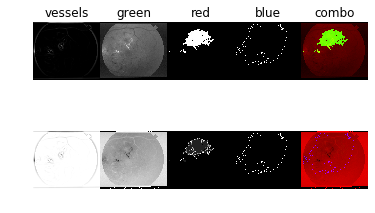



122: Starting on im0126, equalized, vessels mapped, colors mapped, combined and saved, 

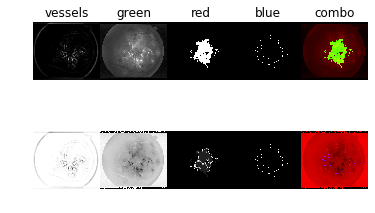



123: Starting on im0127, equalized, vessels mapped, colors mapped, combined and saved, 

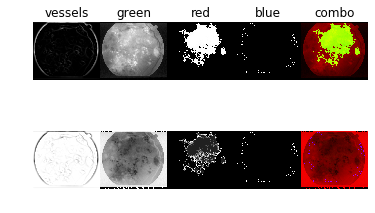



124: Starting on im0128, equalized, vessels mapped, colors mapped, combined and saved, 

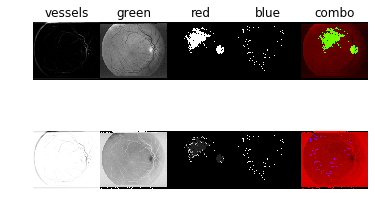



125: Starting on im0129, equalized, vessels mapped, colors mapped, combined and saved, 

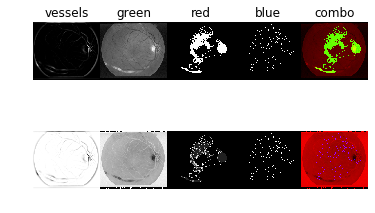



126: Starting on im0130, equalized, vessels mapped, colors mapped, combined and saved, 

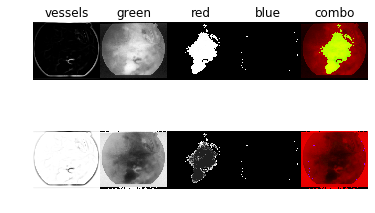



127: Starting on im0131, equalized, vessels mapped, colors mapped, combined and saved, 

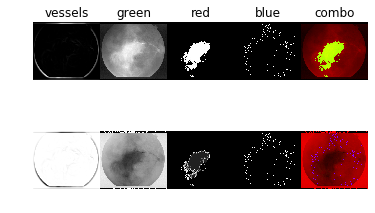



128: Starting on im0132, equalized, vessels mapped, colors mapped, combined and saved, 

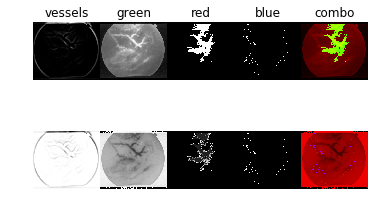



129: Starting on im0133, equalized, vessels mapped, colors mapped, combined and saved, 

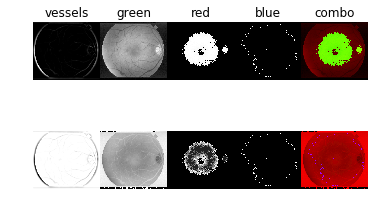



130: Starting on im0134, equalized, vessels mapped, colors mapped, combined and saved, 

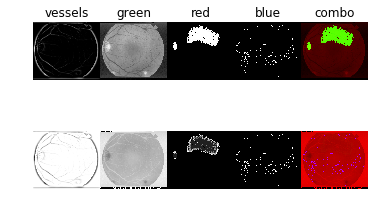



131: Starting on im0135, equalized, vessels mapped, colors mapped, combined and saved, 

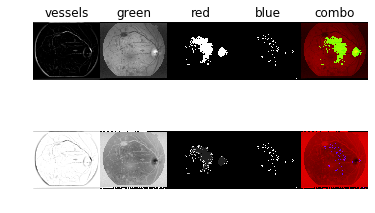



132: Starting on im0136, equalized, vessels mapped, colors mapped, combined and saved, 

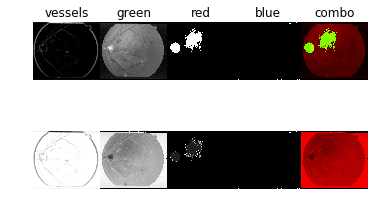



133: Starting on im0137, equalized, vessels mapped, colors mapped, combined and saved, 

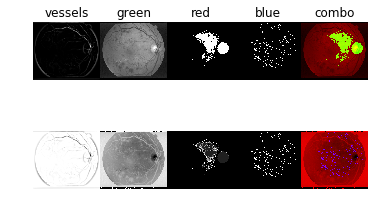



134: Starting on im0138, equalized, vessels mapped, colors mapped, combined and saved, 

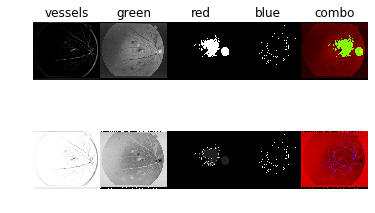



135: Starting on im0139, equalized, vessels mapped, colors mapped, combined and saved, 

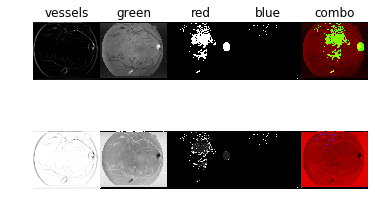



136: Starting on im0140, equalized, vessels mapped, colors mapped, combined and saved, 

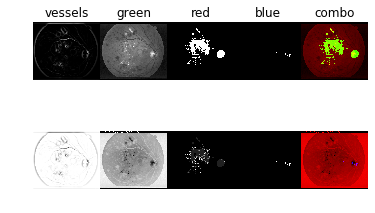



137: Starting on im0141, equalized, vessels mapped, colors mapped, combined and saved, 

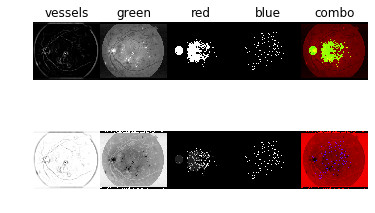



138: Starting on im0142, equalized, vessels mapped, colors mapped, combined and saved, 

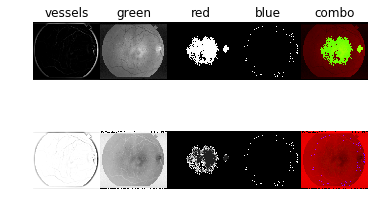



139: Starting on im0143, equalized, vessels mapped, colors mapped, combined and saved, 

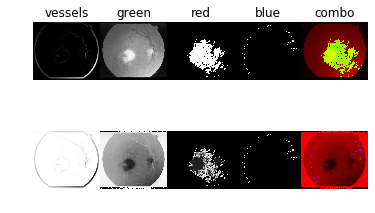



140: Starting on im0145, equalized, vessels mapped, colors mapped, combined and saved, 

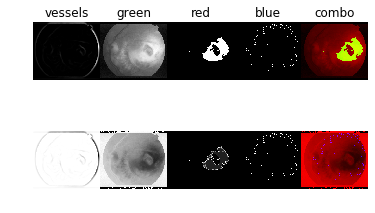



141: Starting on im0146, equalized, vessels mapped, colors mapped, combined and saved, 

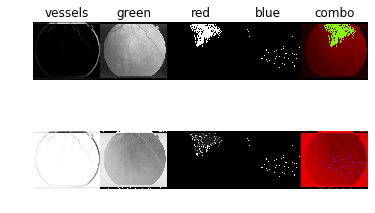



142: Starting on im0147, equalized, vessels mapped, colors mapped, combined and saved, 

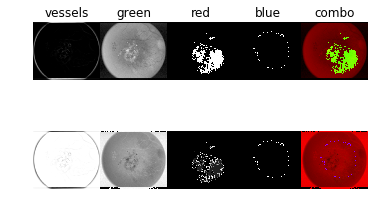



143: Starting on im0148, equalized, vessels mapped, colors mapped, combined and saved, 

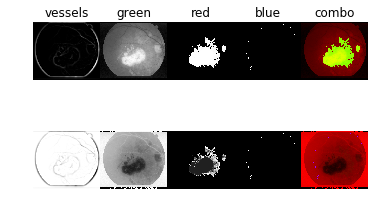



144: Starting on im0149, equalized, vessels mapped, colors mapped, combined and saved, 

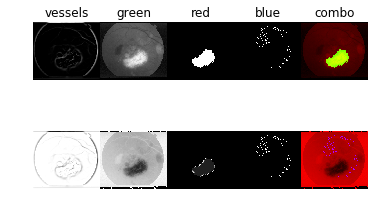



145: Starting on im0150, equalized, vessels mapped, colors mapped, combined and saved, 

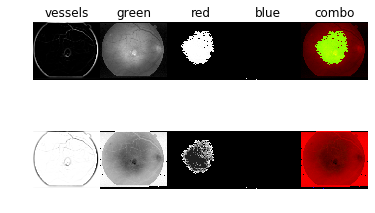



146: Starting on im0151, equalized, vessels mapped, colors mapped, combined and saved, 

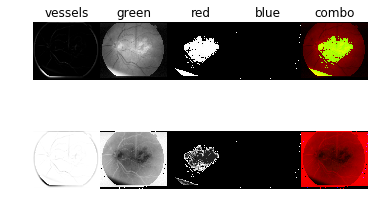



147: Starting on im0152, equalized, vessels mapped, colors mapped, combined and saved, 

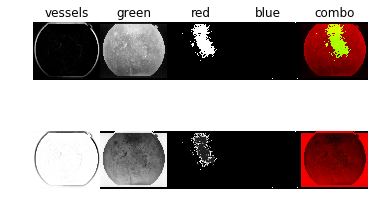



148: Starting on im0153, equalized, vessels mapped, colors mapped, combined and saved, 

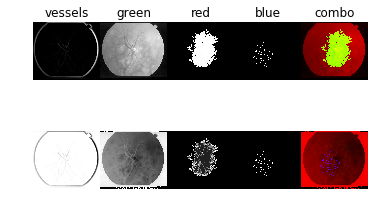



149: Starting on im0154, equalized, vessels mapped, colors mapped, combined and saved, 

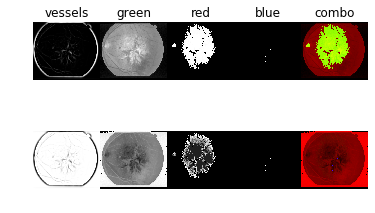



150: Starting on im0155, equalized, vessels mapped, colors mapped, combined and saved, 

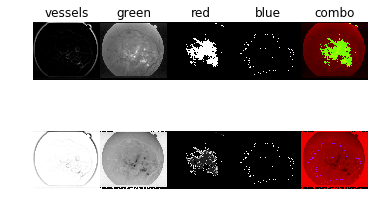



151: Starting on im0156, equalized, vessels mapped, colors mapped, combined and saved, 

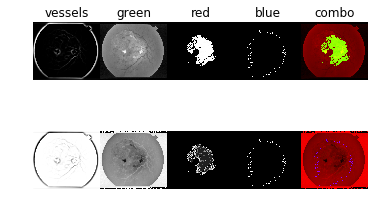



152: Starting on im0157, equalized, vessels mapped, colors mapped, combined and saved, 

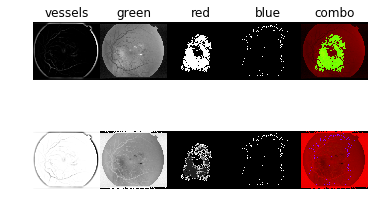



153: Starting on im0158, equalized, vessels mapped, colors mapped, combined and saved, 

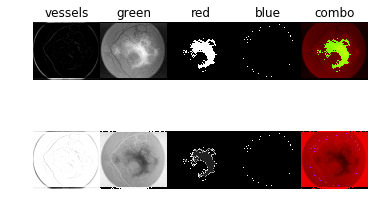



154: Starting on im0159, equalized, vessels mapped, colors mapped, combined and saved, 

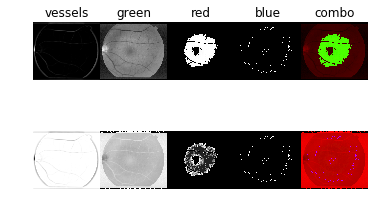



155: Starting on im0160, equalized, vessels mapped, colors mapped, combined and saved, 

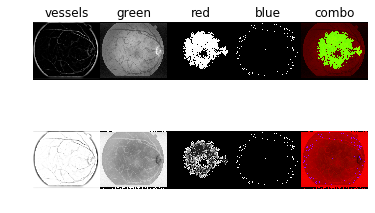



156: Starting on im0161, equalized, vessels mapped, colors mapped, combined and saved, 

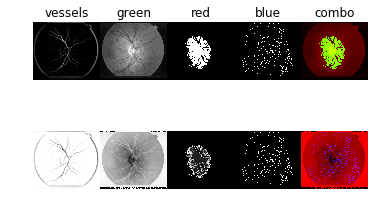



157: Starting on im0162, equalized, vessels mapped, colors mapped, combined and saved, 

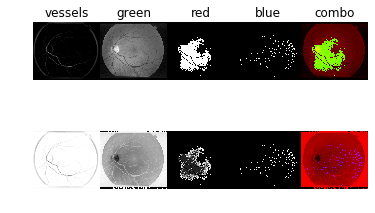



158: Starting on im0163, equalized, vessels mapped, colors mapped, combined and saved, 

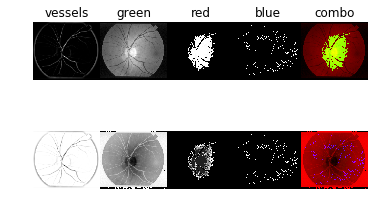



159: Starting on im0164, equalized, vessels mapped, colors mapped, combined and saved, 

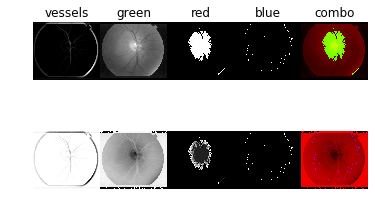



160: Starting on im0165, equalized, vessels mapped, colors mapped, combined and saved, 

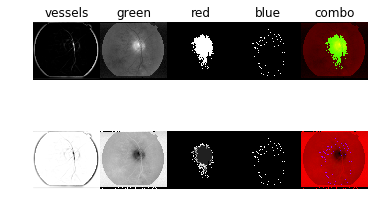



161: Starting on im0166, equalized, vessels mapped, colors mapped, combined and saved, 

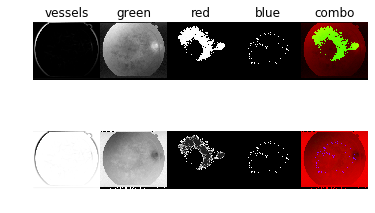



162: Starting on im0168, equalized, vessels mapped, colors mapped, combined and saved, 

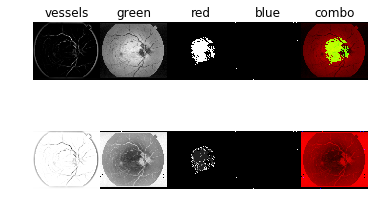



163: Starting on im0169, equalized, vessels mapped, colors mapped, combined and saved, 

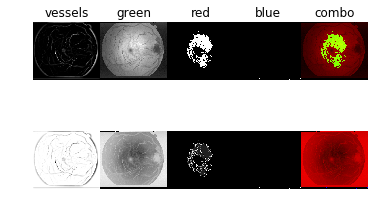



164: Starting on im0170, equalized, vessels mapped, colors mapped, combined and saved, 

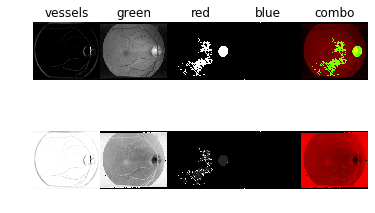



165: Starting on im0171, equalized, vessels mapped, colors mapped, combined and saved, 

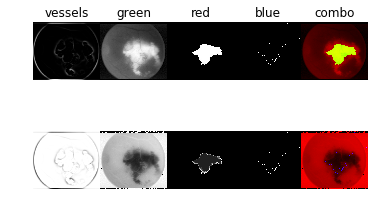



166: Starting on im0172, equalized, vessels mapped, colors mapped, combined and saved, 

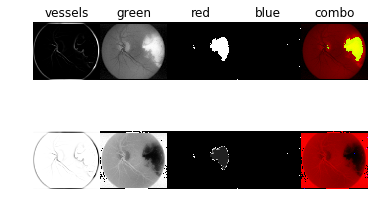



167: Starting on im0173, equalized, vessels mapped, colors mapped, combined and saved, 

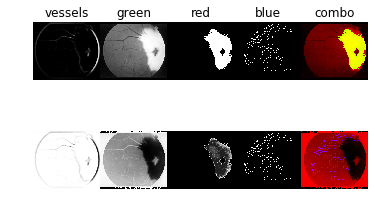



168: Starting on im0174, equalized, vessels mapped, colors mapped, combined and saved, 

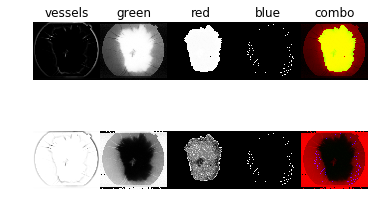



169: Starting on im0175, equalized, vessels mapped, colors mapped, combined and saved, 

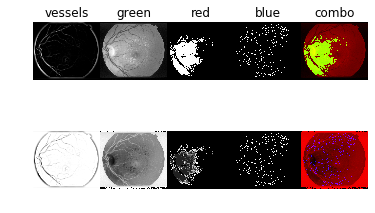



170: Starting on im0176, equalized, vessels mapped, colors mapped, combined and saved, 

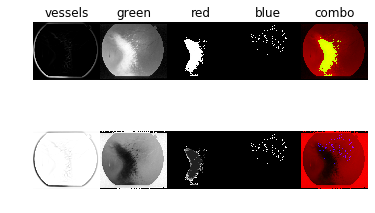



171: Starting on im0177, equalized, vessels mapped, colors mapped, combined and saved, 

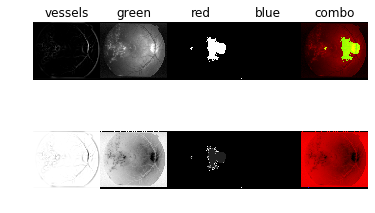



172: Starting on im0178, equalized, vessels mapped, colors mapped, combined and saved, 

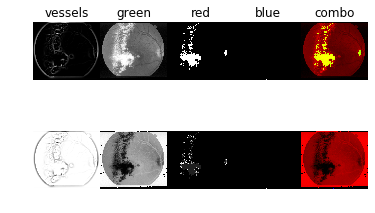



173: Starting on im0179, equalized, vessels mapped, colors mapped, combined and saved, 

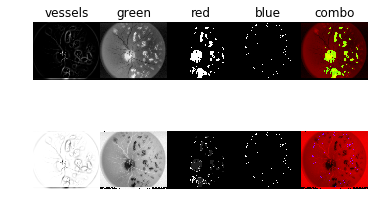



174: Starting on im0180, equalized, vessels mapped, colors mapped, combined and saved, 

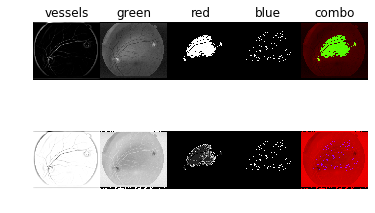



175: Starting on im0181, equalized, vessels mapped, colors mapped, combined and saved, 

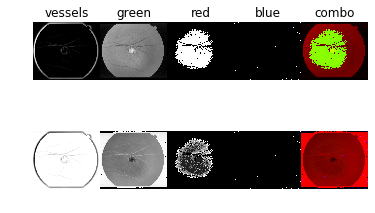



176: Starting on im0182, equalized, vessels mapped, colors mapped, combined and saved, 

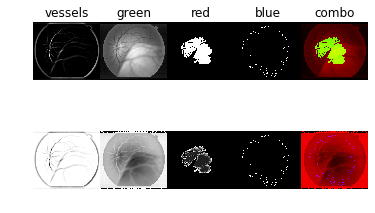



177: Starting on im0183, equalized, vessels mapped, colors mapped, combined and saved, 

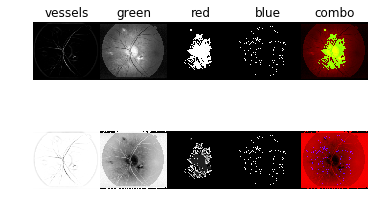



178: Starting on im0184, equalized, vessels mapped, colors mapped, combined and saved, 

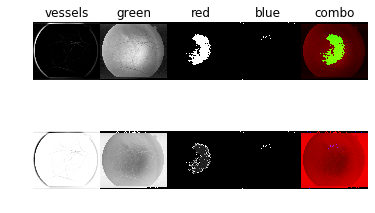



179: Starting on im0185, equalized, vessels mapped, colors mapped, combined and saved, 

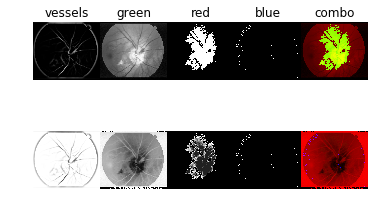



180: Starting on im0186, equalized, vessels mapped, colors mapped, combined and saved, 

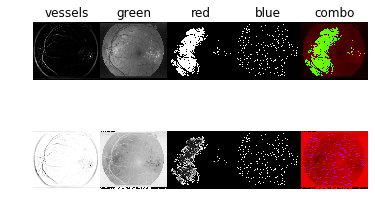



181: Starting on im0187, equalized, vessels mapped, colors mapped, combined and saved, 

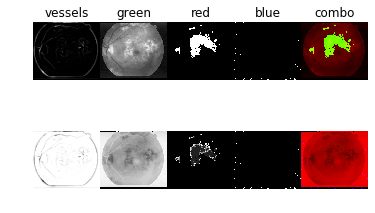



182: Starting on im0188, equalized, vessels mapped, colors mapped, combined and saved, 

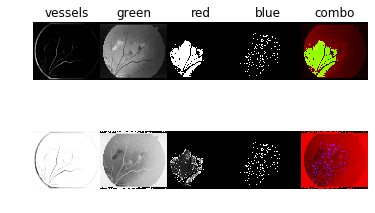



183: Starting on im0189, equalized, vessels mapped, colors mapped, combined and saved, 

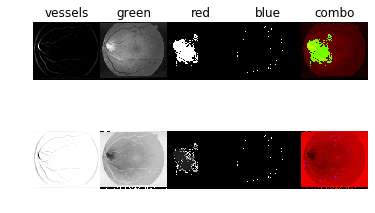



184: Starting on im0190, equalized, vessels mapped, colors mapped, combined and saved, 

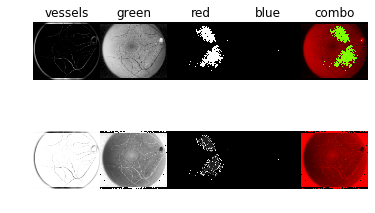



185: Starting on im0191, equalized, vessels mapped, colors mapped, combined and saved, 

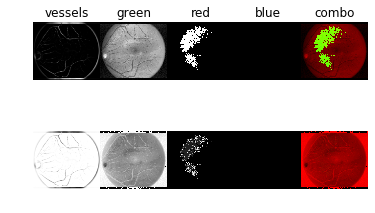



186: Starting on im0192, equalized, vessels mapped, colors mapped, combined and saved, 

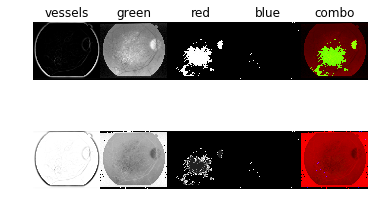



187: Starting on im0193, equalized, vessels mapped, colors mapped, combined and saved, 

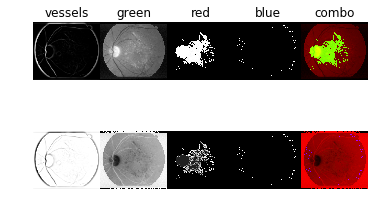



188: Starting on im0194, equalized, vessels mapped, colors mapped, combined and saved, 

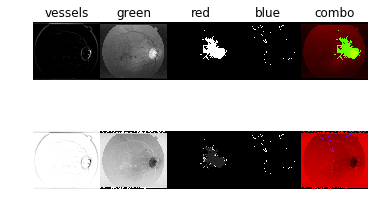



189: Starting on im0195, equalized, vessels mapped, colors mapped, combined and saved, 

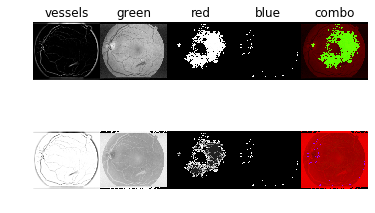



190: Starting on im0196, equalized, vessels mapped, colors mapped, combined and saved, 

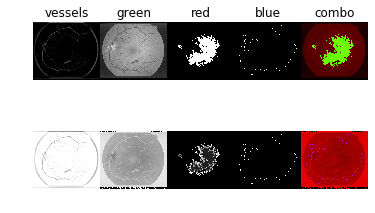



191: Starting on im0197, equalized, vessels mapped, colors mapped, combined and saved, 

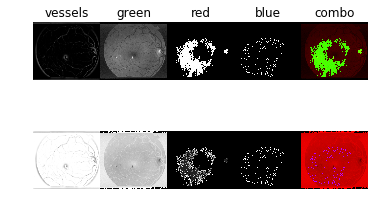



192: Starting on im0198, equalized, vessels mapped, colors mapped, combined and saved, 

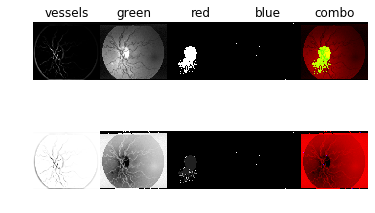



193: Starting on im0199, equalized, vessels mapped, colors mapped, combined and saved, 

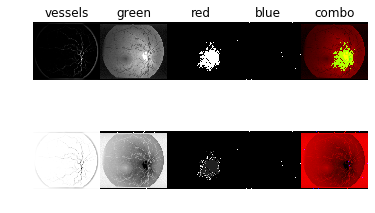



194: Starting on im0200, equalized, vessels mapped, colors mapped, combined and saved, 

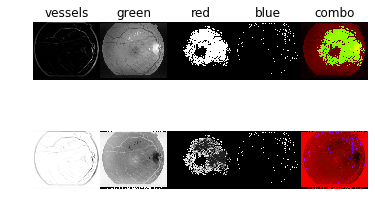



195: Starting on im0201, equalized, vessels mapped, colors mapped, combined and saved, 

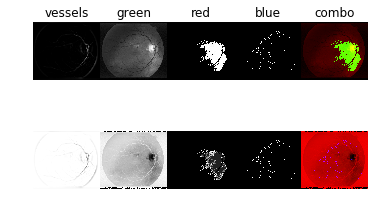



196: Starting on im0202, equalized, vessels mapped, colors mapped, combined and saved, 

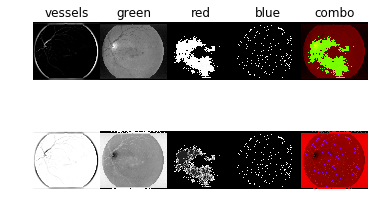



197: Starting on im0203, equalized, vessels mapped, colors mapped, combined and saved, 

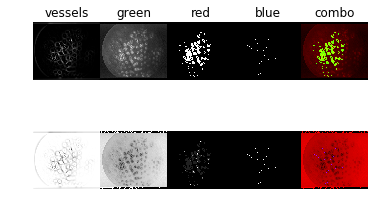



198: Starting on im0204, equalized, vessels mapped, colors mapped, combined and saved, 

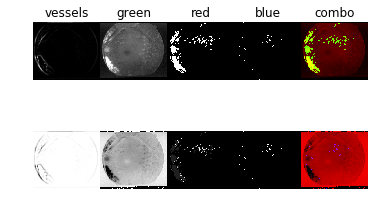



199: Starting on im0205, equalized, vessels mapped, colors mapped, combined and saved, 

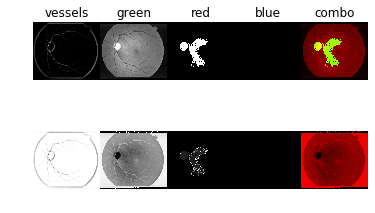



200: Starting on im0206, equalized, vessels mapped, colors mapped, combined and saved, 

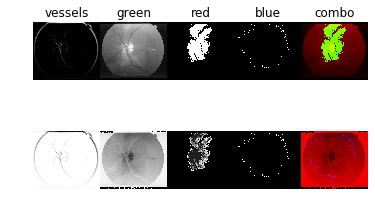



201: Starting on im0207, equalized, vessels mapped, colors mapped, combined and saved, 

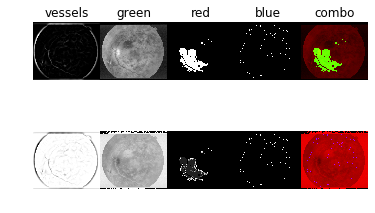



202: Starting on im0208, equalized, vessels mapped, colors mapped, combined and saved, 

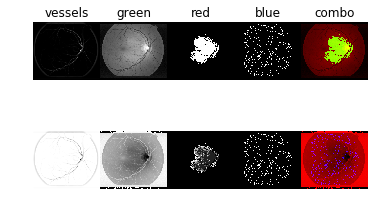



203: Starting on im0209, equalized, vessels mapped, colors mapped, combined and saved, 

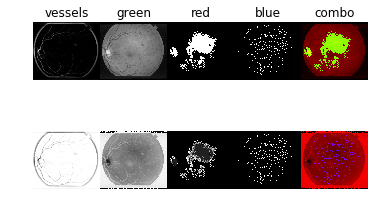



204: Starting on im0210, equalized, vessels mapped, colors mapped, combined and saved, 

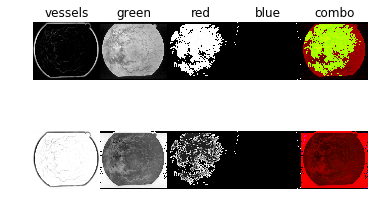



205: Starting on im0211, equalized, vessels mapped, colors mapped, combined and saved, 

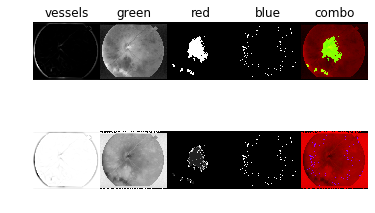



206: Starting on im0212, equalized, vessels mapped, colors mapped, combined and saved, 

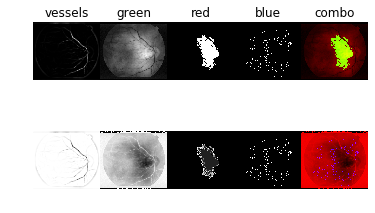



207: Starting on im0213, equalized, vessels mapped, colors mapped, combined and saved, 

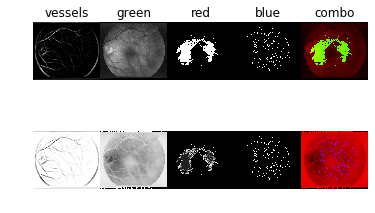



208: Starting on im0214, equalized, vessels mapped, colors mapped, combined and saved, 

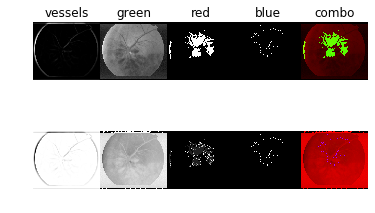



209: Starting on im0215, equalized, vessels mapped, colors mapped, combined and saved, 

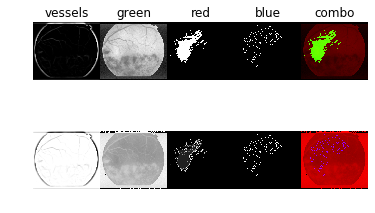



210: Starting on im0216, equalized, vessels mapped, colors mapped, combined and saved, 

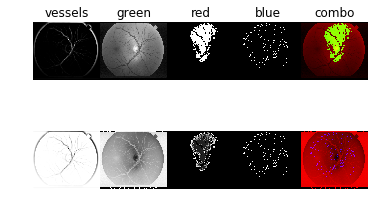



211: Starting on im0217, equalized, vessels mapped, colors mapped, combined and saved, 

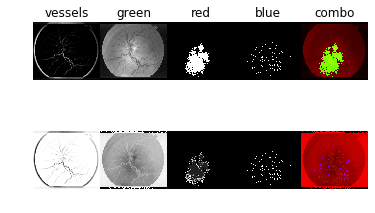



212: Starting on im0218, equalized, vessels mapped, colors mapped, combined and saved, 

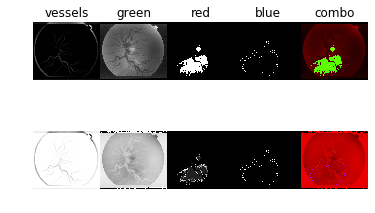



213: Starting on im0219, equalized, vessels mapped, colors mapped, combined and saved, 

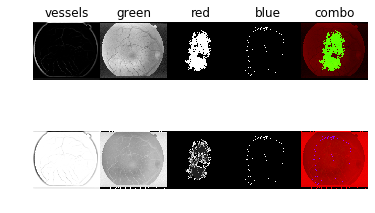



214: Starting on im0220, equalized, vessels mapped, colors mapped, combined and saved, 

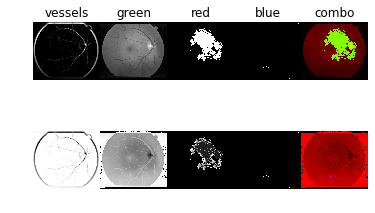



215: Starting on im0221, equalized, vessels mapped, colors mapped, combined and saved, 

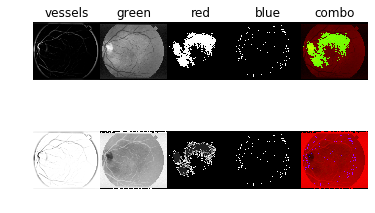



216: Starting on im0222, equalized, vessels mapped, colors mapped, combined and saved, 

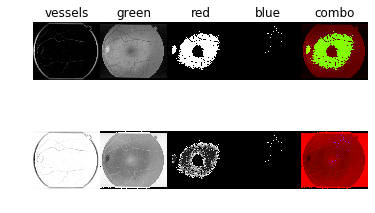



217: Starting on im0223, equalized, vessels mapped, colors mapped, combined and saved, 

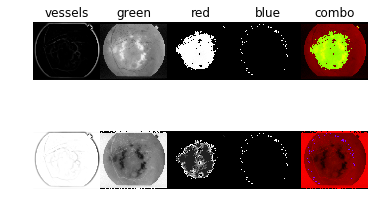



218: Starting on im0224, equalized, vessels mapped, colors mapped, combined and saved, 

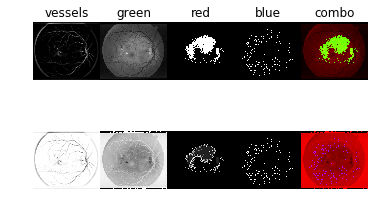



219: Starting on im0225, equalized, vessels mapped, colors mapped, combined and saved, 

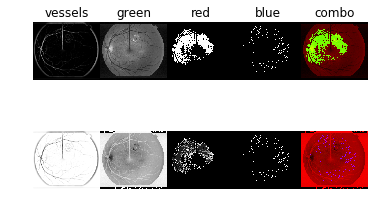



220: Starting on im0226, equalized, vessels mapped, colors mapped, combined and saved, 

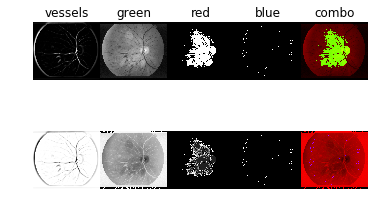



221: Starting on im0227, equalized, vessels mapped, colors mapped, combined and saved, 

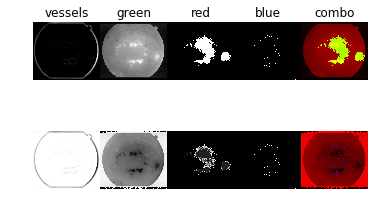



222: Starting on im0228, equalized, vessels mapped, colors mapped, combined and saved, 

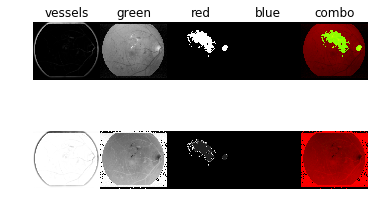



223: Starting on im0229, equalized, vessels mapped, colors mapped, combined and saved, 

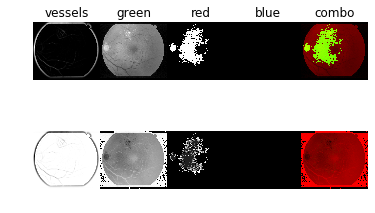



224: Starting on im0230, equalized, vessels mapped, colors mapped, combined and saved, 

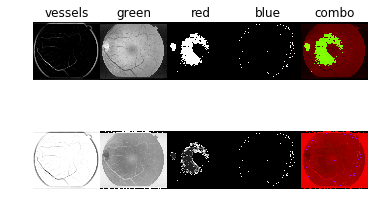



225: Starting on im0231, equalized, vessels mapped, colors mapped, combined and saved, 

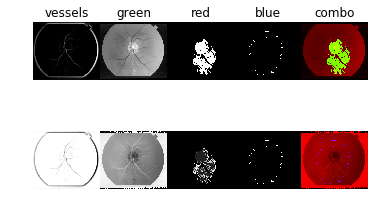



226: Starting on im0232, equalized, vessels mapped, colors mapped, combined and saved, 

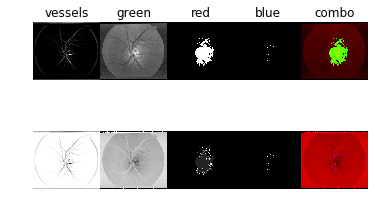



227: Starting on im0233, equalized, vessels mapped, colors mapped, combined and saved, 

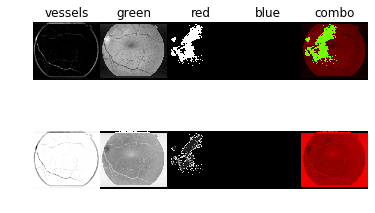



228: Starting on im0234, equalized, vessels mapped, colors mapped, combined and saved, 

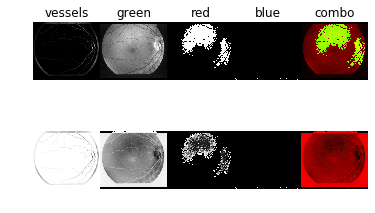



229: Starting on im0235, equalized, vessels mapped, colors mapped, combined and saved, 

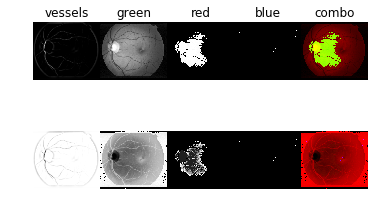



230: Starting on im0236, equalized, vessels mapped, colors mapped, combined and saved, 

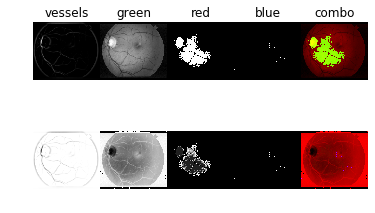



231: Starting on im0237, equalized, vessels mapped, colors mapped, combined and saved, 

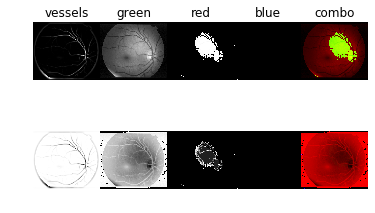



232: Starting on im0238, equalized, vessels mapped, colors mapped, combined and saved, 

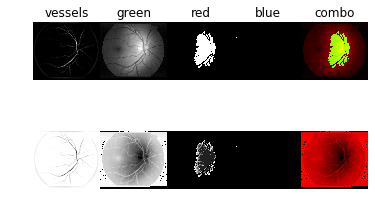



233: Starting on im0239, equalized, vessels mapped, colors mapped, combined and saved, 

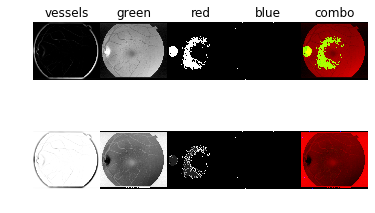



234: Starting on im0240, equalized, vessels mapped, colors mapped, combined and saved, 

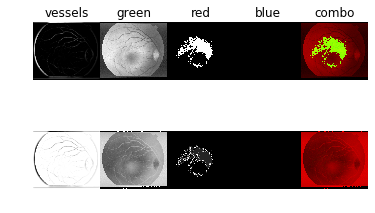



235: Starting on im0241, equalized, vessels mapped, colors mapped, combined and saved, 

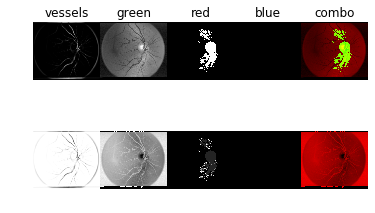



236: Starting on im0242, equalized, vessels mapped, colors mapped, combined and saved, 

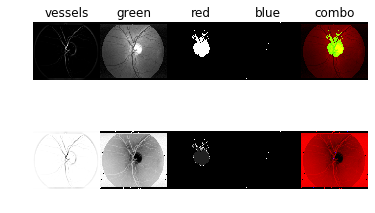



237: Starting on im0243, equalized, vessels mapped, colors mapped, combined and saved, 

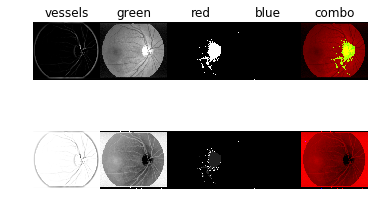



238: Starting on im0244, equalized, vessels mapped, colors mapped, combined and saved, 

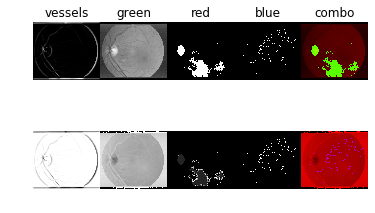



239: Starting on im0245, equalized, vessels mapped, colors mapped, combined and saved, 

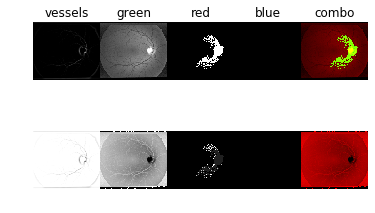



240: Starting on im0246, equalized, vessels mapped, colors mapped, combined and saved, 

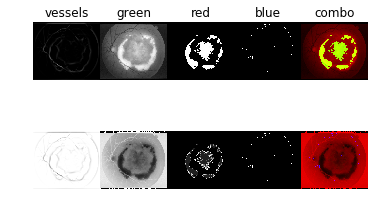



241: Starting on im0247, equalized, vessels mapped, colors mapped, combined and saved, 

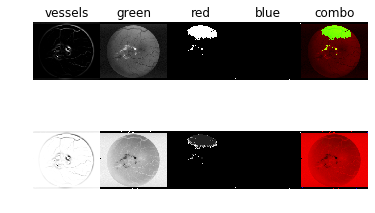



242: Starting on im0248, equalized, vessels mapped, colors mapped, combined and saved, 

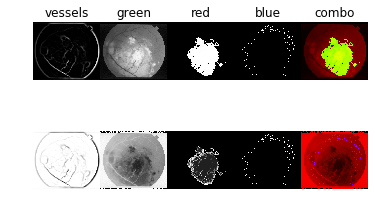



243: Starting on im0249, equalized, vessels mapped, colors mapped, combined and saved, 

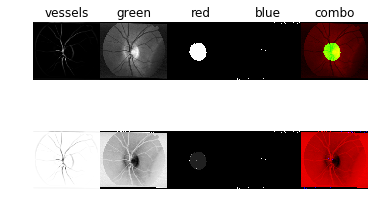



244: Starting on im0250, equalized, vessels mapped, colors mapped, combined and saved, 

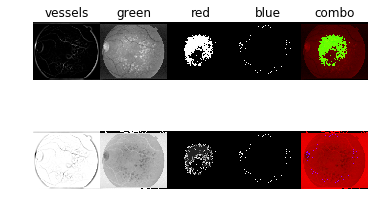



245: Starting on im0251, equalized, vessels mapped, colors mapped, combined and saved, 

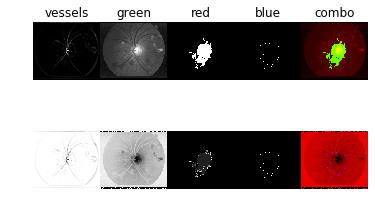



246: Starting on im0252, equalized, vessels mapped, colors mapped, combined and saved, 

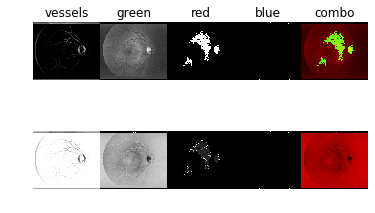



247: Starting on im0253, equalized, vessels mapped, colors mapped, combined and saved, 

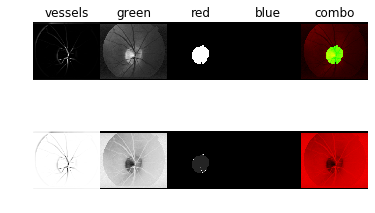



248: Starting on im0254, equalized, vessels mapped, colors mapped, combined and saved, 

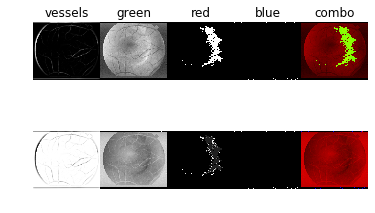



249: Starting on im0255, equalized, vessels mapped, colors mapped, combined and saved, 

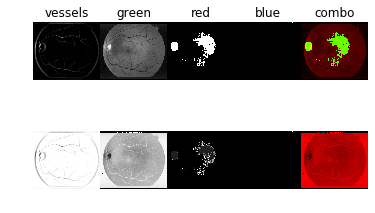



250: Starting on im0256, equalized, vessels mapped, colors mapped, combined and saved, 

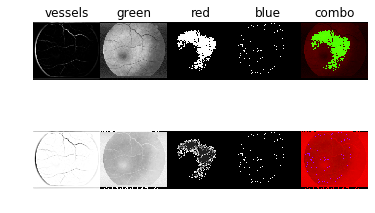



251: Starting on im0257, equalized, vessels mapped, colors mapped, combined and saved, 

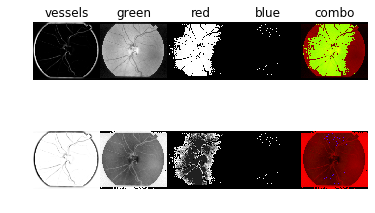



252: Starting on im0258, equalized, vessels mapped, colors mapped, combined and saved, 

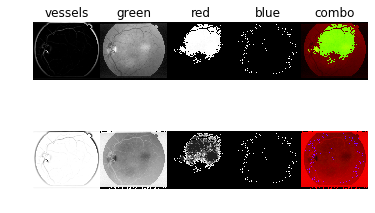



253: Starting on im0259, equalized, vessels mapped, colors mapped, combined and saved, 

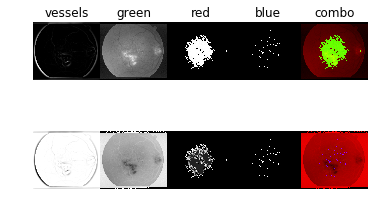



254: Starting on im0260, equalized, vessels mapped, colors mapped, combined and saved, 

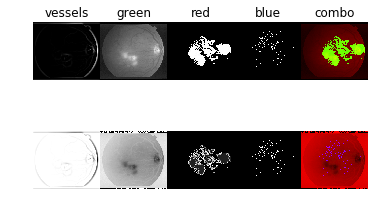



255: Starting on im0261, equalized, vessels mapped, colors mapped, combined and saved, 

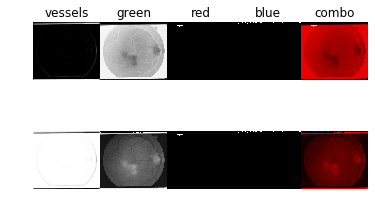



256: Starting on im0262, equalized, vessels mapped, colors mapped, combined and saved, 

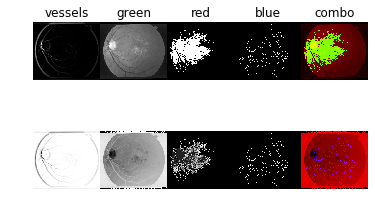



257: Starting on im0263, equalized, vessels mapped, colors mapped, combined and saved, 

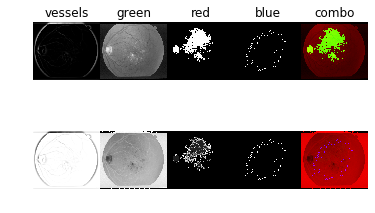



258: Starting on im0264, equalized, vessels mapped, colors mapped, combined and saved, 

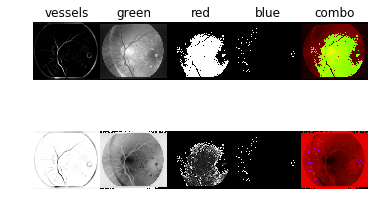



259: Starting on im0265, equalized, vessels mapped, colors mapped, combined and saved, 

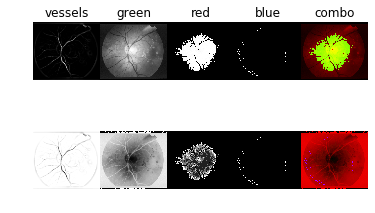



260: Starting on im0266, equalized, vessels mapped, colors mapped, combined and saved, 

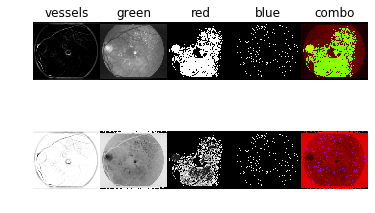



261: Starting on im0267, equalized, vessels mapped, colors mapped, combined and saved, 

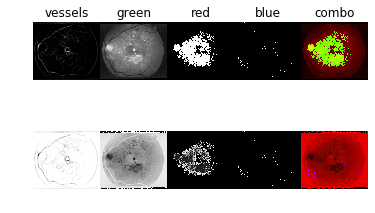



262: Starting on im0268, equalized, vessels mapped, colors mapped, combined and saved, 

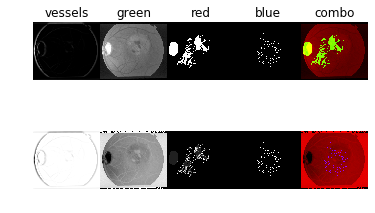



263: Starting on im0269, equalized, vessels mapped, colors mapped, combined and saved, 

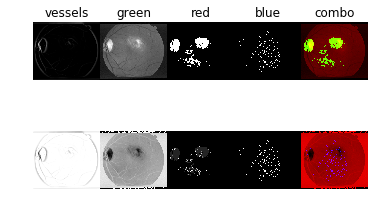



264: Starting on im0270, equalized, vessels mapped, colors mapped, combined and saved, 

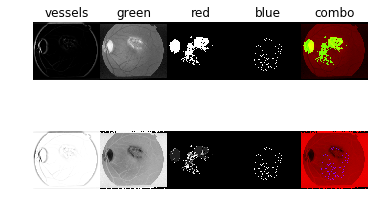



265: Starting on im0271, equalized, vessels mapped, colors mapped, combined and saved, 

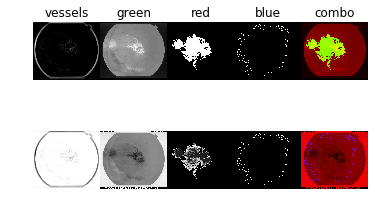



266: Starting on im0272, equalized, vessels mapped, colors mapped, combined and saved, 

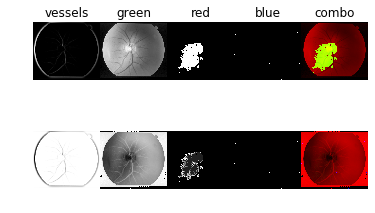



267: Starting on im0273, equalized, vessels mapped, colors mapped, combined and saved, 

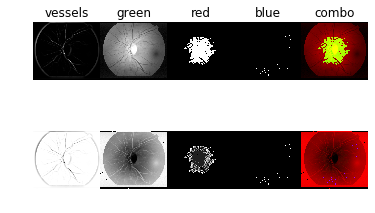



268: Starting on im0274, equalized, vessels mapped, colors mapped, combined and saved, 

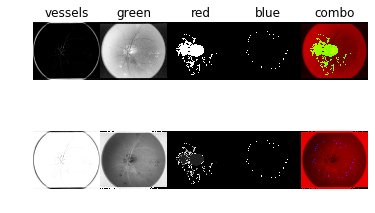



269: Starting on im0275, equalized, vessels mapped, colors mapped, combined and saved, 

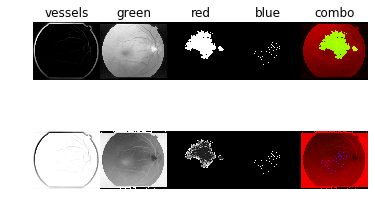



270: Starting on im0276, equalized, vessels mapped, colors mapped, combined and saved, 

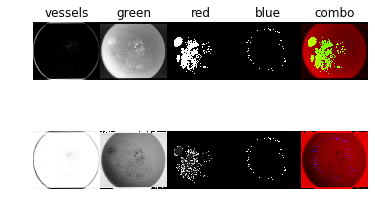



271: Starting on im0277, equalized, vessels mapped, colors mapped, combined and saved, 

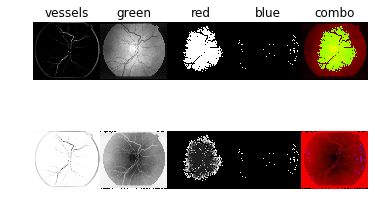



272: Starting on im0278, equalized, vessels mapped, colors mapped, combined and saved, 

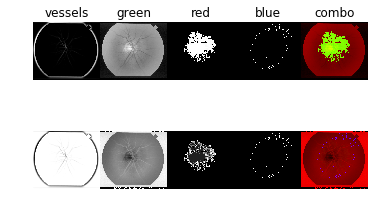



273: Starting on im0279, equalized, vessels mapped, colors mapped, combined and saved, 

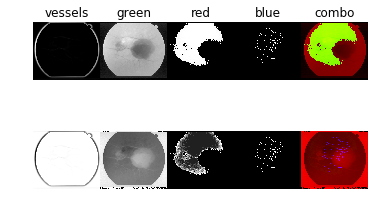



274: Starting on im0280, equalized, vessels mapped, colors mapped, combined and saved, 

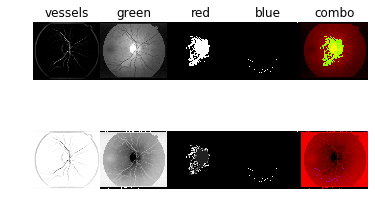



275: Starting on im0281, equalized, vessels mapped, colors mapped, combined and saved, 

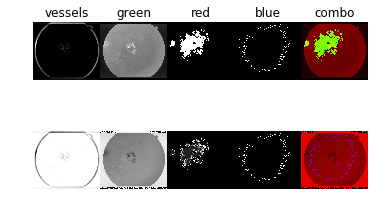



276: Starting on im0282, equalized, vessels mapped, colors mapped, combined and saved, 

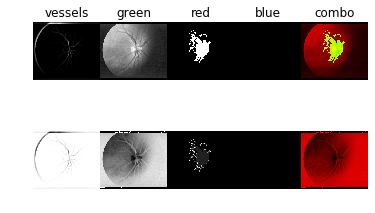



277: Starting on im0283, equalized, vessels mapped, colors mapped, combined and saved, 

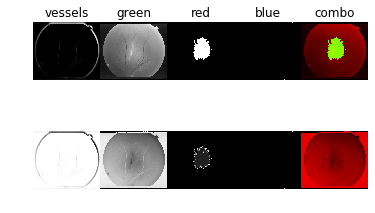



278: Starting on im0284, equalized, vessels mapped, colors mapped, combined and saved, 

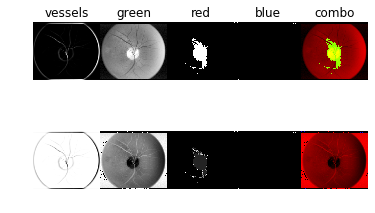



279: Starting on im0285, equalized, vessels mapped, colors mapped, combined and saved, 

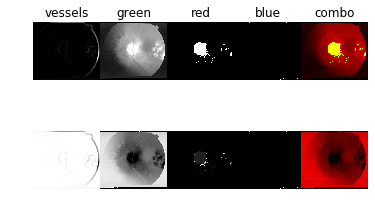



280: Starting on im0286, equalized, vessels mapped, colors mapped, combined and saved, 

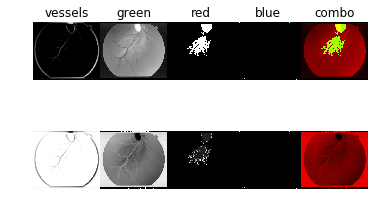



281: Starting on im0287, equalized, vessels mapped, colors mapped, combined and saved, 

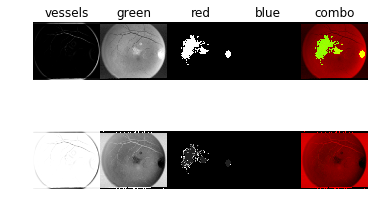



282: Starting on im0288, equalized, vessels mapped, colors mapped, combined and saved, 

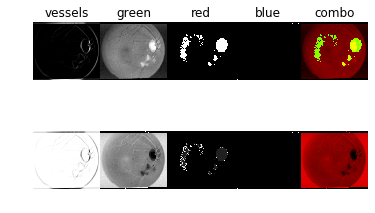



283: Starting on im0289, equalized, vessels mapped, colors mapped, combined and saved, 

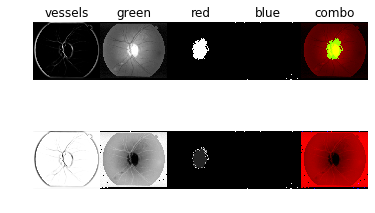



284: Starting on im0290, equalized, vessels mapped, colors mapped, combined and saved, 

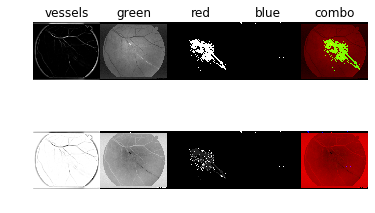



285: Starting on im0291, equalized, vessels mapped, colors mapped, combined and saved, 

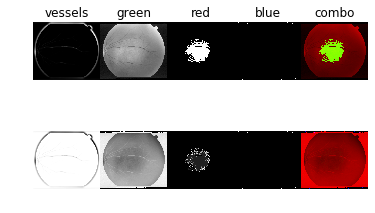



286: Starting on im0292, equalized, vessels mapped, colors mapped, combined and saved, 

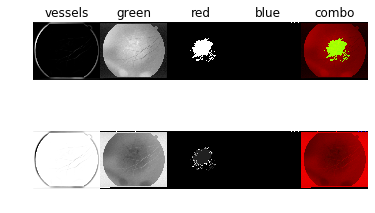



287: Starting on im0293, equalized, vessels mapped, colors mapped, combined and saved, 

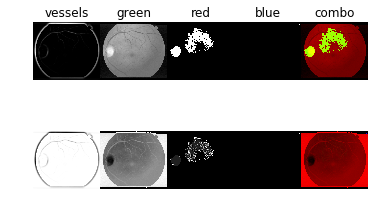



288: Starting on im0294, equalized, vessels mapped, colors mapped, combined and saved, 

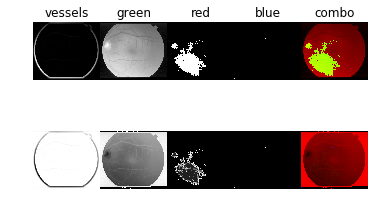



289: Starting on im0295, equalized, vessels mapped, colors mapped, combined and saved, 

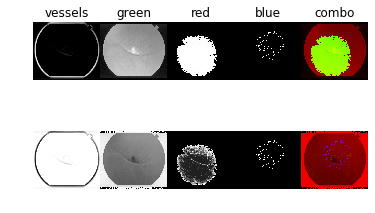



290: Starting on im0296, equalized, vessels mapped, colors mapped, combined and saved, 

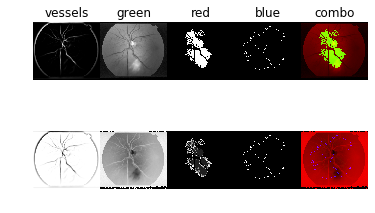



291: Starting on im0297, equalized, vessels mapped, colors mapped, combined and saved, 

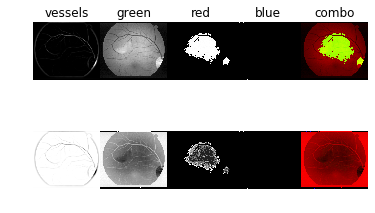



292: Starting on im0298, equalized, vessels mapped, colors mapped, combined and saved, 

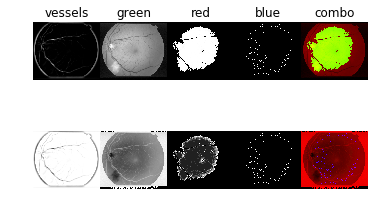



293: Starting on im0299, equalized, vessels mapped, colors mapped, combined and saved, 

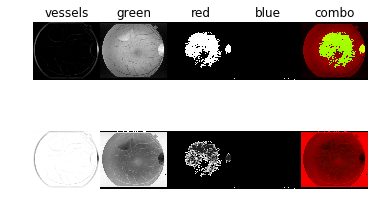



294: Starting on im0300, equalized, vessels mapped, colors mapped, combined and saved, 

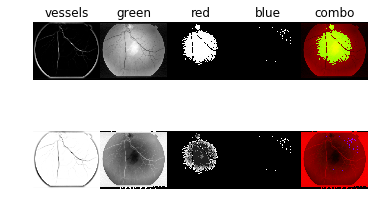



295: Starting on im0301, equalized, vessels mapped, colors mapped, combined and saved, 

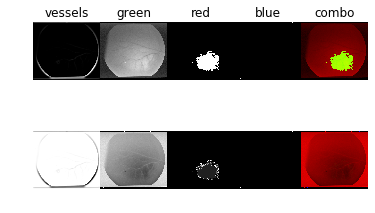



296: Starting on im0302, equalized, vessels mapped, colors mapped, combined and saved, 

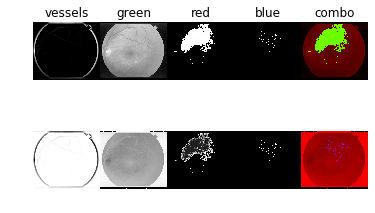



297: Starting on im0303, equalized, vessels mapped, colors mapped, combined and saved, 

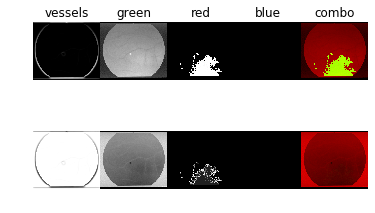



298: Starting on im0304, equalized, vessels mapped, colors mapped, combined and saved, 

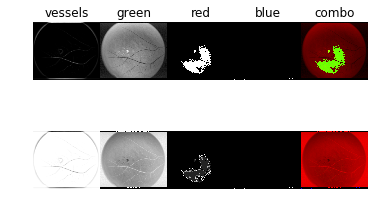



299: Starting on im0305, equalized, vessels mapped, colors mapped, combined and saved, 

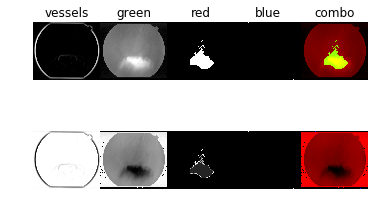



300: Starting on im0306, equalized, vessels mapped, colors mapped, combined and saved, 

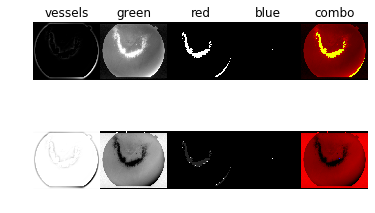



301: Starting on im0307, equalized, vessels mapped, colors mapped, combined and saved, 

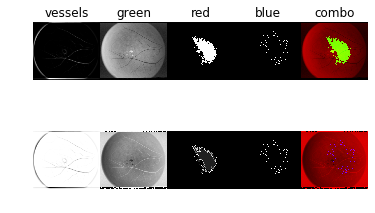



302: Starting on im0308, equalized, vessels mapped, colors mapped, combined and saved, 

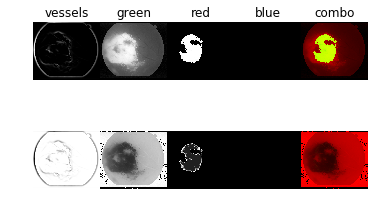



303: Starting on im0309, equalized, vessels mapped, colors mapped, combined and saved, 

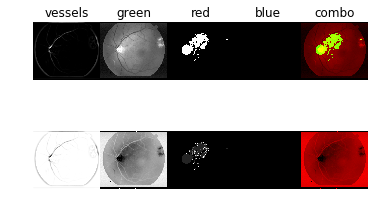



304: Starting on im0310, equalized, vessels mapped, colors mapped, combined and saved, 

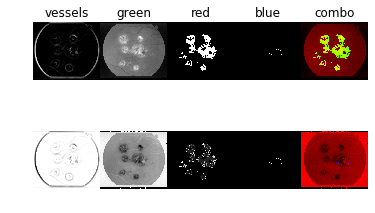



305: Starting on im0311, equalized, vessels mapped, colors mapped, combined and saved, 

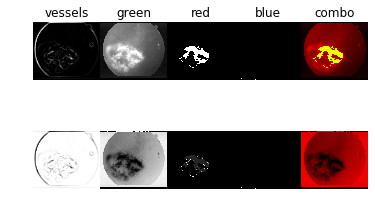



306: Starting on im0312, equalized, vessels mapped, colors mapped, combined and saved, 

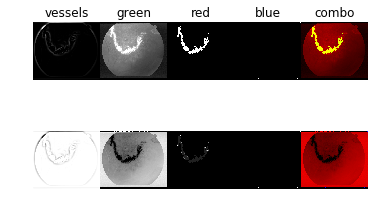



307: Starting on im0313, equalized, vessels mapped, colors mapped, combined and saved, 

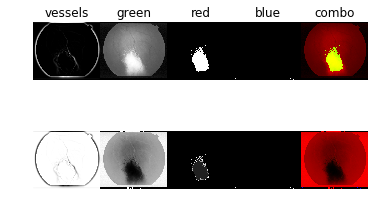



308: Starting on im0314, equalized, vessels mapped, colors mapped, combined and saved, 

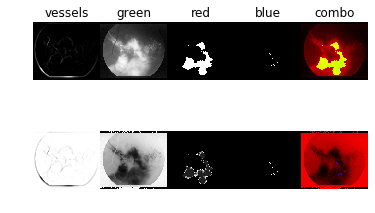



309: Starting on im0315, equalized, vessels mapped, colors mapped, combined and saved, 

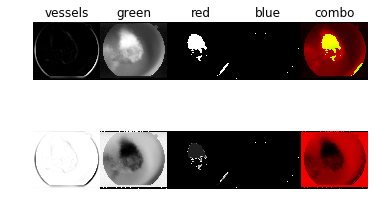



310: Starting on im0316, equalized, vessels mapped, colors mapped, combined and saved, 

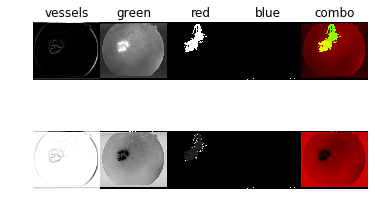



311: Starting on im0317, equalized, vessels mapped, colors mapped, combined and saved, 

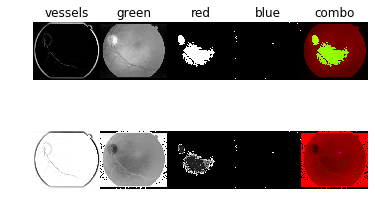



312: Starting on im0318, equalized, vessels mapped, colors mapped, combined and saved, 

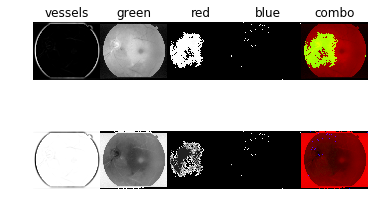



313: Starting on im0319, equalized, vessels mapped, colors mapped, combined and saved, 

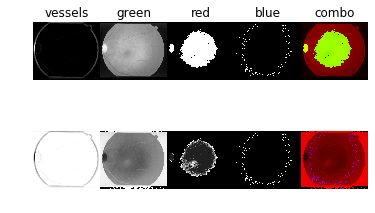



314: Starting on im0320, equalized, vessels mapped, colors mapped, combined and saved, 

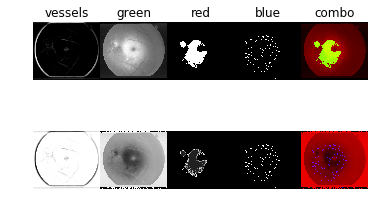



315: Starting on im0321, equalized, vessels mapped, colors mapped, combined and saved, 

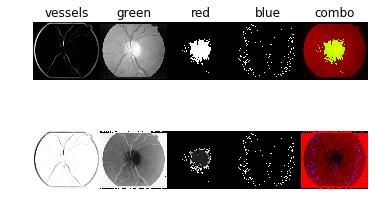



316: Starting on im0322, equalized, vessels mapped, colors mapped, combined and saved, 

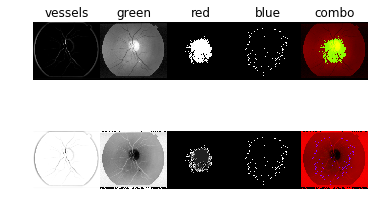



317: Starting on im0323, equalized, vessels mapped, colors mapped, combined and saved, 

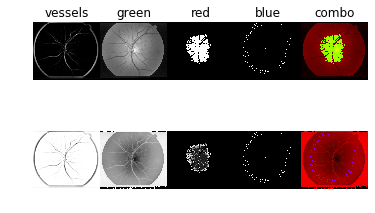



318: Starting on im0324, equalized, vessels mapped, colors mapped, combined and saved, 

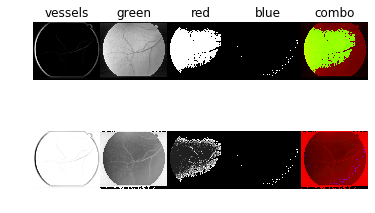



319: Starting on im0325, equalized, vessels mapped, colors mapped, combined and saved, 

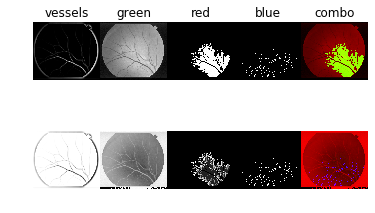



320: Starting on im0326, equalized, vessels mapped, colors mapped, combined and saved, 

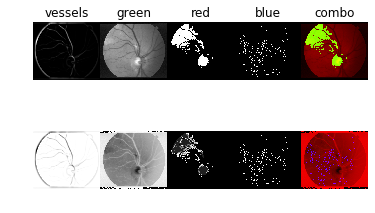



321: Starting on im0327, equalized, vessels mapped, colors mapped, combined and saved, 

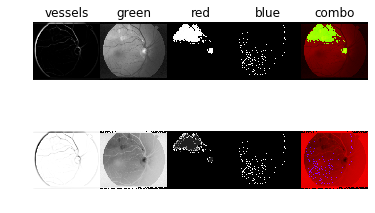



322: Starting on im0328, equalized, vessels mapped, colors mapped, combined and saved, 

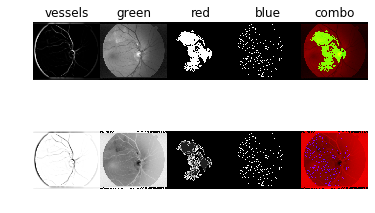



323: Starting on im0329, equalized, vessels mapped, colors mapped, combined and saved, 

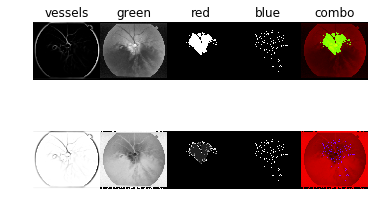



324: Starting on im0330, equalized, vessels mapped, colors mapped, combined and saved, 

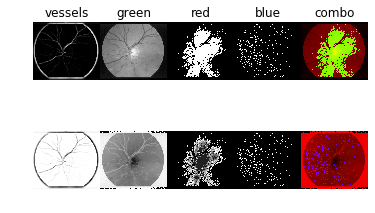



325: Starting on im0331, equalized, vessels mapped, colors mapped, combined and saved, 

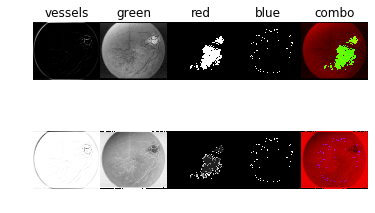



326: Starting on im0332, equalized, vessels mapped, colors mapped, combined and saved, 

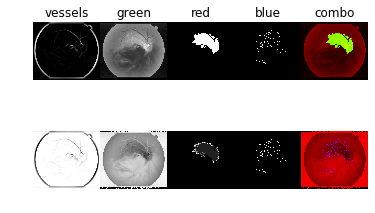



327: Starting on im0333, equalized, vessels mapped, colors mapped, combined and saved, 

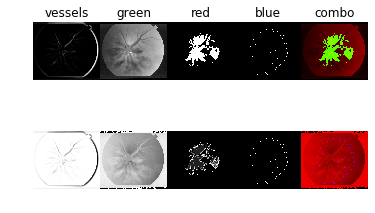



328: Starting on im0334, equalized, vessels mapped, colors mapped, combined and saved, 

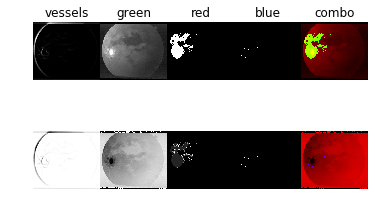



329: Starting on im0335, equalized, vessels mapped, colors mapped, combined and saved, 

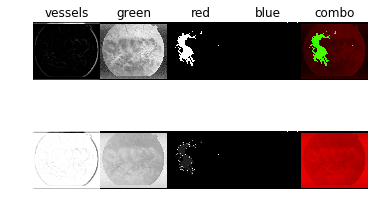



330: Starting on im0336, equalized, vessels mapped, colors mapped, combined and saved, 

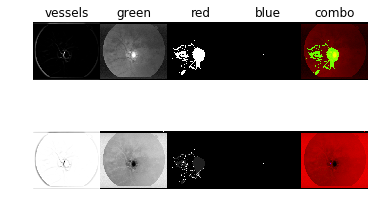



331: Starting on im0337, equalized, vessels mapped, colors mapped, combined and saved, 

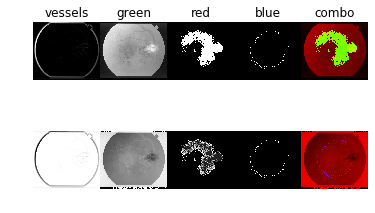



332: Starting on im0338, equalized, vessels mapped, colors mapped, combined and saved, 

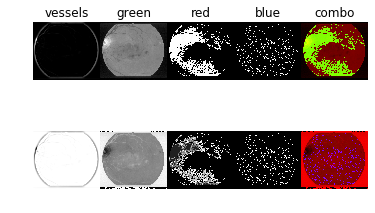



333: Starting on im0339, equalized, vessels mapped, colors mapped, combined and saved, 

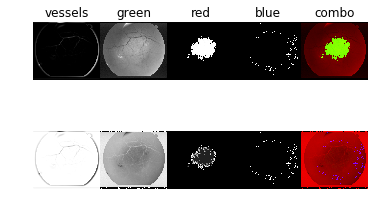



334: Starting on im0340, equalized, vessels mapped, colors mapped, combined and saved, 

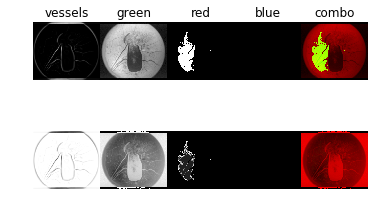



335: Starting on im0341, equalized, vessels mapped, colors mapped, combined and saved, 

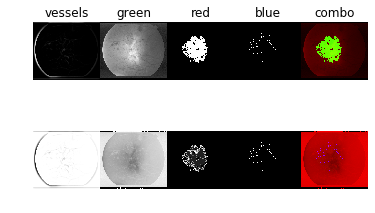



336: Starting on im0342, equalized, vessels mapped, colors mapped, combined and saved, 

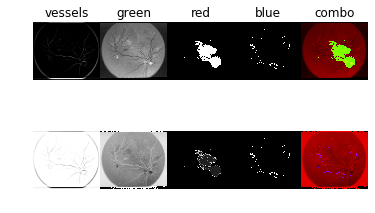



337: Starting on im0343, equalized, vessels mapped, colors mapped, combined and saved, 

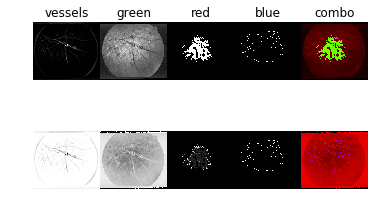



338: Starting on im0344, equalized, vessels mapped, colors mapped, combined and saved, 

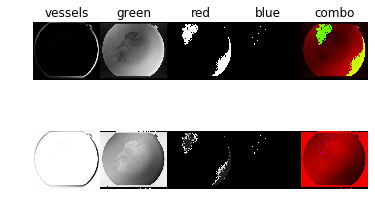



339: Starting on im0345, equalized, vessels mapped, colors mapped, combined and saved, 

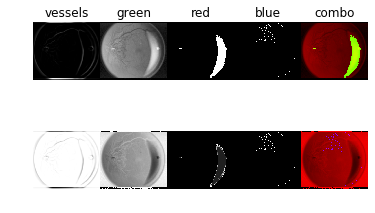



340: Starting on im0346, equalized, vessels mapped, colors mapped, combined and saved, 

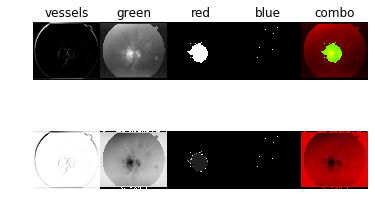



341: Starting on im0347, equalized, vessels mapped, colors mapped, combined and saved, 

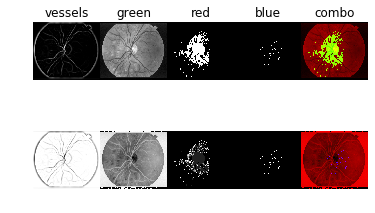



342: Starting on im0348, equalized, vessels mapped, colors mapped, combined and saved, 

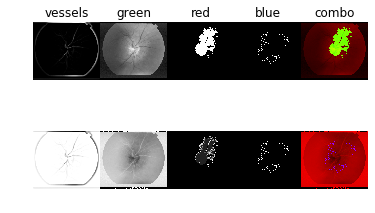



343: Starting on im0349, equalized, vessels mapped, colors mapped, combined and saved, 

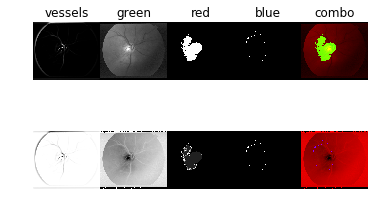



344: Starting on im0350, equalized, vessels mapped, colors mapped, combined and saved, 

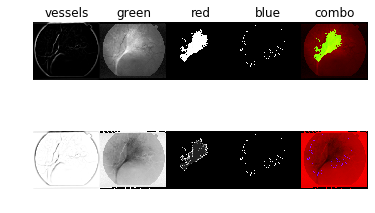



345: Starting on im0351, equalized, vessels mapped, colors mapped, combined and saved, 

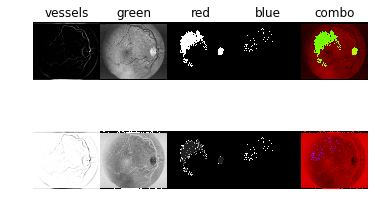



346: Starting on im0352, equalized, vessels mapped, colors mapped, combined and saved, 

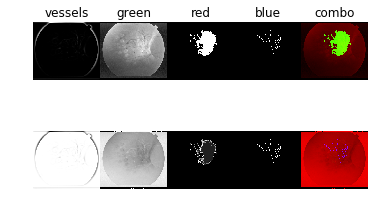



347: Starting on im0353, equalized, vessels mapped, colors mapped, combined and saved, 

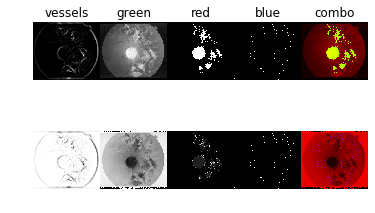



348: Starting on im0354, equalized, vessels mapped, colors mapped, combined and saved, 

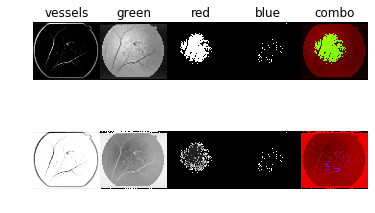



349: Starting on im0355, equalized, vessels mapped, colors mapped, combined and saved, 

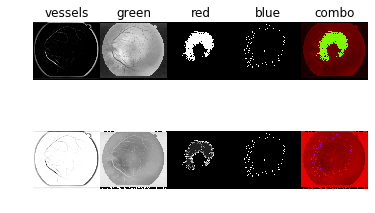



350: Starting on im0356, equalized, vessels mapped, colors mapped, combined and saved, 

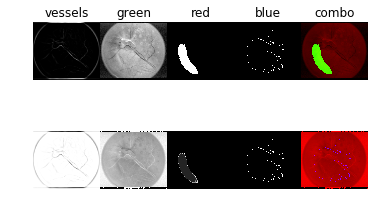



351: Starting on im0357, equalized, vessels mapped, colors mapped, combined and saved, 

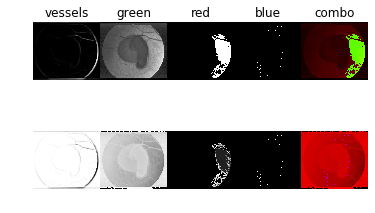



352: Starting on im0358, equalized, vessels mapped, colors mapped, combined and saved, 

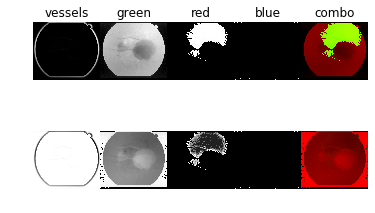



353: Starting on im0359, equalized, vessels mapped, colors mapped, combined and saved, 

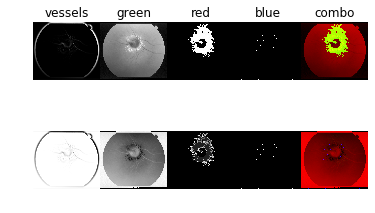



354: Starting on im0360, equalized, vessels mapped, colors mapped, combined and saved, 

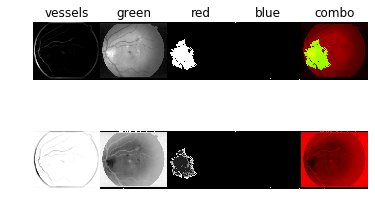



355: Starting on im0361, equalized, vessels mapped, colors mapped, combined and saved, 

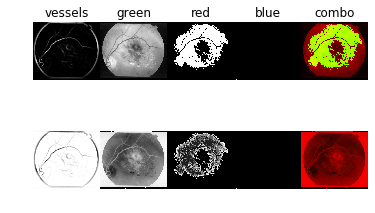



356: Starting on im0362, equalized, vessels mapped, colors mapped, combined and saved, 

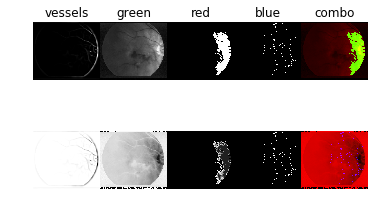



357: Starting on im0363, equalized, vessels mapped, colors mapped, combined and saved, 

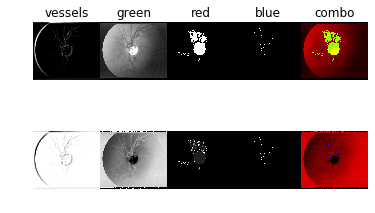



358: Starting on im0364, equalized, vessels mapped, colors mapped, combined and saved, 

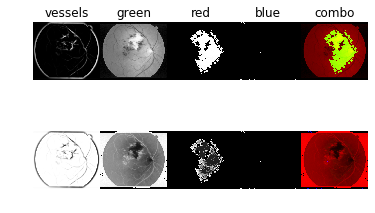



359: Starting on im0365, equalized, vessels mapped, colors mapped, combined and saved, 

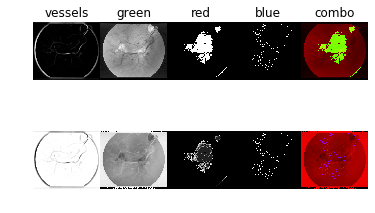



360: Starting on im0366, equalized, vessels mapped, colors mapped, combined and saved, 

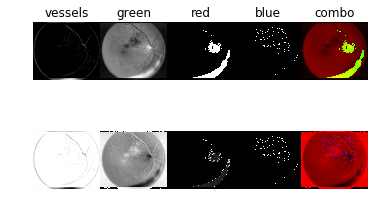



361: Starting on im0367, equalized, vessels mapped, colors mapped, combined and saved, 

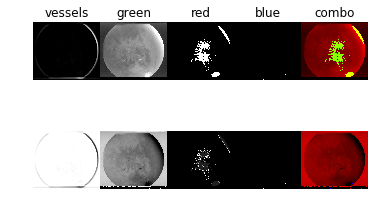



362: Starting on im0368, equalized, vessels mapped, colors mapped, combined and saved, 

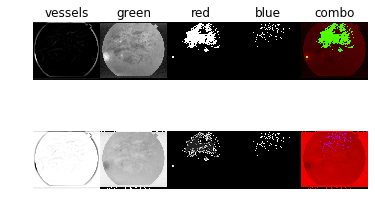



363: Starting on im0369, equalized, vessels mapped, colors mapped, combined and saved, 

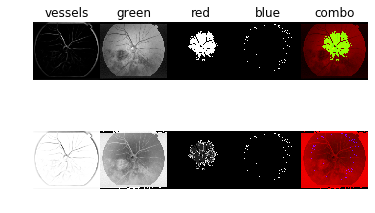



364: Starting on im0370, equalized, vessels mapped, colors mapped, combined and saved, 

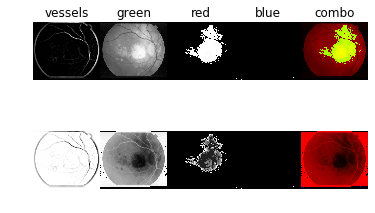



365: Starting on im0371, equalized, vessels mapped, colors mapped, combined and saved, 

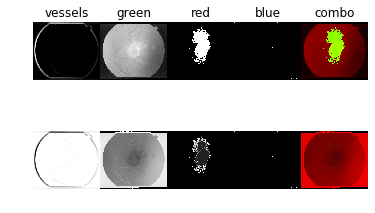



366: Starting on im0372, equalized, vessels mapped, colors mapped, combined and saved, 

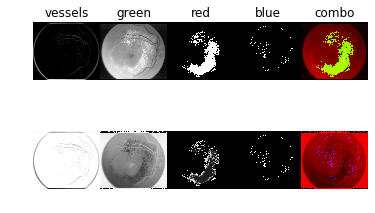



367: Starting on im0373, equalized, vessels mapped, colors mapped, combined and saved, 

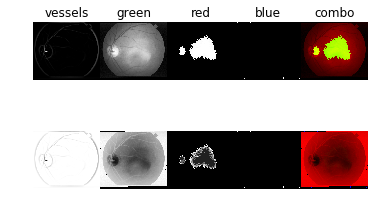



368: Starting on im0374, equalized, vessels mapped, colors mapped, combined and saved, 

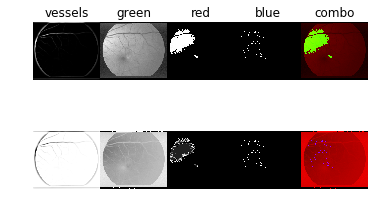



369: Starting on im0375, equalized, vessels mapped, colors mapped, combined and saved, 

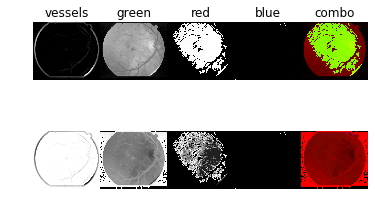



370: Starting on im0376, equalized, vessels mapped, colors mapped, combined and saved, 

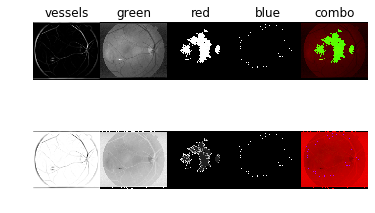



371: Starting on im0377, equalized, vessels mapped, colors mapped, combined and saved, 

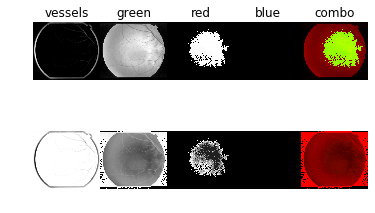



372: Starting on im0378, equalized, vessels mapped, colors mapped, combined and saved, 

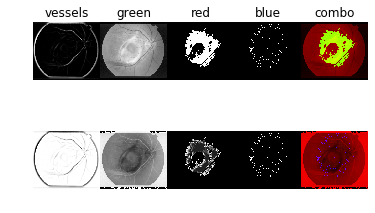



373: Starting on im0379, equalized, vessels mapped, colors mapped, combined and saved, 

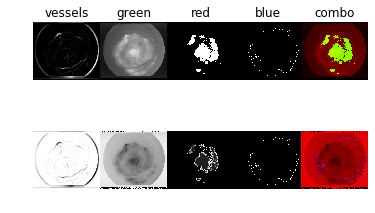



374: Starting on im0380, equalized, vessels mapped, colors mapped, combined and saved, 

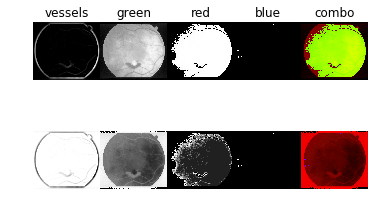



375: Starting on im0381, equalized, vessels mapped, colors mapped, combined and saved, 

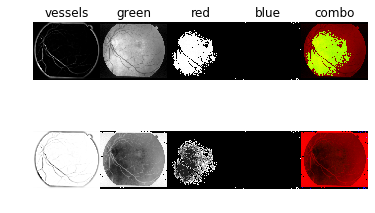



376: Starting on im0382, equalized, vessels mapped, colors mapped, combined and saved, 

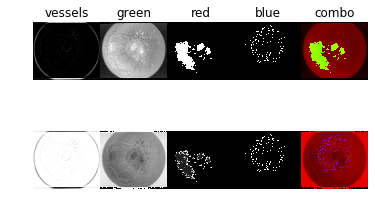



377: Starting on im0383, equalized, vessels mapped, colors mapped, combined and saved, 

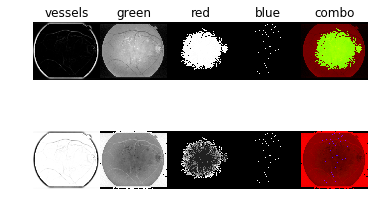



378: Starting on im0384, equalized, vessels mapped, colors mapped, combined and saved, 

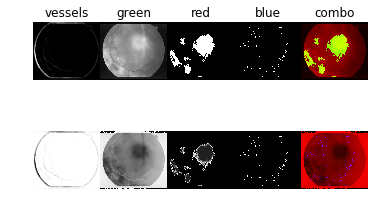



379: Starting on im0385, equalized, vessels mapped, colors mapped, combined and saved, 

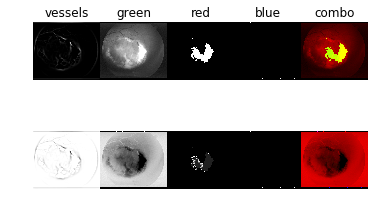



380: Starting on im0386, equalized, vessels mapped, colors mapped, combined and saved, 

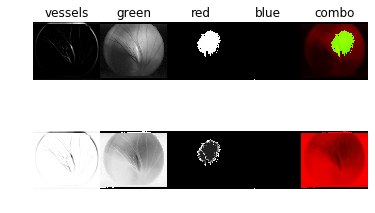



381: Starting on im0387, equalized, vessels mapped, colors mapped, combined and saved, 

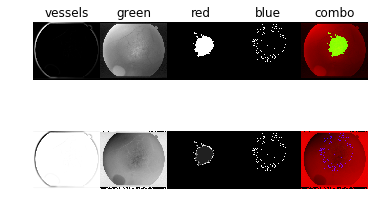



382: Starting on im0388, equalized, vessels mapped, colors mapped, combined and saved, 

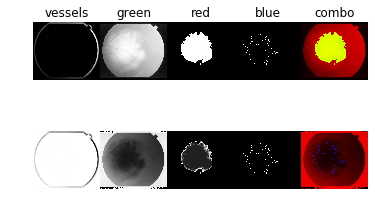



383: Starting on im0389, equalized, vessels mapped, colors mapped, combined and saved, 

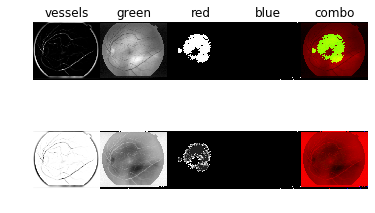



384: Starting on im0390, equalized, vessels mapped, colors mapped, combined and saved, 

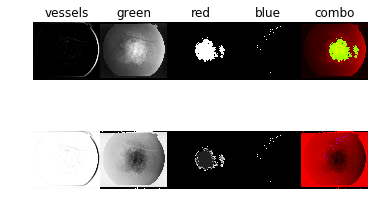



385: Starting on im0391, equalized, vessels mapped, colors mapped, combined and saved, 

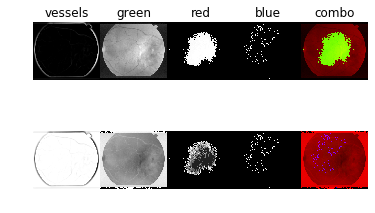



386: Starting on im0392, equalized, vessels mapped, colors mapped, combined and saved, 

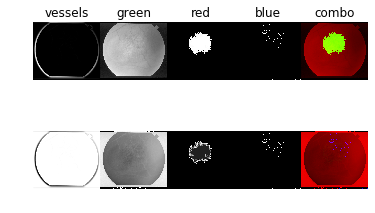



387: Starting on im0393, equalized, vessels mapped, colors mapped, combined and saved, 

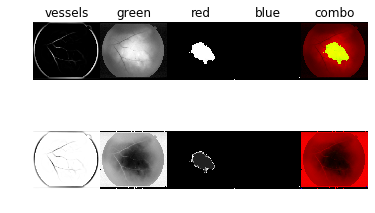



388: Starting on im0394, equalized, vessels mapped, colors mapped, combined and saved, 

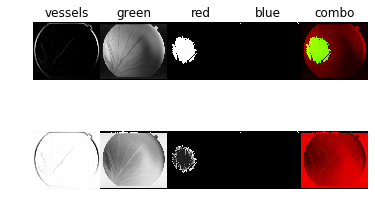



389: Starting on im0395, equalized, vessels mapped, colors mapped, combined and saved, 

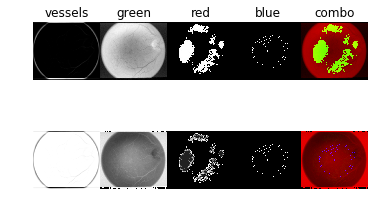



390: Starting on im0396, equalized, vessels mapped, colors mapped, combined and saved, 

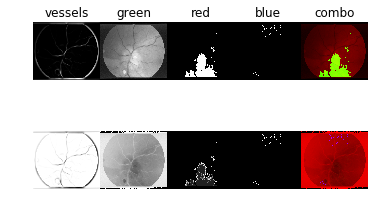



391: Starting on im0397, equalized, vessels mapped, colors mapped, combined and saved, 

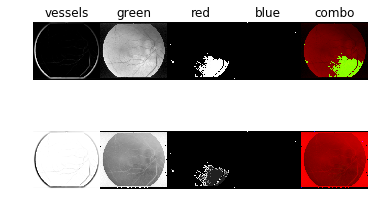



392: Starting on im0398, equalized, vessels mapped, colors mapped, combined and saved, 

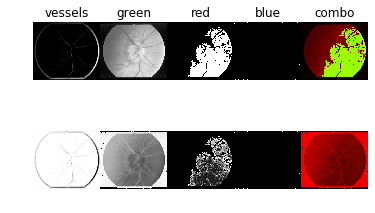



393: Starting on im0399, equalized, vessels mapped, colors mapped, combined and saved, 

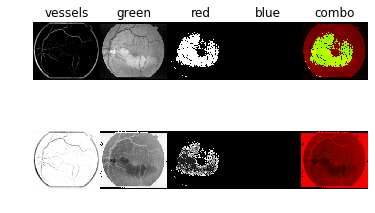



394: Starting on im0400, equalized, vessels mapped, colors mapped, combined and saved, 

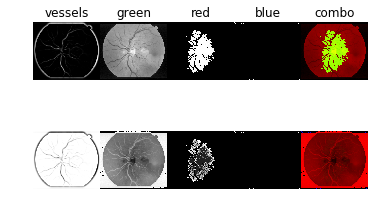



395: Starting on im0401, equalized, vessels mapped, colors mapped, combined and saved, 

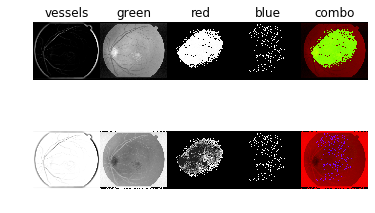



396: Starting on im0402, equalized, vessels mapped, colors mapped, combined and saved, 

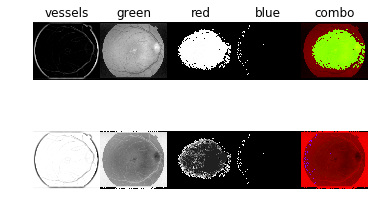

In [5]:
stare_proc.run_pipeline()

Checking output/fmaps/im0296.fmap
5


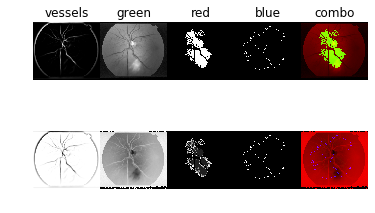

In [6]:
## ===== Loading processed featuremap file ==== 
DATA_DIR = "../../data/stare_fundus"
OUTPUTZ_DIR = "output/fmaps"
im = np.random.randint(0, stare_proc.dataset_size )
##TODO: template string fill in the zeroes
im = f'00{im}' if im < 10 else f'0{im}' if im < 100 else f'{im}' 
fpath = f"{OUTPUTZ_DIR}/im0{im}.fmap"

print(f"Checking {fpath}" )

fmap = stare_proc.open_fmap(fpath)
#print(fmap.shape)
print(len(fmap))

# 6. show progress imagez 
tx = ['vessels', 'green', 'red', 'blue', 'combo']
#x = [ fmap[:,:,i] for i in range(len(fmap)) ] #+ [ fmap[:,:,4:] ]  #len(fmap-2)
x = [ fmap[i] for i in range(len(fmap)) ]
AnImage.plot_images_list(x+[-i for i in x], 
                         titlez=tx, 
                         nc=len(x), 
                         cmap='gray', 
                         save=None)  